# Project 10: Chapter 8: Advanced Data Analysis
In the last few chapters, we have become comfortable with the idea of building our own functions. These can become quite complex, as we have learned with the construction of the OLS regression in chapter 7. We will continue developing our tool set for working with and managing large sets of data by integrating data from different data sets. We will introduce the multi index to facilitate this process. Among other things, the multi index is useful for including identifiers across time and region or principality. We will also use the multi index to perform a panel regression that controls for level effects between different countries.

## Using a Double Index to Work with Panel Data
In any project, it will not be uncommon for data to be attached to more than one indentifying category. Often, data will be labeled by polity and by date. In the next several examples, we will work with multiple data sets of this sort, working to combine different data sets, investigate the features of the double index, and use this data in a panel regression that can control for effects by polity and by time period.

### Plotting with Double Index
We will be working with two datasets in the next example: the [Fraser Economic Freedom Index](https://www.fraserinstitute.org/economic-freedom/dataset?geozone=world&page=dataset&min-year=2&max-year=0&filter=0&year=2017) and GDP from the [Maddison Project](https://www.rug.nl/ggdc/historicaldevelopment/maddison/releases/maddison-project-database-2018).

Due to the formatting of the Fraser Economic Freedom Index, the first column and the first three rows of data in the sheet titled “EFW Index 2018 Report” are blank. We will account for this when importing the data with pandas. Both should be saved in the same folder as the script below.

First, import the GDP data from Maddison Project:

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# import data from fraserdatawithrgdppc file created last project
# index_col = [0,2] will select  countrycode as the primary index and year as 
# the secondary index

data = pd.read_csv("fraserDataWithRGDPPC.csv", 
                     index_col = ["ISO_Code_3","Year"], 
                   parse_dates = True).rename(columns = {"Summary": "EFW"})
data

ISO_Code_2   World Bank Region  \
ISO_Code_3 Year                                        
AGO        1970-01-01         AO  Sub-Saharan Africa   
           1975-01-01         AO  Sub-Saharan Africa   
           1980-01-01         AO  Sub-Saharan Africa   
           1985-01-01         AO  Sub-Saharan Africa   
           1990-01-01         AO  Sub-Saharan Africa   
...                          ...                 ...   
ZWE        2016-01-01         ZW  Sub-Saharan Africa   
           2017-01-01         ZW  Sub-Saharan Africa   
           2018-01-01         ZW  Sub-Saharan Africa   
           2019-01-01         ZW  Sub-Saharan Africa   
           2020-01-01         ZW  Sub-Saharan Africa   

                      World Bank Current Income Classification, 1990-present (L=Low income, LM=Lower middle income, UM=Upper middle income, H=High income)  \
ISO_Code_3 Year                                                                                                                                              
AGO        1970-01-01                                                NaN                                                                                     
           1975-01-01                                                NaN                                                                                     
           1980-01-01                                                NaN                                                                                     
           1985-01-01                                                NaN                                                                                     
           1990-01-01                                                 LM                                                                                     
...                                                                  ...                                                                                     
ZWE        2016-01-01                                                  L                                                                                     
           2017-01-01                                                  L                                                                                     
           2018-01-01                                                 LM                                                                                     
           2019-01-01                                                 LM                                                                                     
           2020-01-01                                                 LM                                                                                     

                      Countries       EFW  Size of Government  \
ISO_Code_3 Year                                                 
AGO        1970-01-01    Angola       NaN                 NaN   
           1975-01-01    Angola       NaN                 NaN   
           1980-01-01    Angola       NaN                 NaN   
           1985-01-01    Angola       NaN                 NaN   
           1990-01-01    Angola       NaN                 NaN   
...                         ...       ...                 ...   
ZWE        2016-01-01  Zimbabwe  6.121996            5.332597   
           2017-01-01  Zimbabwe  5.599886            4.699843   
           2018-01-01  Zimbabwe  5.876298            5.170946   
           2019-01-01  Zimbabwe  4.719465            5.628359   
           2020-01-01  Zimbabwe  4.480000            5.562008   

                       Legal System and Property Rights  Sound Money  \
ISO_Code_3 Year                                                        
AGO        1970-01-01                               NaN          NaN   
           1975-01-01                               NaN          NaN   
           1980-01-01                               NaN          NaN   
           1985-01-01           

In [3]:
# format of data for our indexes
data.index[0]

('AGO', Timestamp('1970-01-01 00:00:00'))

In [4]:
# shows all unique country labels in the data
countries = data.index.get_level_values("ISO_Code_3").unique()
countries

Index(['AGO', 'ALB', 'ARE', 'ARG', 'ARM', 'AUS', 'AUT', 'AZE', 'BDI', 'BEL',
       ...
       'UGA', 'UKR', 'URY', 'USA', 'VEN', 'VNM', 'YEM', 'ZAF', 'ZMB', 'ZWE'],
      dtype='object', name='ISO_Code_3', length=165)

In [5]:
# shows all unique years included in the data. Every 5 years for old data
# note this will skew data towards new data
years = data.index.get_level_values("Year").unique()
years

DatetimeIndex(['1970-01-01', '1975-01-01', '1980-01-01', '1985-01-01',
               '1990-01-01', '1995-01-01', '2000-01-01', '2001-01-01',
               '2002-01-01', '2003-01-01', '2004-01-01', '2005-01-01',
               '2006-01-01', '2007-01-01', '2008-01-01', '2009-01-01',
               '2010-01-01', '2011-01-01', '2012-01-01', '2013-01-01',
               '2014-01-01', '2015-01-01', '2016-01-01', '2017-01-01',
               '2018-01-01', '2019-01-01', '2020-01-01'],
              dtype='datetime64[ns]', name='Year', freq=None)

In [6]:
# this is a function to make an indicator variable based on a yes or no 
# scenario. If yes it will mark 1

def create_indicator_variable(data, indicator_name,
                             index_name, target_index_list):
    
    data[indicator_name] = 0
    data[indicator_name][data.index.get_level_values(
        index_name).isin(target_index_list)]=1
    
index_name = data.index.names[0]
indicator_name = "North America"
countries_in_north_america = [
    "BHS", "BRB", "BLZ", "CAN", "CRI", "DOM", "SLV",
    "GTM", "HTI", "HND", "JAM", "MEX", "NIC", "PAN",
    "TTO", "USA"]  
create_indicator_variable(data = data,
                         indicator_name = indicator_name,
                         index_name = index_name,
                          target_index_list = countries_in_north_america)
data.loc["USA"]

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2385054565.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[indicator_name][data.index.get_level_values(


,ISO_Code_2,World Bank Region,"World Bank Current Income Classification, 1990-present (L=Low income, LM=Lower middle income, UM=Upper middle income, H=High income)",Countries,EFW,Size of Government,Legal System and Property Rights,Sound Money,Freedom to Trade Internationally,Regulation,Standard Deviation of the 5 EFW Areas,RGDP Per Capita,North America
Year,,,,,,,,,,,,,
1970-01-01,US,North America,NaN,United States,7.615181,5.341231,8.286741,9.588817,8.232334,6.631262,1.648185,23958.0000,1
1975-01-01,US,North America,NaN,United States,7.907324,5.336851,8.670280,9.067438,8.412407,8.042706,1.483975,25956.0000,1
1980-01-01,US,North America,NaN,United States,8.101368,5.788734,8.684269,9.122306,8.544966,8.359863,1.322304,29611.0000,1
1985-01-01,US,North America,NaN,United States,8.295413,6.582616,8.726823,9.339660,8.505198,8.335644,1.031484,33023.0000,1
1990-01-01,US,North America,H,United States,8.461126,7.262163,8.350956,9.669842,8.537828,8.477998,0.853932,36982.0000,1
1995-01-01,US,North America,H,United States,8.588435,7.446569,8.587870,9.787931,8.594211,8.538840,0.828418,39390.6254,1
2000-01-01,US,North America,H,United States,8.648077,7.704726,8.773170,9.607665,8.466601,8.739485,0.683215,45886.4705,1
2001-01-01,US,North America,H,United States,8.509072,7.521319,8.615158,9.612028,8.397002,8.464019,0.744511,45878.0092,1
2002-01-01,US,North America,H,United States,8.568646,7.673536,8.370127,9.724310,8.298912,8.819880,0.760212,46266.2959,1


# Plotting Indicator Variables in Scatter

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1612594606.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize = (20,12))


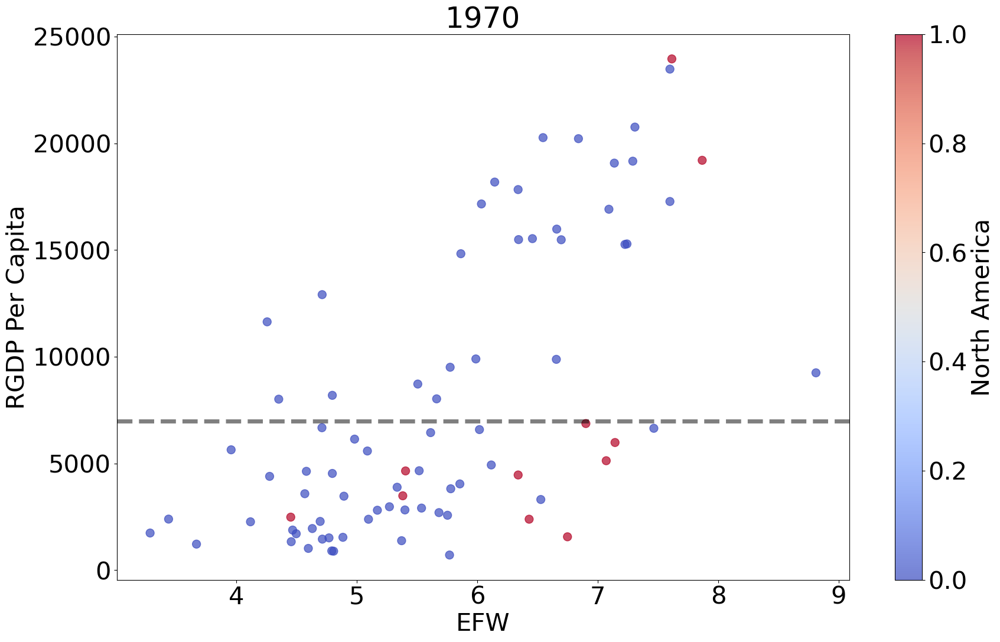

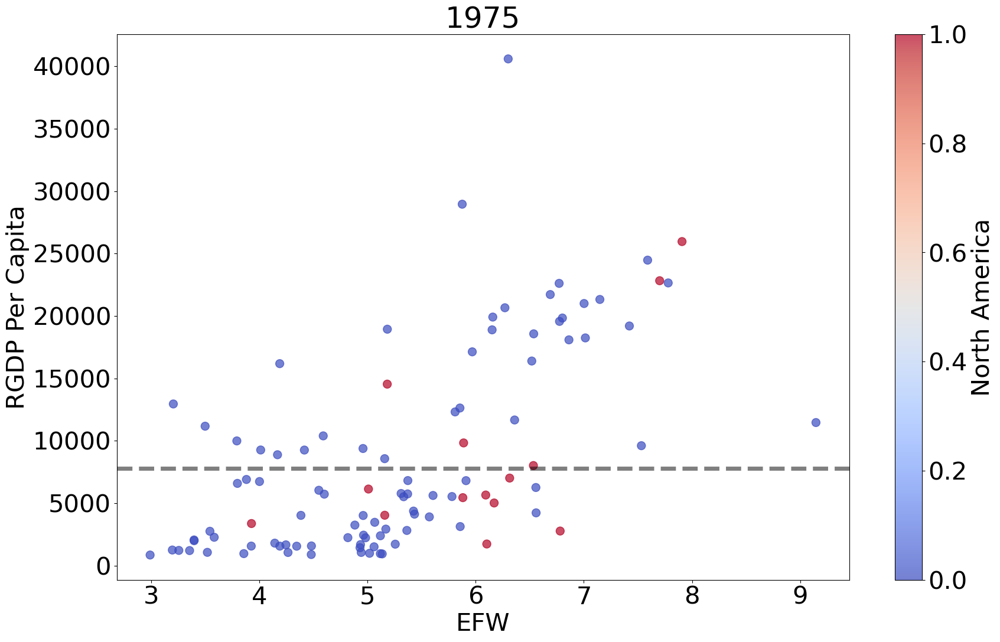

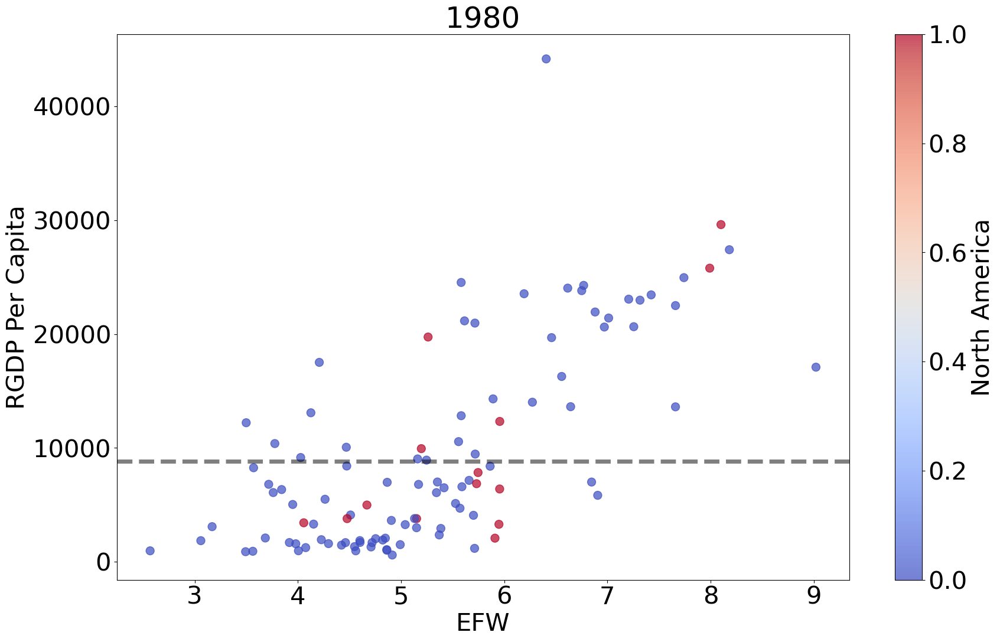

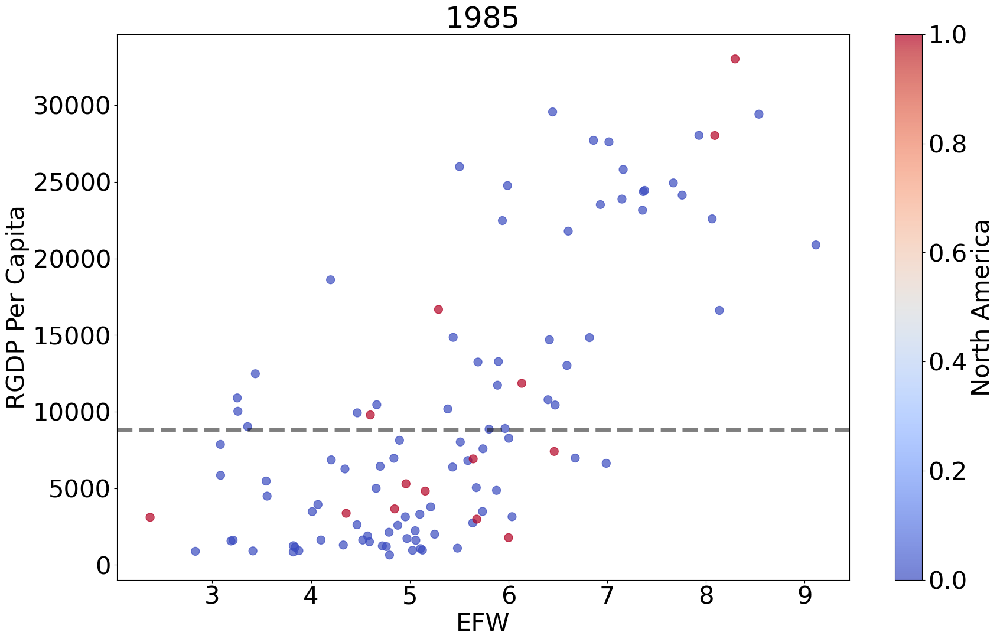

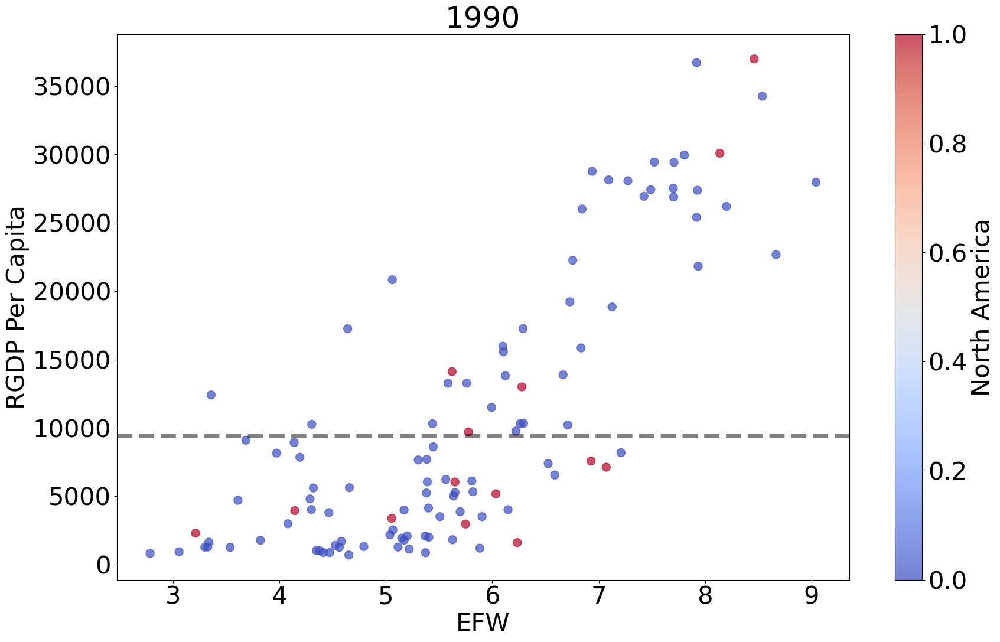

...

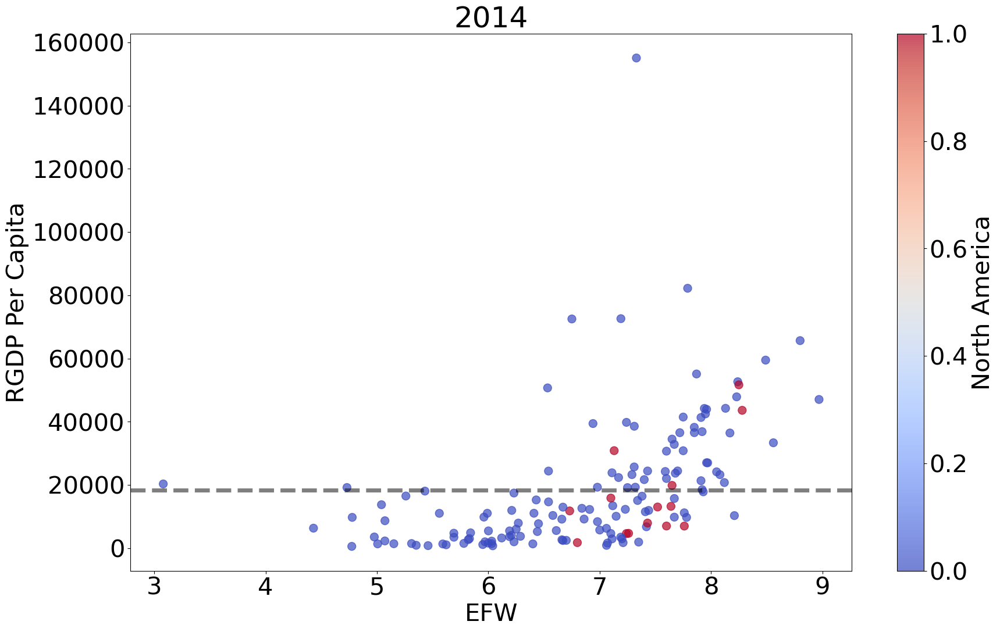

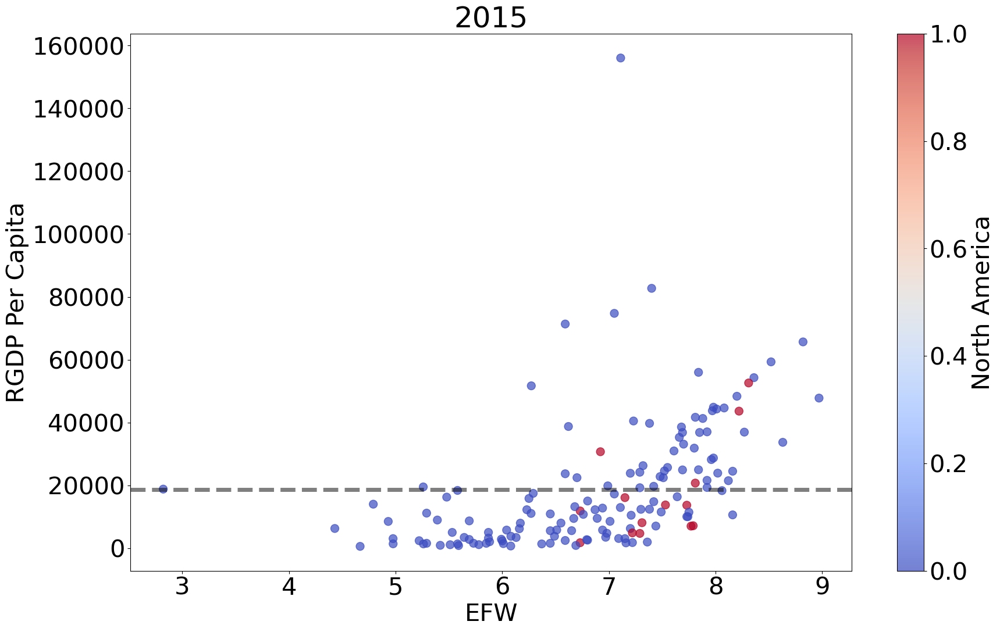

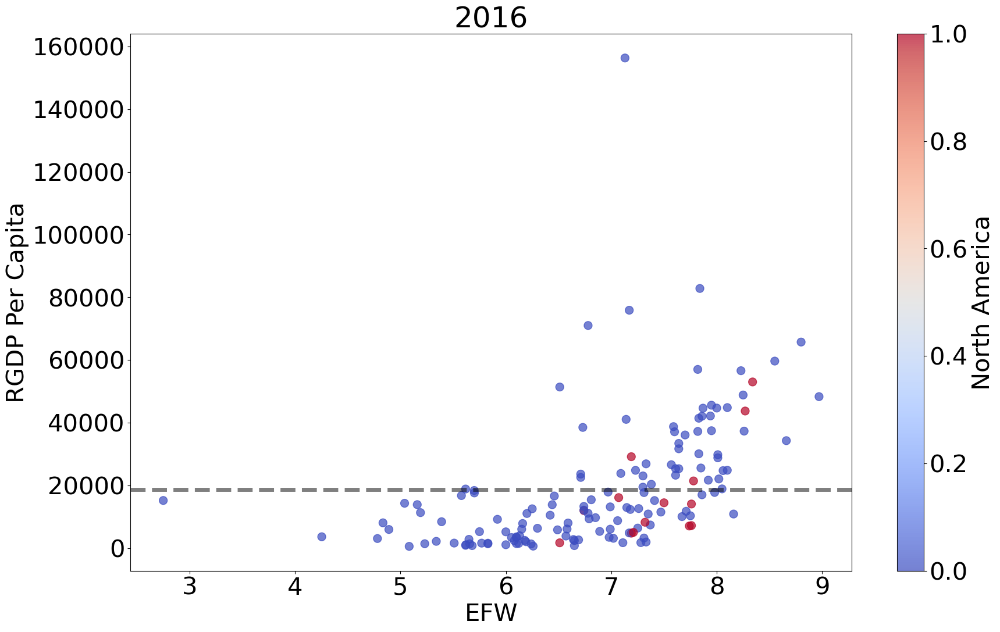

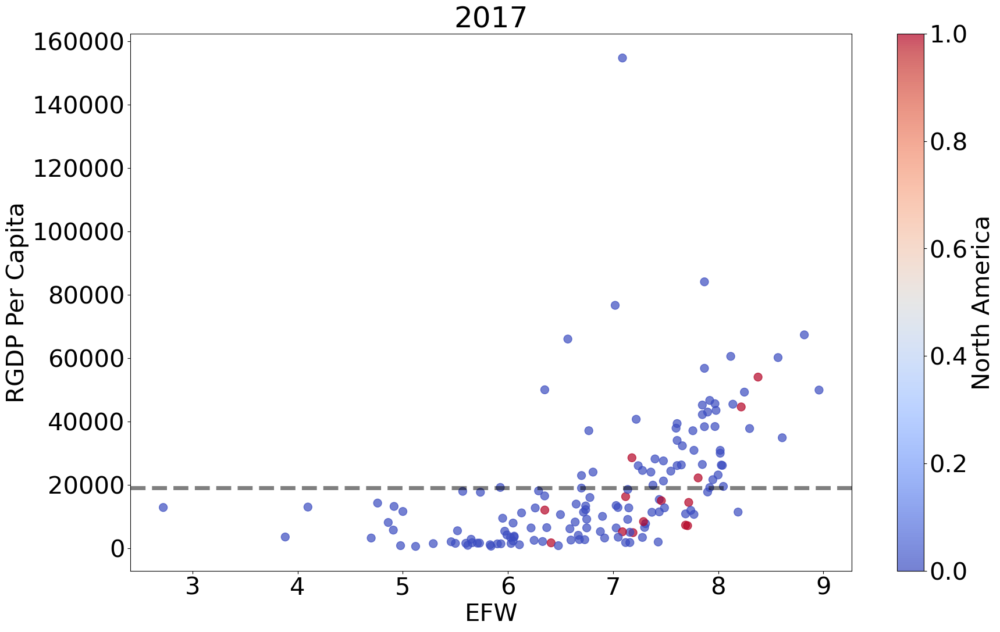

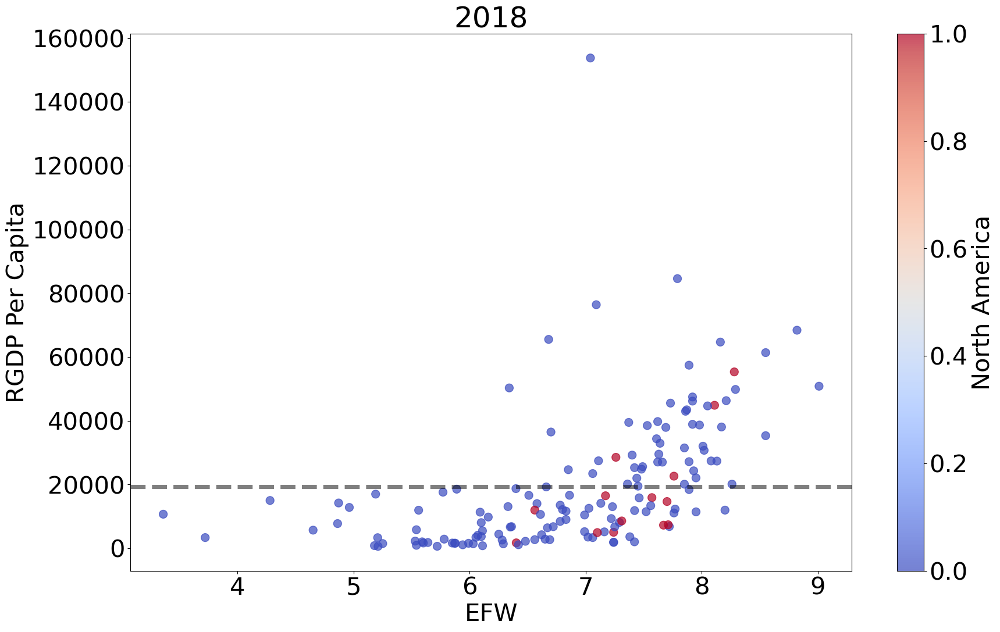

In [7]:
# not logged difference data for RGDP Per Capita since I am using Project 10.
# 


plt.rcParams.update({"font.size":30})
years = data.dropna(subset = ["RGDP Per Capita"]).index.get_level_values("Year").unique()
for year in years:

    plot_data = data[data.index.get_level_values("Year") == year]
    fig, ax = plt.subplots(figsize = (20,12))
    plot_data.plot.scatter(x = "EFW",
                          y = "RGDP Per Capita",
                          c = "North America",
                          cmap = "coolwarm", 
                           s = 100,
                          alpha = .7,
                          ax = ax)

    ax.set_title(str(year)[:4])
    # mean RGDP Per Capita shown below with line
    ax.axhline(plot_data["RGDP Per Capita"].mean(), ls = "--", color = "k", alpha = .5, linewidth = 5)

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2441601793.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize = (20,12))


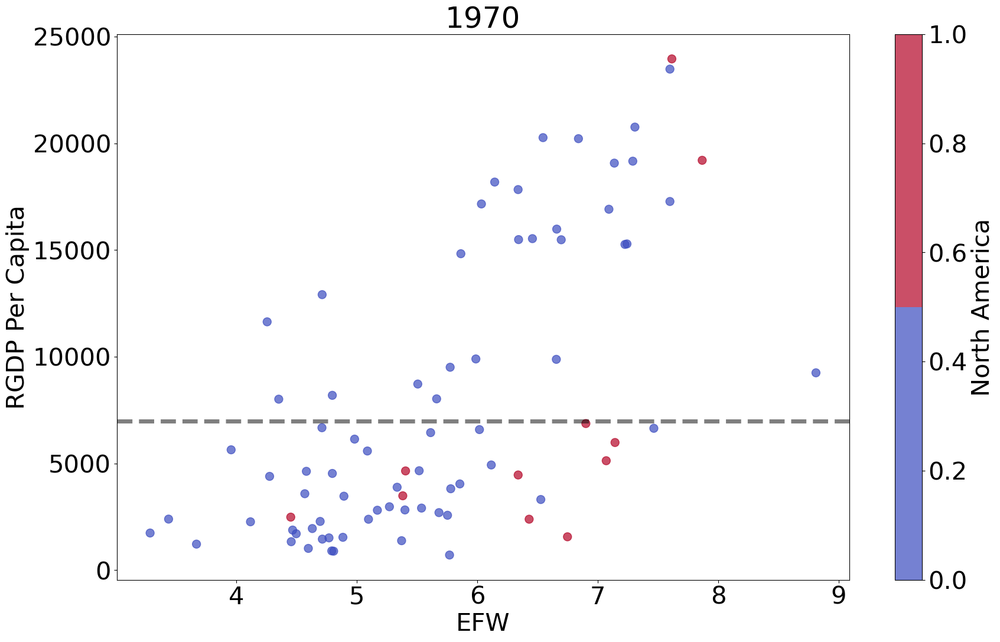

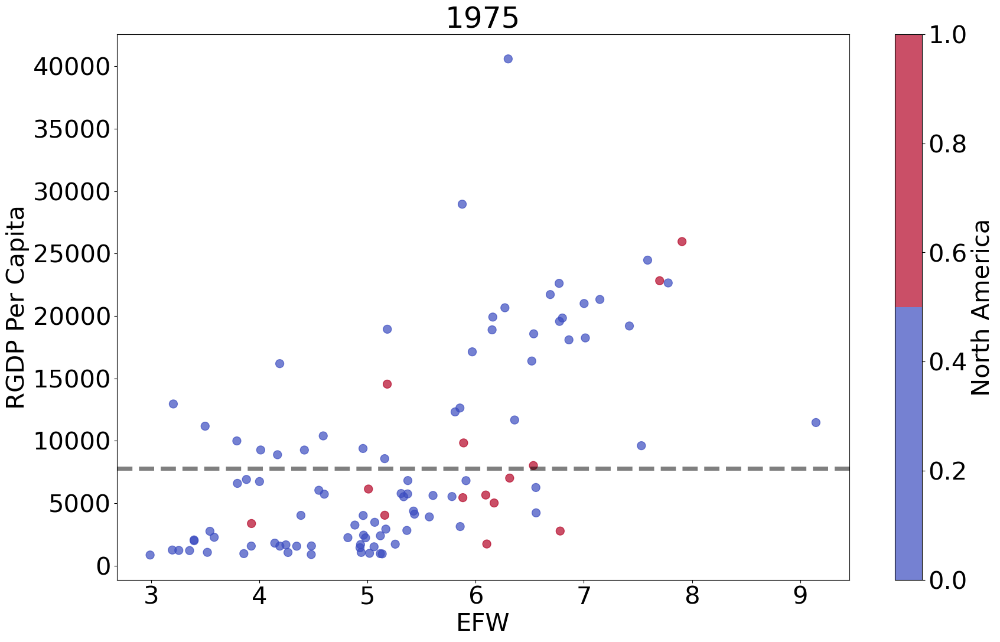

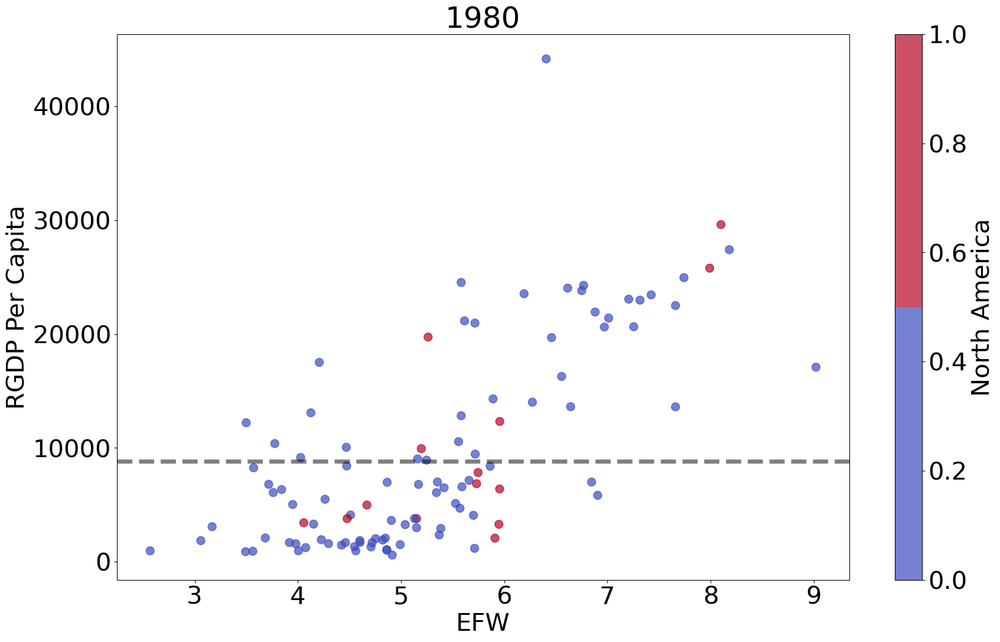

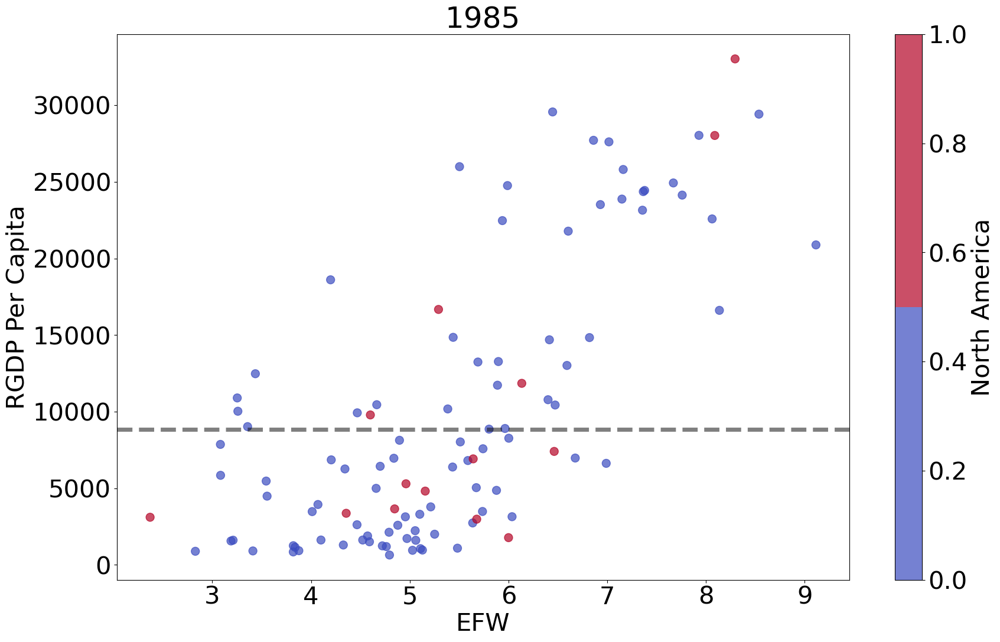

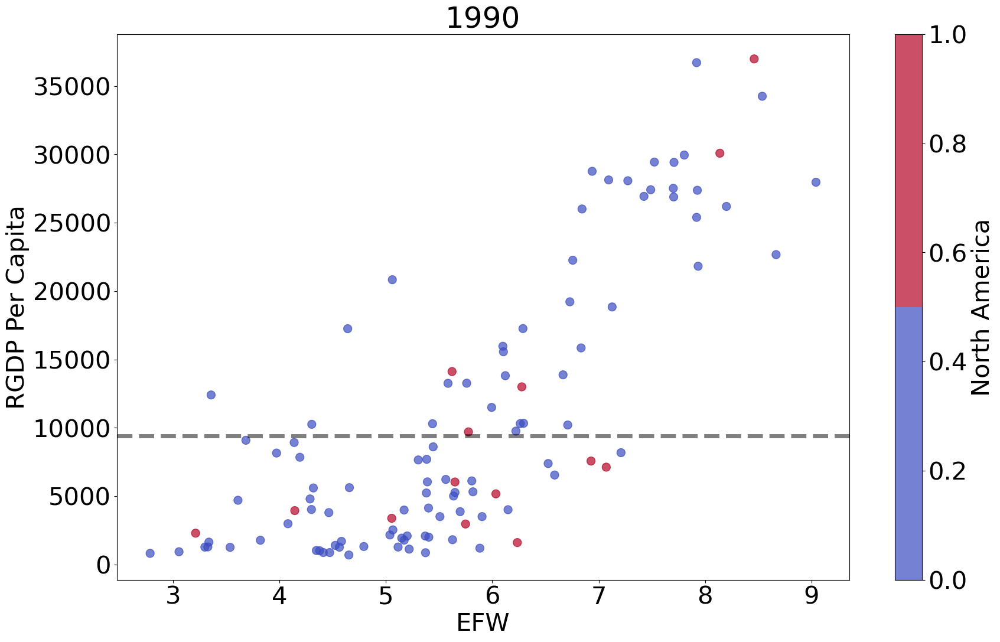

...

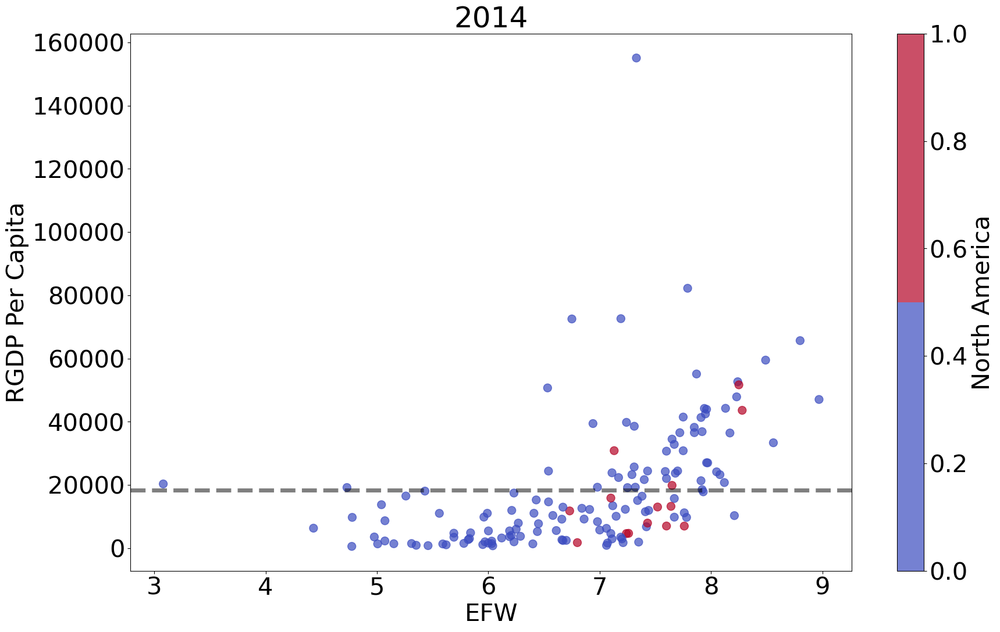

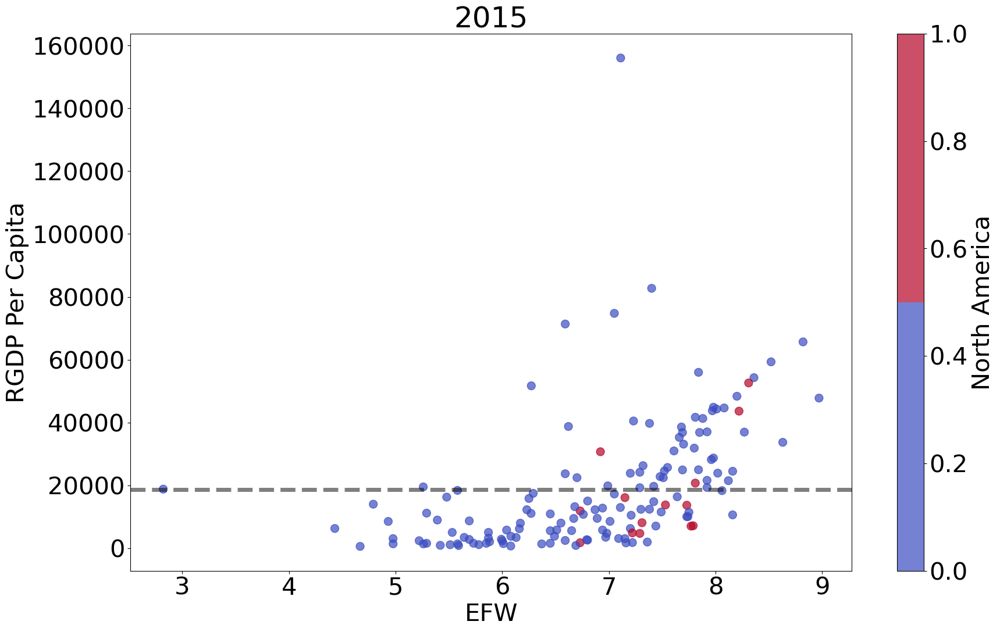

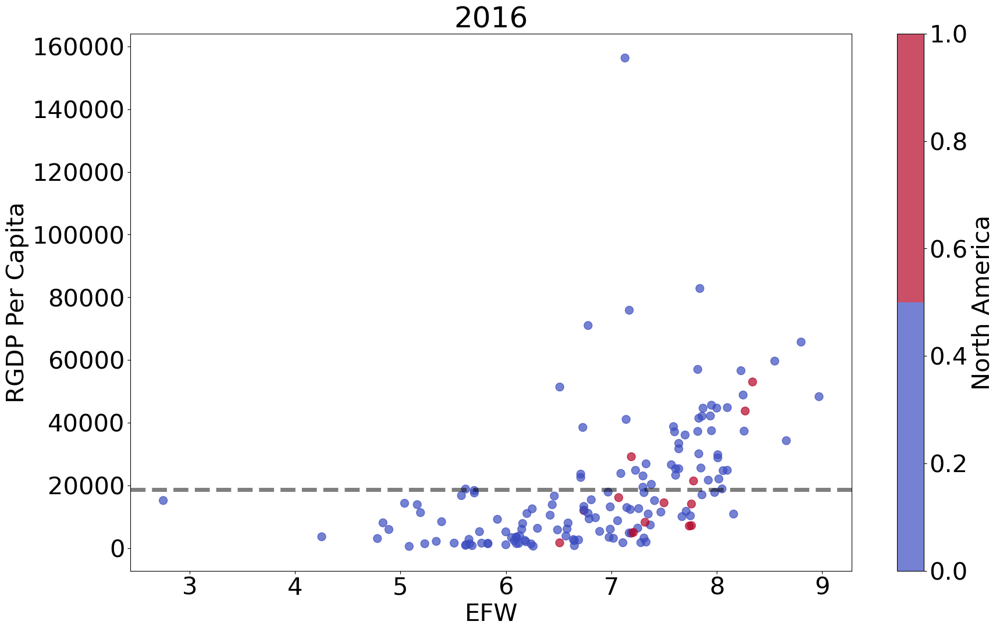

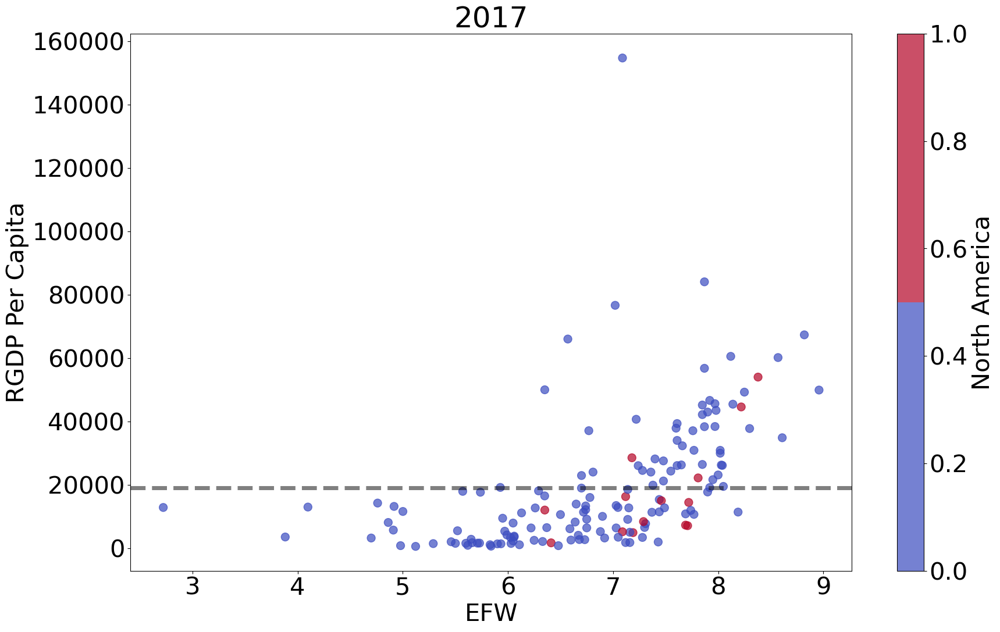

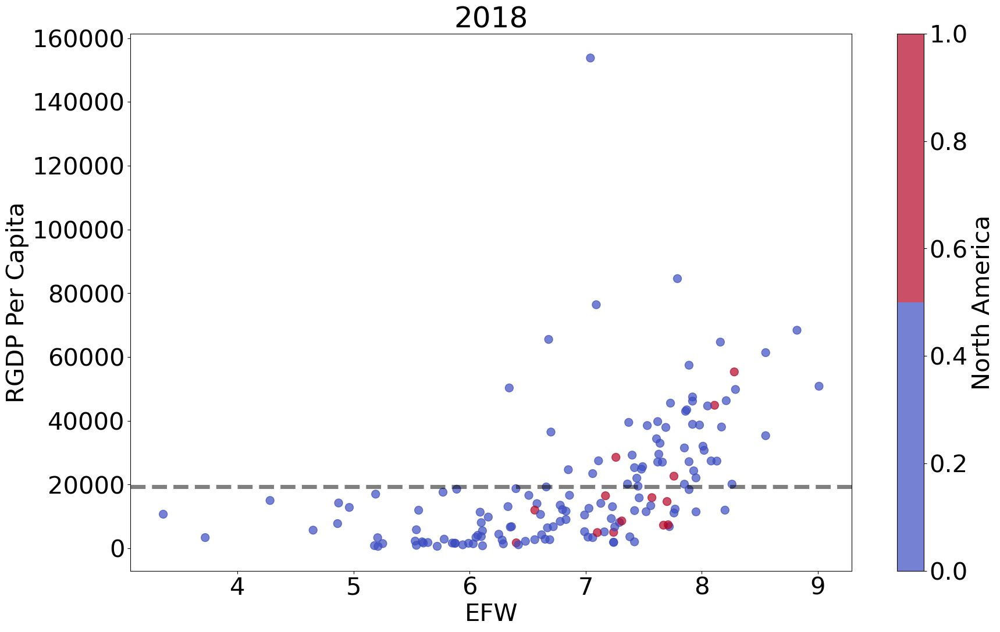

In [8]:
from matplotlib import cm
plt.rcParams.update({"font.size":30})
years = data.dropna(subset = ["RGDP Per Capita"]).index.get_level_values("Year").unique()

# this allows us to normalize the colors and define the color map as coolwarm, 
# but the 2 allows us to determine that 2 colors are used for the 
# difining of the right color bar, and ultimately datapoint colors
norm = cm.colors.Normalize()
cmap = cm.get_cmap('coolwarm', 2)

for year in years:

    plot_data = data[data.index.get_level_values("Year") == year]
    fig, ax = plt.subplots(figsize = (20,12))
    plot_data.plot.scatter(x = "EFW",
                          y = "RGDP Per Capita",
                          c = "North America",
                          cmap = cmap, 
                           s = 100,
                          alpha = .7,
                          ax = ax)

    ax.set_title(str(year)[:4])
    # mean RGDP Per Capita shown below with line
    ax.axhline(plot_data["RGDP Per Capita"].mean(), ls = "--", color = "k", alpha = .5, linewidth = 5)


In [9]:
# quantile function simple
n = 5
quantile_var = "RGDP Per Capita"
quantile_name = quantile_var + " " + str(n) + "-tile"
data[quantile_name] = np.nan


In [10]:
# here we create a quantile function that finds the quantile of our given
# data and given the number of bins and variable name. Below is displaying
# the quantile wealth of countries with 5 bins
# 



# this is not indexed by Growth rate like our in-class project since I am using
# raw number data.

def create_quantile(n,
                   data,
                   year,
                   quantile_var,
                   quantile_name):
    # index that is identifies countries for a given year
    year_index = data.index.get_level_values("Year") == year
    quantile_values_dict = {
        i:data[year_index][quantile_var].quantile(i/n) for i in range(1, n+1)}
    for index in data[year_index].index:
        # identify value of the variable of interest
        val = data.loc[index][quantile_var]
        # cycle through data to check if it's less than each value and
        # bin accordingly using above 
        for i in range(1, n+1):
            if val <= quantile_values_dict[i]:
                data.loc[index,[quantile_name]] = int((n+1) - i)
                break
        else:
            continue

years = data.groupby("Year").mean().index            
for year in years:            
    create_quantile(n, data, year, quantile_var, quantile_name)
data

ISO_Code_2   World Bank Region  \
ISO_Code_3 Year                                        
AGO        1970-01-01         AO  Sub-Saharan Africa   
           1975-01-01         AO  Sub-Saharan Africa   
           1980-01-01         AO  Sub-Saharan Africa   
           1985-01-01         AO  Sub-Saharan Africa   
           1990-01-01         AO  Sub-Saharan Africa   
...                          ...                 ...   
ZWE        2016-01-01         ZW  Sub-Saharan Africa   
           2017-01-01         ZW  Sub-Saharan Africa   
           2018-01-01         ZW  Sub-Saharan Africa   
           2019-01-01         ZW  Sub-Saharan Africa   
           2020-01-01         ZW  Sub-Saharan Africa   

                      World Bank Current Income Classification, 1990-present (L=Low income, LM=Lower middle income, UM=Upper middle income, H=High income)  \
ISO_Code_3 Year                                                                                                                                              
AGO        1970-01-01                                                NaN                                                                                     
           1975-01-01                                                NaN                                                                                     
           1980-01-01                                                NaN                                                                                     
           1985-01-01                                                NaN                                                                                     
           1990-01-01                                                 LM                                                                                     
...                                                                  ...                                                                                     
ZWE        2016-01-01                                                  L                                                                                     
           2017-01-01                                                  L                                                                                     
           2018-01-01                                                 LM                                                                                     
           2019-01-01                                                 LM                                                                                     
           2020-01-01                                                 LM                                                                                     

                      Countries       EFW  Size of Government  \
ISO_Code_3 Year                                                 
AGO        1970-01-01    Angola       NaN                 NaN   
           1975-01-01    Angola       NaN                 NaN   
           1980-01-01    Angola       NaN                 NaN   
           1985-01-01    Angola       NaN                 NaN   
           1990-01-01    Angola       NaN                 NaN   
...                         ...       ...                 ...   
ZWE        2016-01-01  Zimbabwe  6.121996            5.332597   
           2017-01-01  Zimbabwe  5.599886            4.699843   
           2018-01-01  Zimbabwe  5.876298            5.170946   
           2019-01-01  Zimbabwe  4.719465            5.628359   
           2020-01-01  Zimbabwe  4.480000            5.562008   

                       Legal System and Property Rights  Sound Money  \
ISO_Code_3 Year                                                        
AGO        1970-01-01                               NaN          NaN   
           1975-01-01                               NaN          NaN   
           1980-01-01                               NaN          NaN   
           1985-01-01           

<AxesSubplot:xlabel='EFW', ylabel='RGDP Per Capita'>

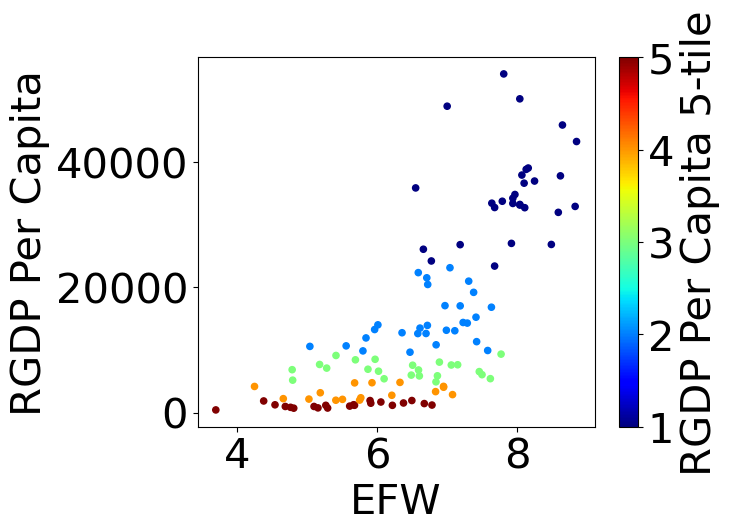

In [11]:
# here we will graph the RGDP Per capita with EFW in a heat map style
# scatter plot

year = "2000"
plot_data = data[data.index.get_level_values("Year") == year]
plot_data.plot.scatter(x = "EFW",
                      y = "RGDP Per Capita",
                      c = "RGDP Per Capita " + str(n) + "-tile",
                      cmap = "jet")

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\817505910.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize = (24,16))


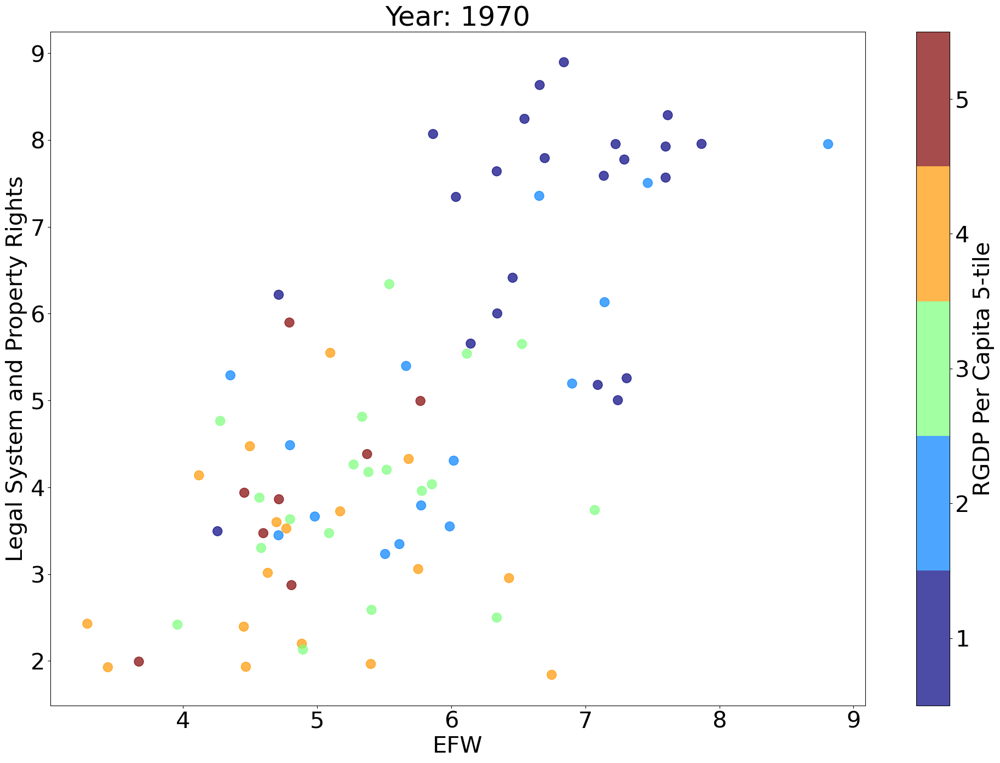

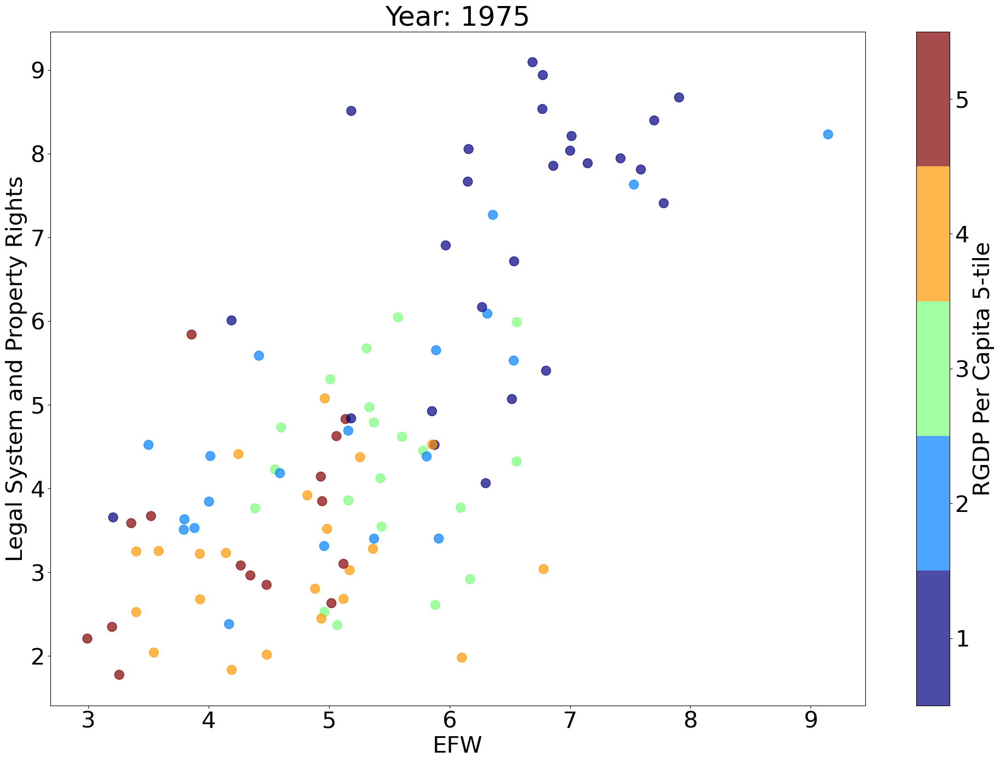

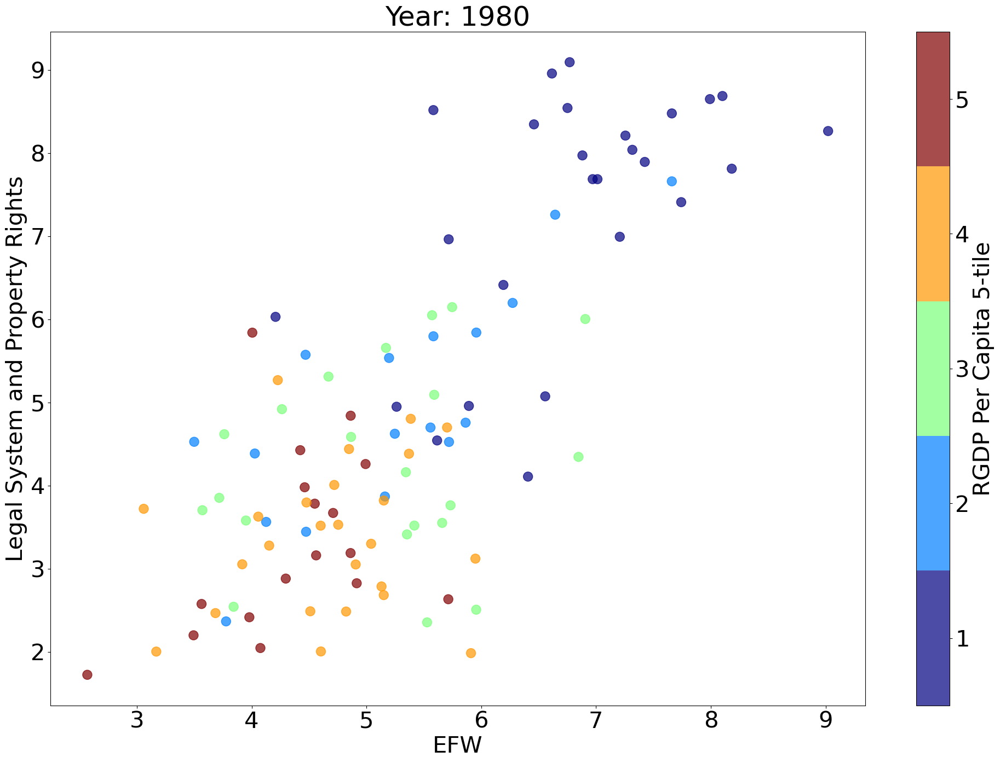

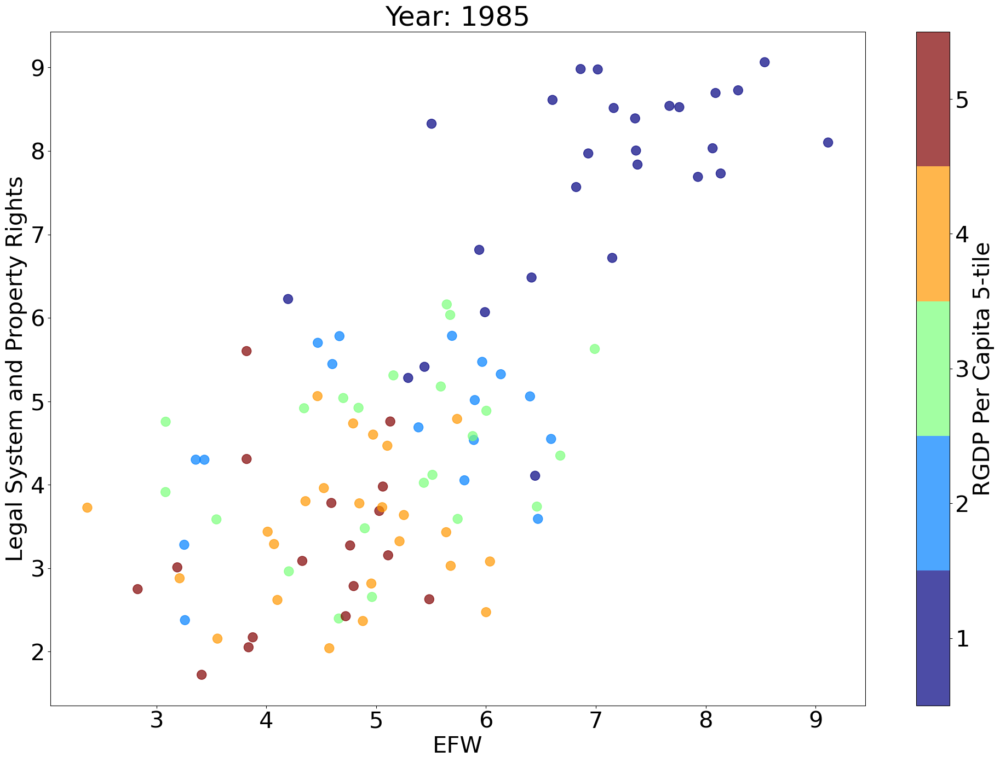

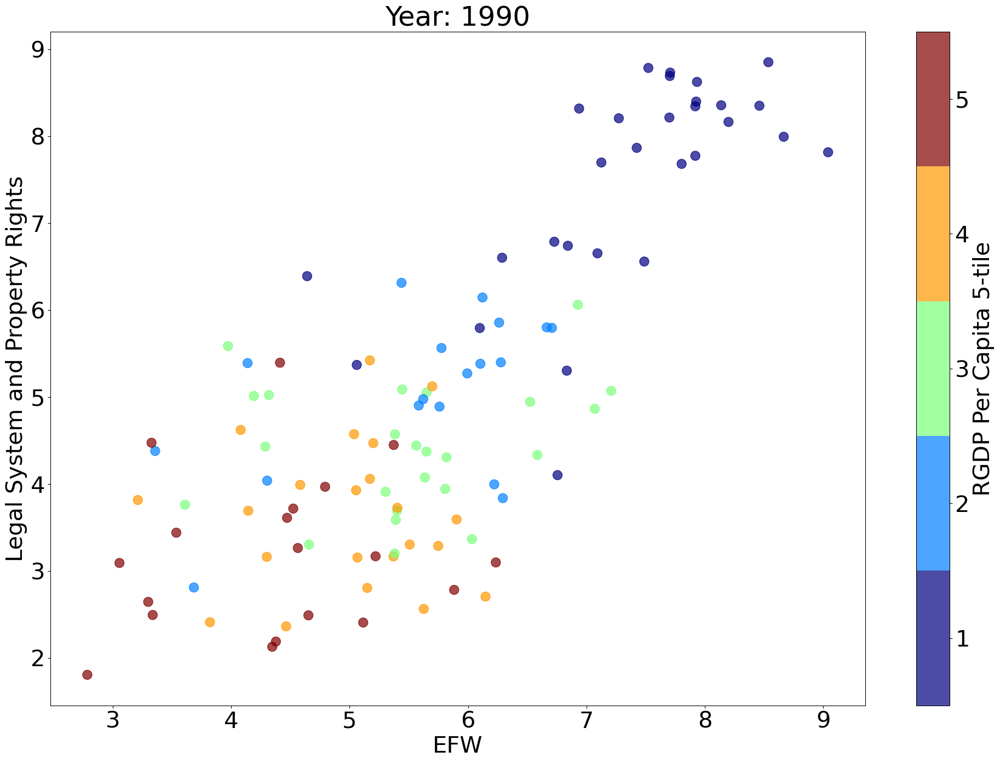

...

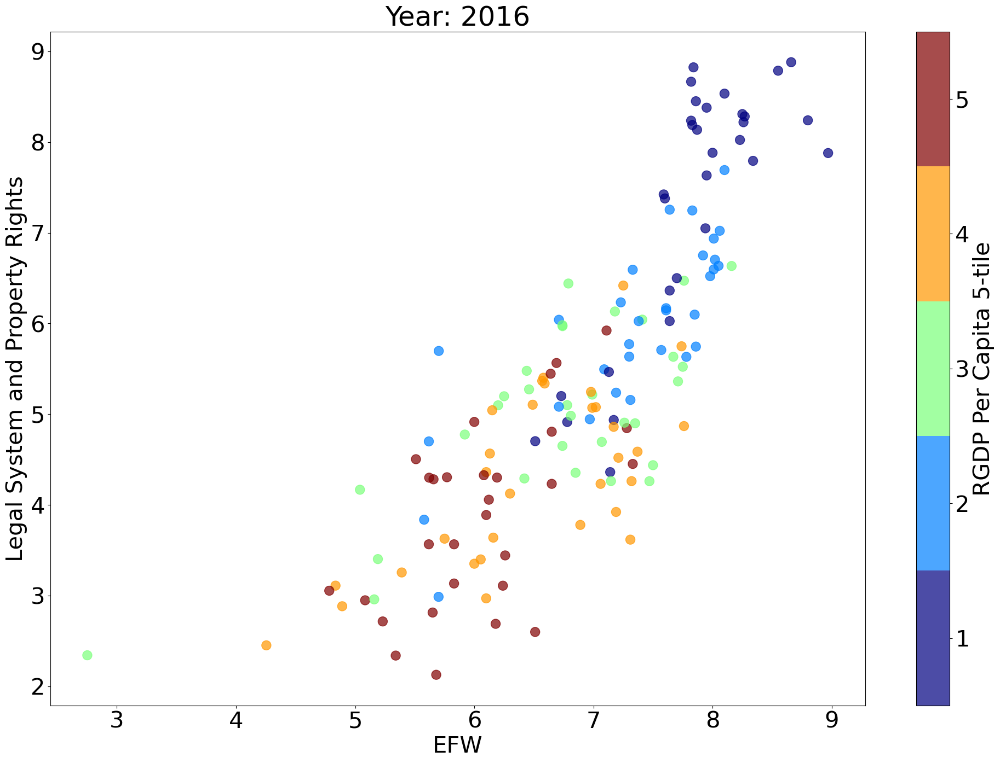

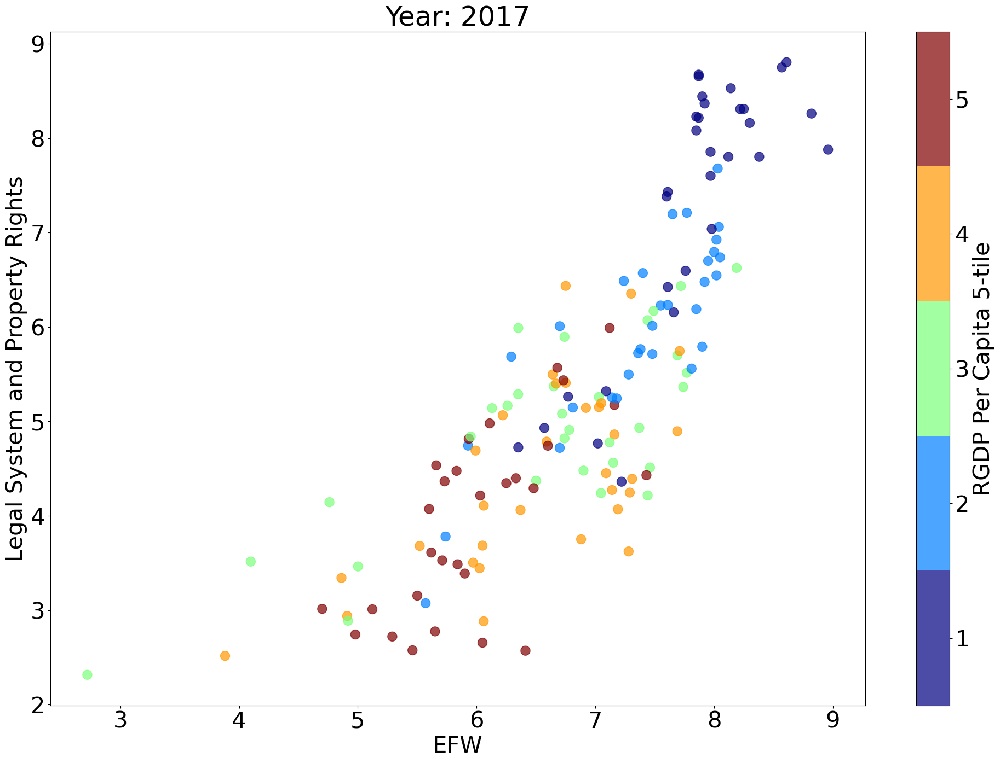

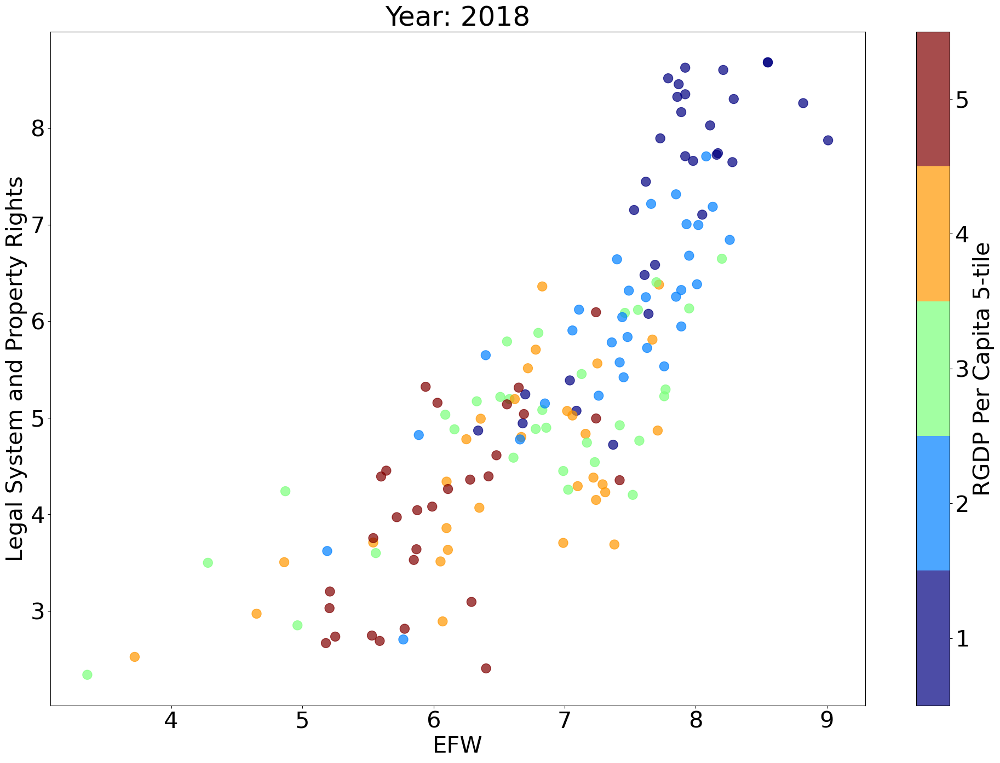

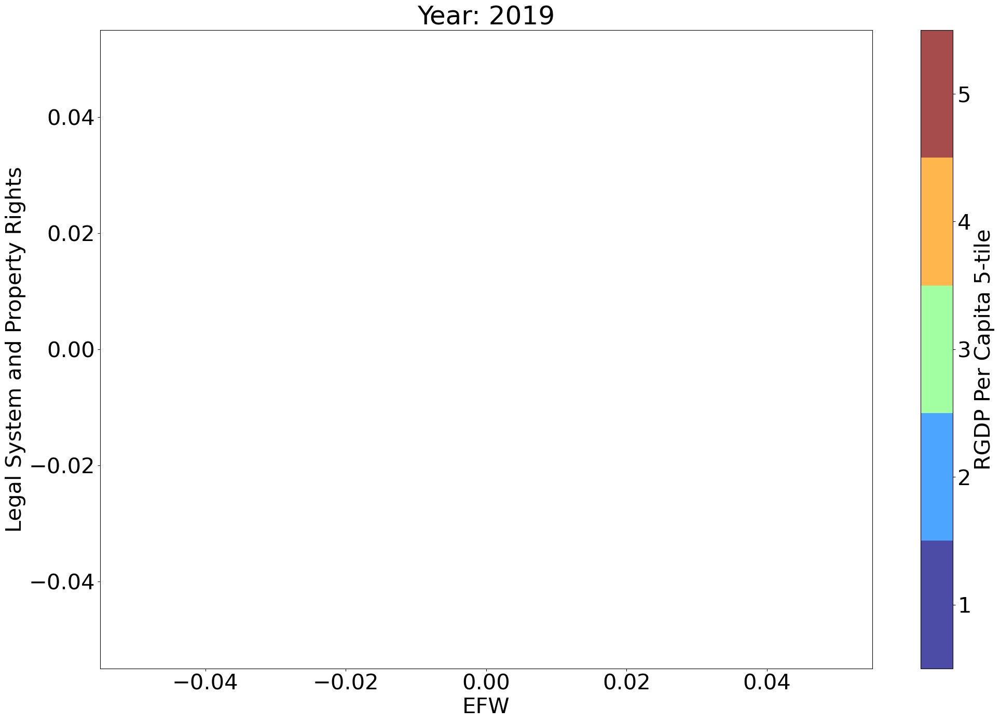

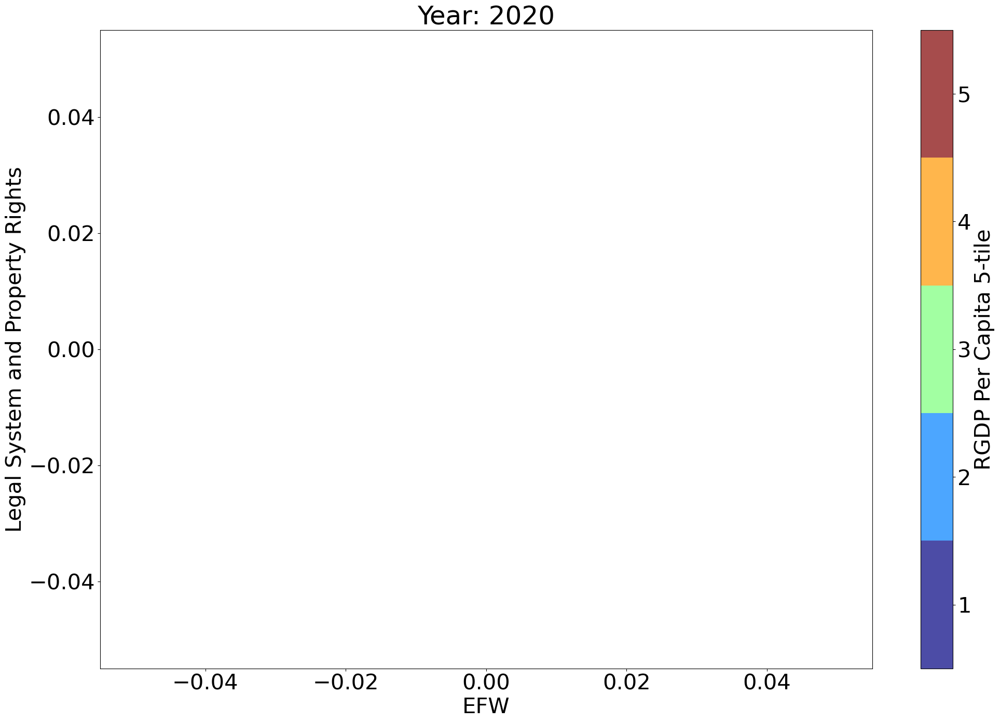

In [12]:
# take above and transition into a quick auto-graphing

# generate cmap with 5 bins for color purposes
cmap = cm.get_cmap("jet", n)
# use for loop to graph each year
for year in years:
    # select data for a given year
    plot_data = data[data.index.get_level_values("Year") == year]
    fig, ax = plt.subplots(figsize = (24,16))
    # set x, y, and color by variable.
    plot_data.plot.scatter(x = "EFW",
                          y = "Legal System and Property Rights",
                          c = "RGDP Per Capita " + str(n) + "-tile",
                          cmap = cmap,
                          ax = ax,
                          s = 150,
                           # we can use vmin & vmax to put numbers in the center
                           # of the color bar
                           vmin = .5, 
                           vmax = 5.5,
                          alpha = .7)
    
    # set title to be the first 4 numbers in the "Year" attribute
    ax.set_title("Year: " + str(year)[:4])

In [13]:
data[data["North America"]==1].index.get_level_values("ISO_Code_3").unique()

Index(['BHS', 'BLZ', 'BRB', 'CAN', 'CRI', 'DOM', 'GTM', 'HND', 'HTI', 'JAM',
       'MEX', 'NIC', 'PAN', 'SLV', 'TTO', 'USA'],
      dtype='object', name='ISO_Code_3')

In [14]:
import statsmodels.api as sm


In [15]:
# build a regression function to be used later

def regress(data, x_names, y_name, constant = False):
    X = data[x_names]
    if constant:
        X["constant"] = 1
    y = data[y_name]
    results = sm.OLS(y,X).fit()
    return results

y_name = ["EFW"]
X_names = ["RGDP Per Capita"]
reg_data = data.dropna()



results = regress(reg_data, X_names, y_name, constant = False)
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                    EFW   R-squared (uncentered):                   0.558
Model:                            OLS   Adj. R-squared (uncentered):              0.557
Method:                 Least Squares   F-statistic:                              3537.
Date:                Tue, 25 Apr 2023   Prob (F-statistic):                        0.00
Time:                        10:20:15   Log-Likelihood:                         -8234.8
No. Observations:                2808   AIC:                                  1.647e+04
Df Residuals:                    2807   BIC:                                  1.648e+04
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
RGDP Per Capita     0.0002   3.49e-06     59.474      0.000       0.000       0.000
==============================================================================
Omnibus:                     1991.287   Durbin-Watson:                   0.064
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            45672.226
Skew:                          -3.085   Prob(JB):                         0.00
Kurtosis:                      21.769   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3266246983.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Residuals"] = results.resid
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3266246983.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()


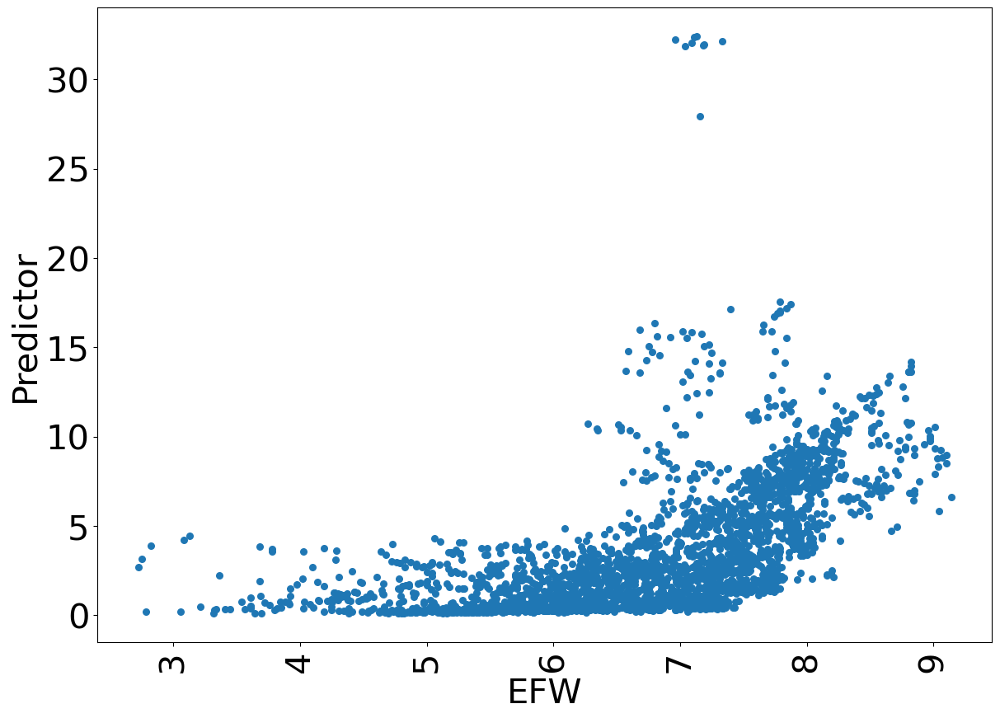

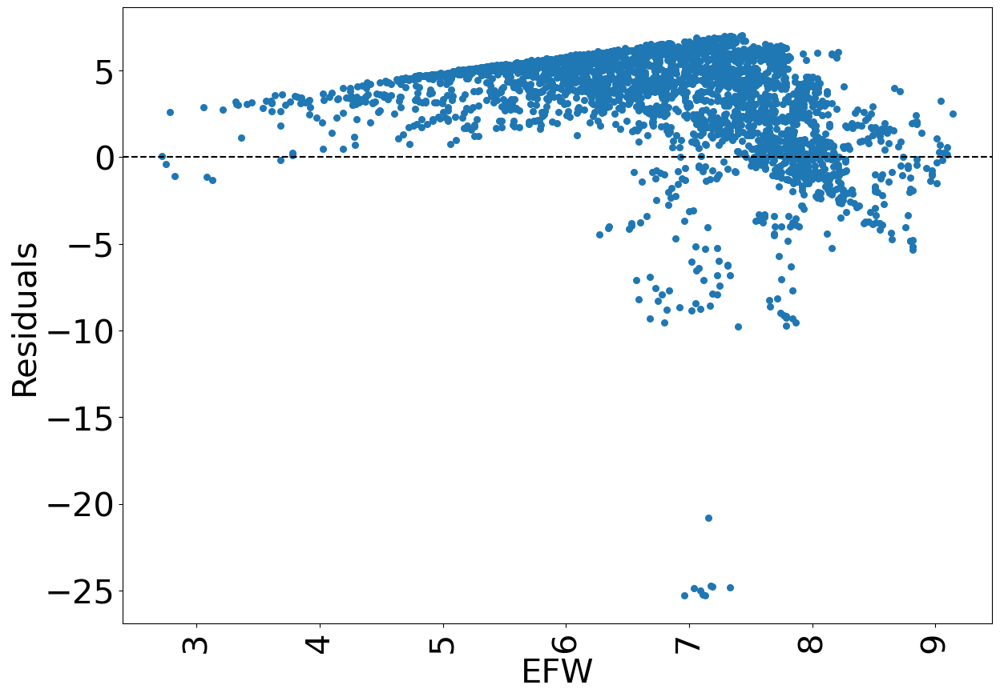

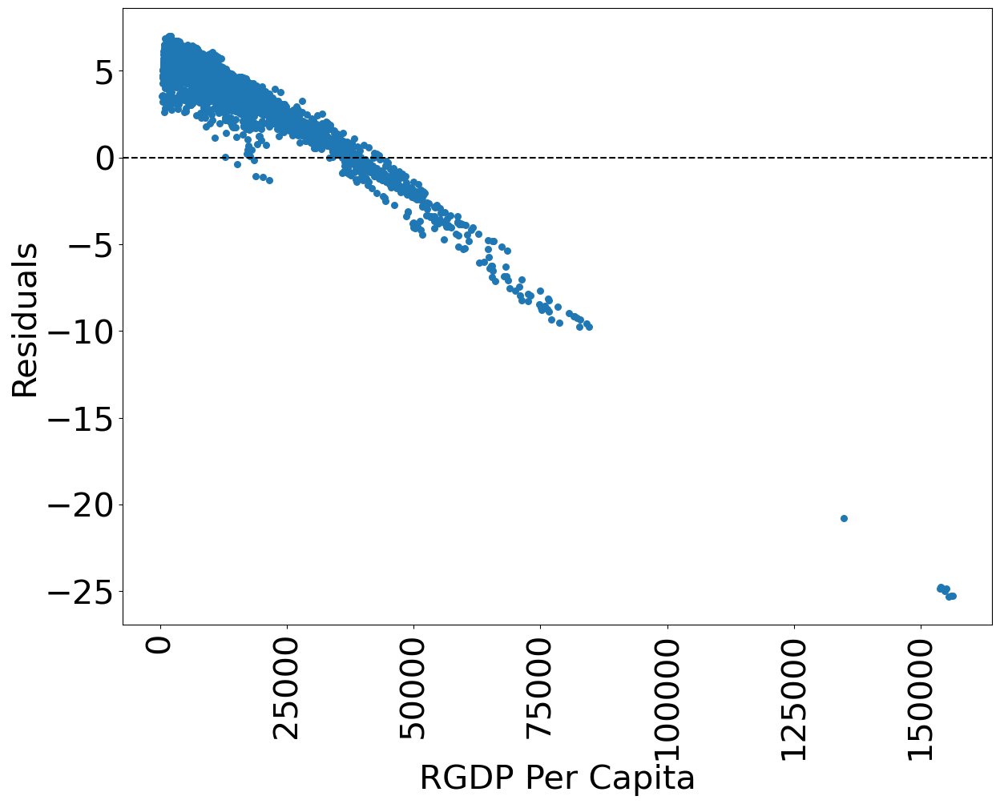

In [16]:
def plot_residuals(df, y_var, x_vars):
    fig, ax = plt.subplots(figsize = (14, 10))
    df.plot.scatter(x = y_var[0],
                     y = "Predictor", 
                      s = 30, ax = ax)
    plt.xticks(rotation=90)
    plt.show()
    plt.close()

    # cycle through all variables included in regression
    #   concatenate y_var and x_vars to form a single list
    for var in y_var + x_vars:
        fig, ax = plt.subplots(figsize = (14,10))
        df.plot.scatter(x = var,
                         y = "Residuals", 
                          s = 30, ax = ax)
        ax.axhline(0, ls = "--", color = "k")
        plt.xticks(rotation=90)
        plt.show()
        plt.close()
        
reg_data["Residuals"] = results.resid
reg_data["Predictor"] = results.predict()
plot_residuals(reg_data,y_name,X_names)

In [17]:
X_names = ["RGDP Per Capita 5-tile"]
results = regress(reg_data, 
                  X_names, y_name, 
                  constant = False)
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                    EFW   R-squared (uncentered):                   0.711
Model:                            OLS   Adj. R-squared (uncentered):              0.710
Method:                 Least Squares   F-statistic:                              6891.
Date:                Tue, 25 Apr 2023   Prob (F-statistic):                        0.00
Time:                        10:20:16   Log-Likelihood:                         -7638.9
No. Observations:                2808   AIC:                                  1.528e+04
Df Residuals:                    2807   BIC:                                  1.529e+04
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
RGDP Per Capita 5-tile     1.7890      0.022     83.014      0.000       1.747       1.831
==============================================================================
Omnibus:                     1660.143   Durbin-Watson:                   0.101
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              159.676
Skew:                          -0.076   Prob(JB):                     2.12e-35
Kurtosis:                       1.842   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1563181432.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1563181432.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Residuals"] = results.resid


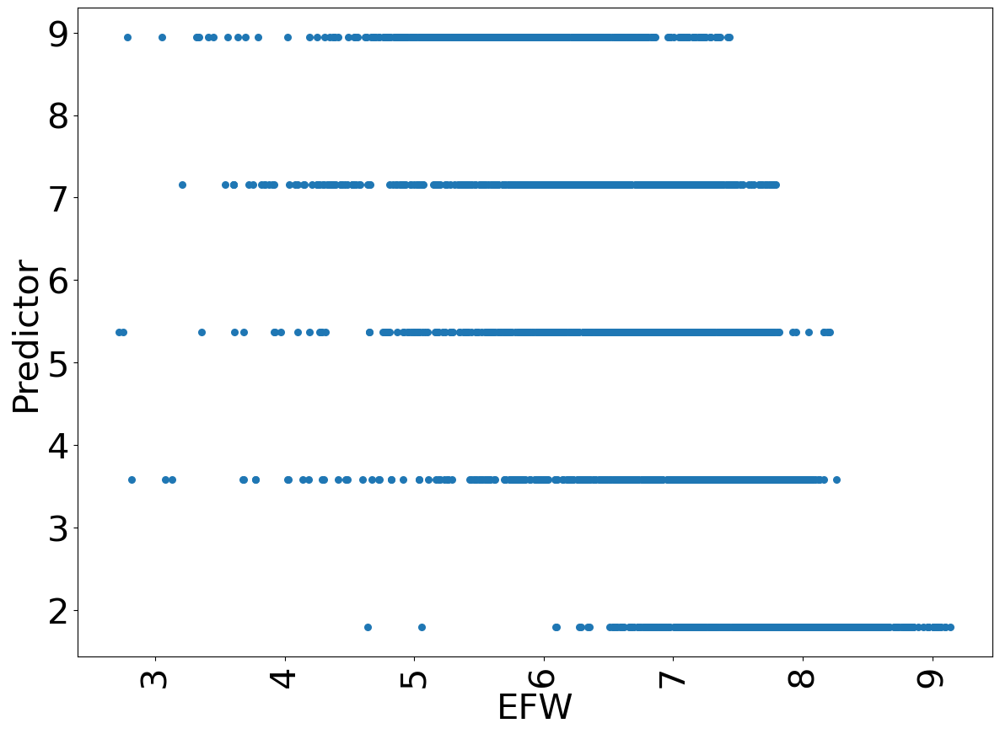

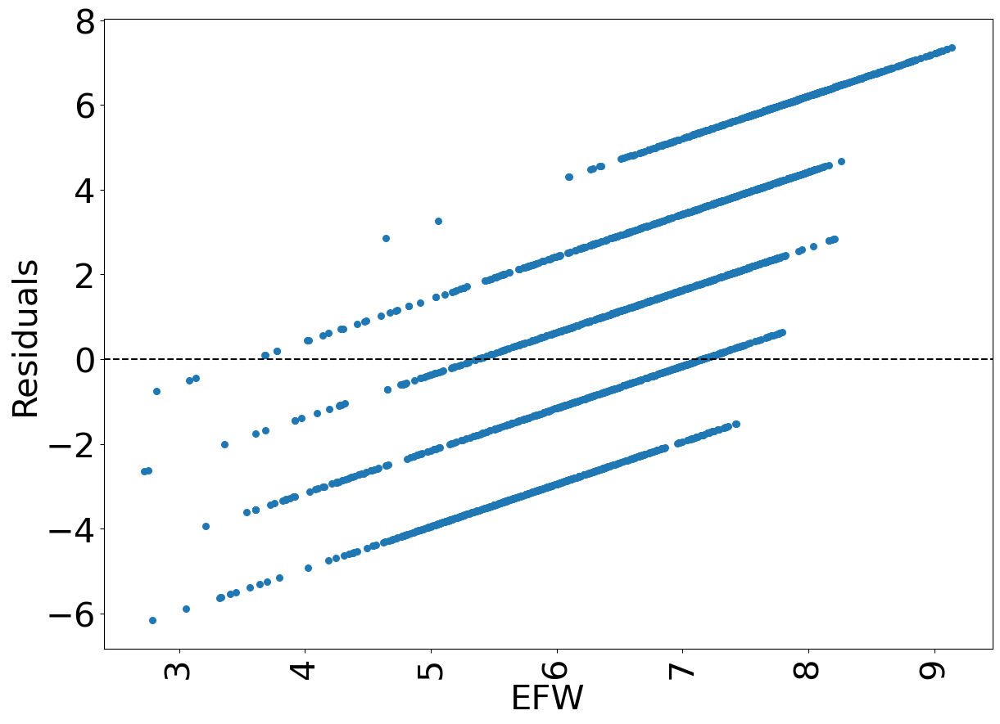

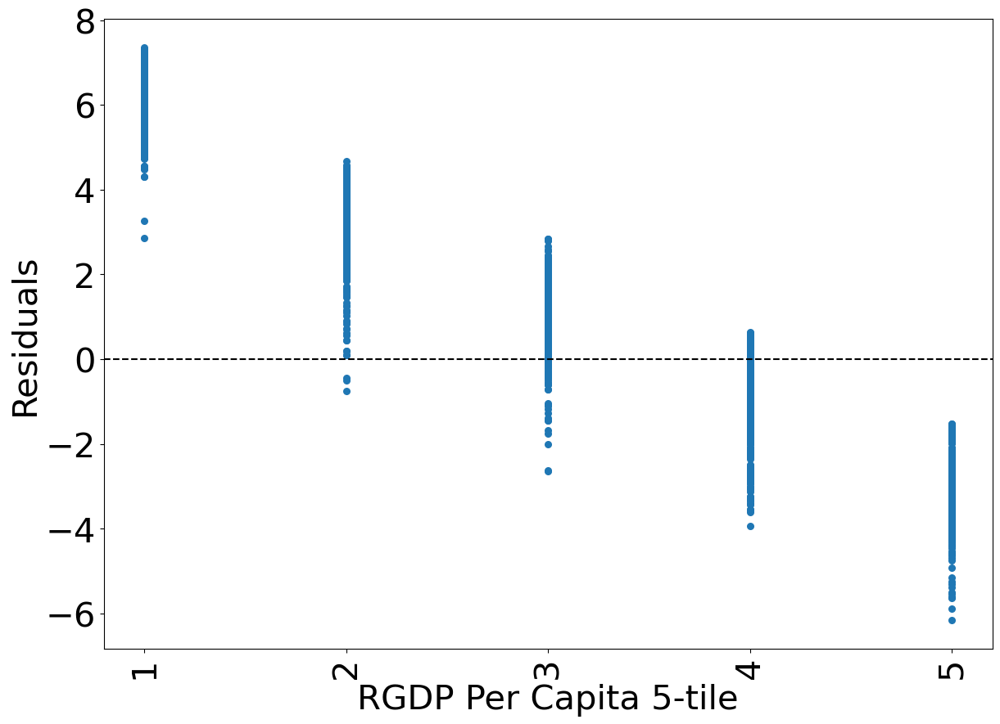

In [18]:
reg_data["Predictor"] = results.predict()
reg_data["Residuals"] = results.resid
plot_residuals(reg_data, y_name, X_names)

In [19]:
X_names = ["RGDP Per Capita"]
reg_data = reg_data[y_name+X_names].groupby("ISO_Code_3").diff().dropna()
results = regress(reg_data, 
                  X_names, y_name, 
                  constant = False)
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                    EFW   R-squared (uncentered):                   0.033
Model:                            OLS   Adj. R-squared (uncentered):              0.033
Method:                 Least Squares   F-statistic:                              91.24
Date:                Tue, 25 Apr 2023   Prob (F-statistic):                    2.78e-21
Time:                        10:20:17   Log-Likelihood:                         -241.42
No. Observations:                2656   AIC:                                      484.8
Df Residuals:                    2655   BIC:                                      490.7
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
RGDP Per Capita   3.59e-05   3.76e-06      9.552      0.000    2.85e-05    4.33e-05
==============================================================================
Omnibus:                     1715.914   Durbin-Watson:                   1.715
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            38159.332
Skew:                           2.693   Prob(JB):                         0.00
Kurtosis:                      20.771   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

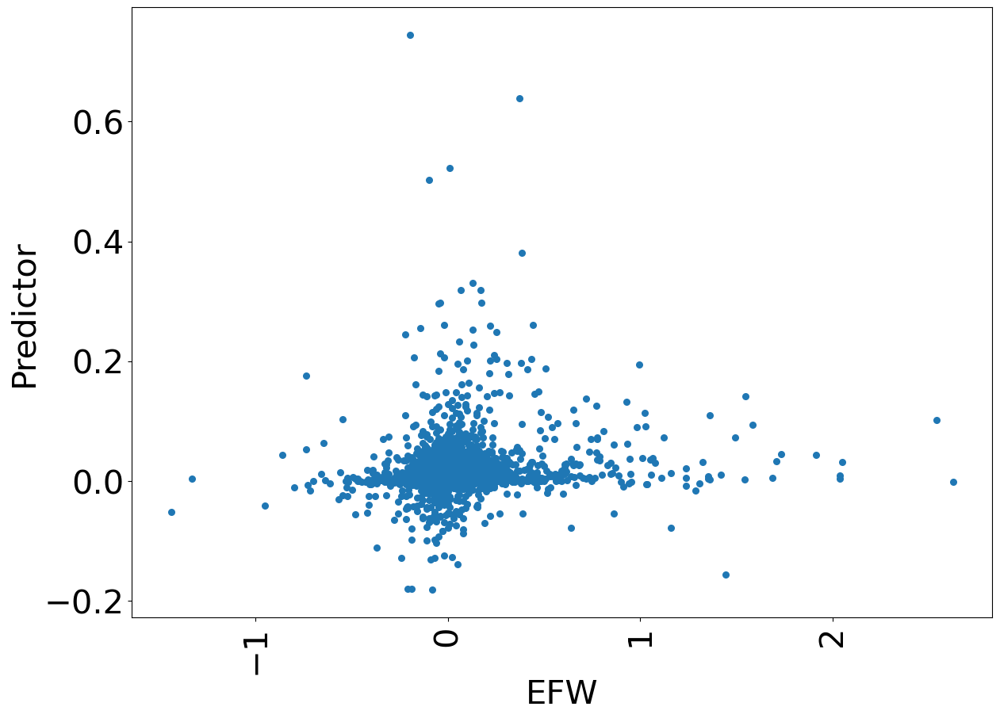

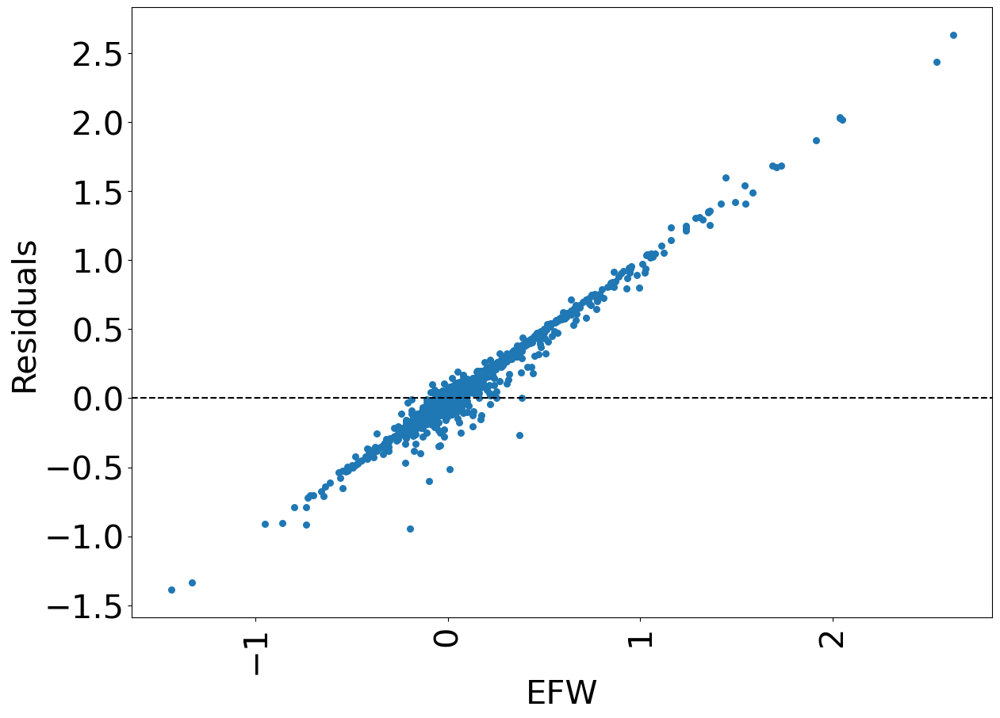

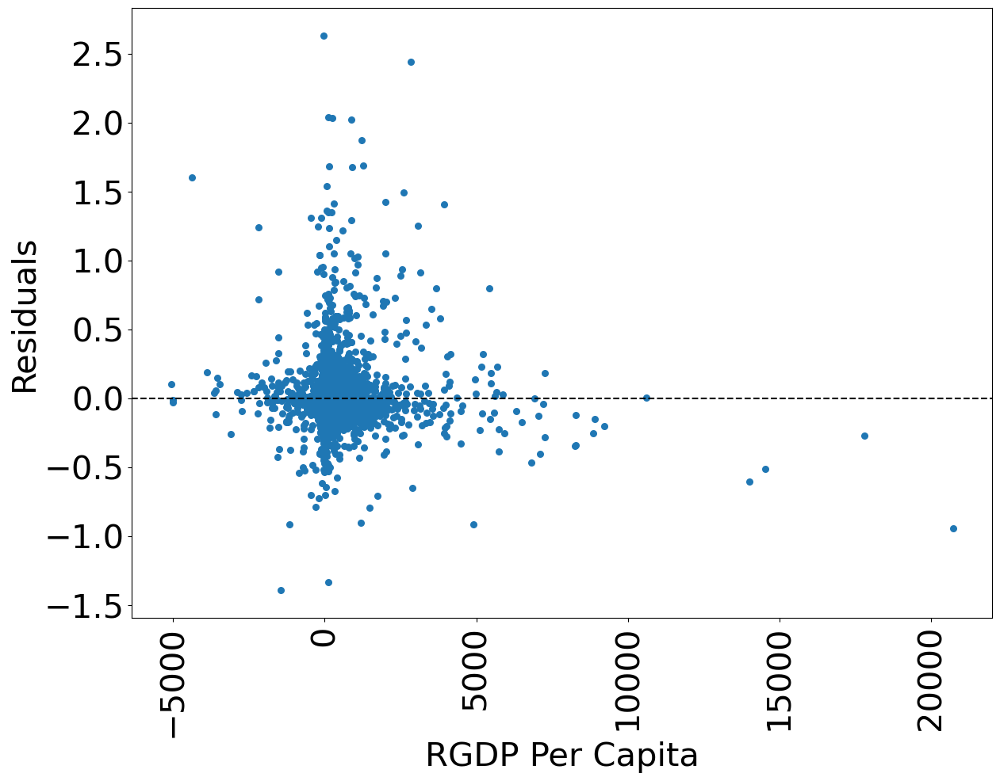

In [21]:
reg_data["Predictor"] = results.predict()
reg_data["Residuals"] = results.resid
plot_residuals(reg_data, y_name, X_names)

## Panel Regression

In [23]:
#!pip install linearmodels

In [25]:
from linearmodels import PanelOLS

In [30]:
# create another regression with Panel instead of the other one

# build in constant, entity, and time to the function

def panel_regress(data, x_names, y_name, 
                  constant = False, 
                  entity = False,
                  time = False):
    X = data[x_names]
    if constant:
        X["constant"] = 1
    y = data[y_name]
    results = PanelOLS(y,X,
                      entity_effects = entity,
                      time_effects = time).fit(cov_type = "clustered", 
                                               cluster_entity = True)
    return results

reg_data = data.dropna()
results = panel_regress(reg_data, X_names,
             y_name,
              constant = True,
             entity = True,
             time = True)
results

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1


Dep. Variable:,EFW,R-squared:,0.0121
Estimator:,PanelOLS,R-squared (Between):,-0.3218
No. Observations:,2808,R-squared (Within):,-0.0840
Date:,"Tue, Apr 25 2023",R-squared (Overall):,-0.2833
Time:,10:26:29,Log-likelihood,-1043.6
Cov. Estimator:,Clustered,,
,,F-statistic:,32.191
Entities:,165,P-value,0.0000
Avg Obs:,17.018,Distribution:,"F(1,2635)"
Min Obs:,0.0000,,
Max Obs:,21.000,F-statistic (robust):,7.6217


C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3123732444.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3123732444.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Residuals"] = results.resids


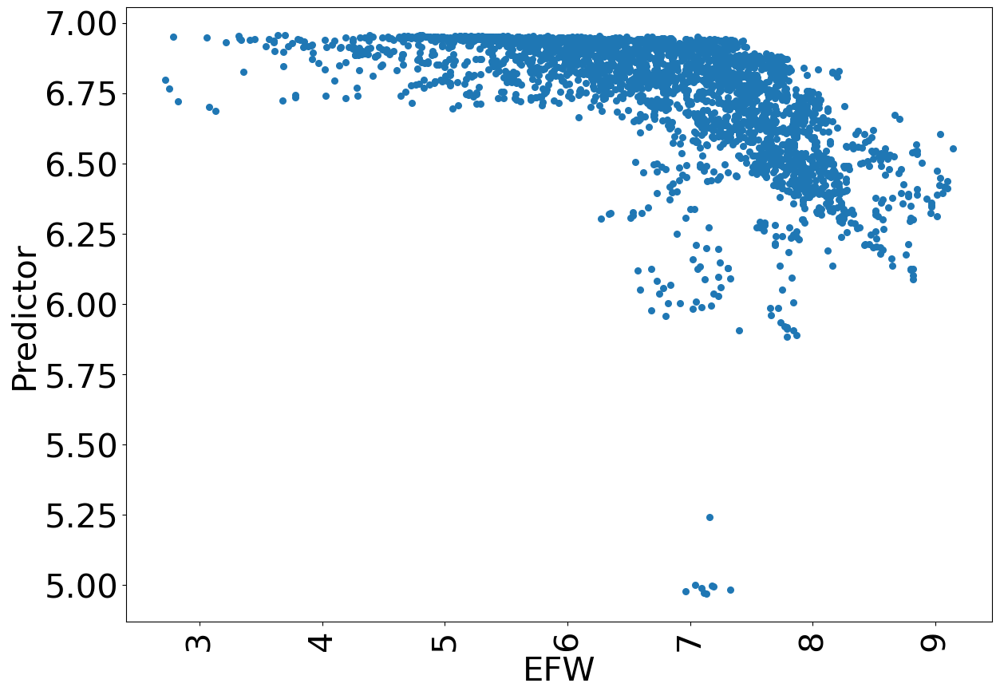

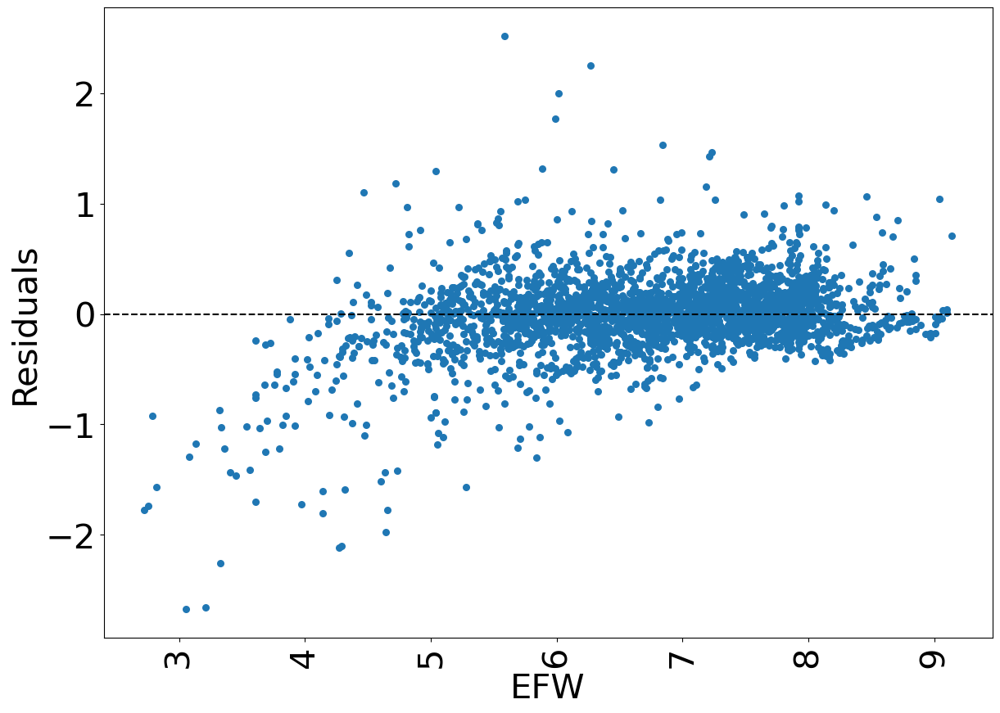

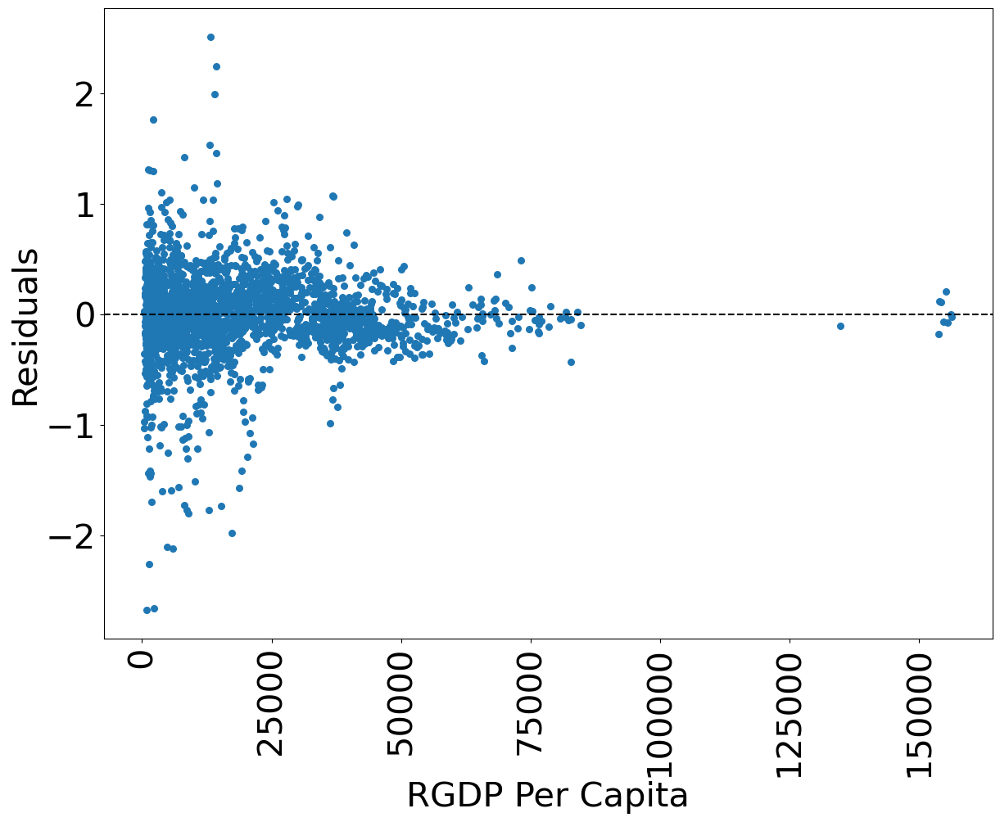

In [33]:
# notice how these controls for the model have solved the linear 
# clustering problem with residuals in previous regressions.
# this change has made a much more accurate model that is less biased by these
# different factors.

reg_data["Predictor"] = results.predict()
reg_data["Residuals"] = results.resids
plot_residuals(reg_data, y_name, X_names)

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:True
Time: True
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.0380
Estimator:                   PanelOLS   R-squared (Between):             -0.0776
No. Observations:                2808   R-squared (Within):              -0.0217
Date:                Tue, Apr 25 2023   R-squared (Overall):             -0.0870
Time:                        10:42:22   Log-likelihood                -2.645e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      20.810
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(5,2631)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             3.4484
     

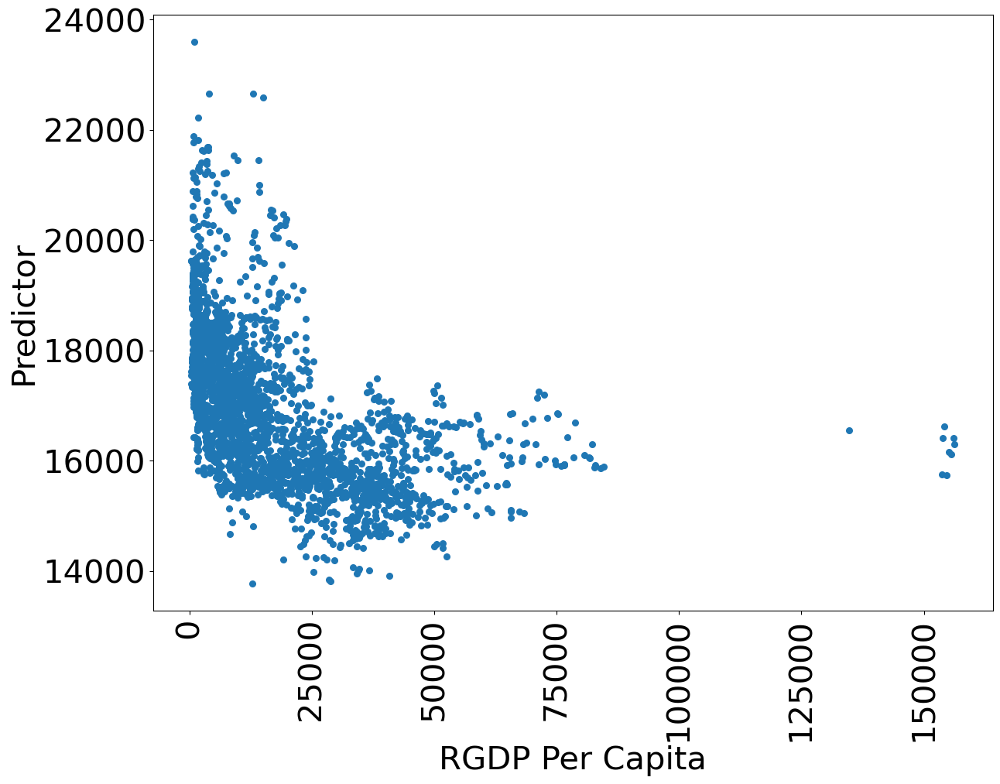

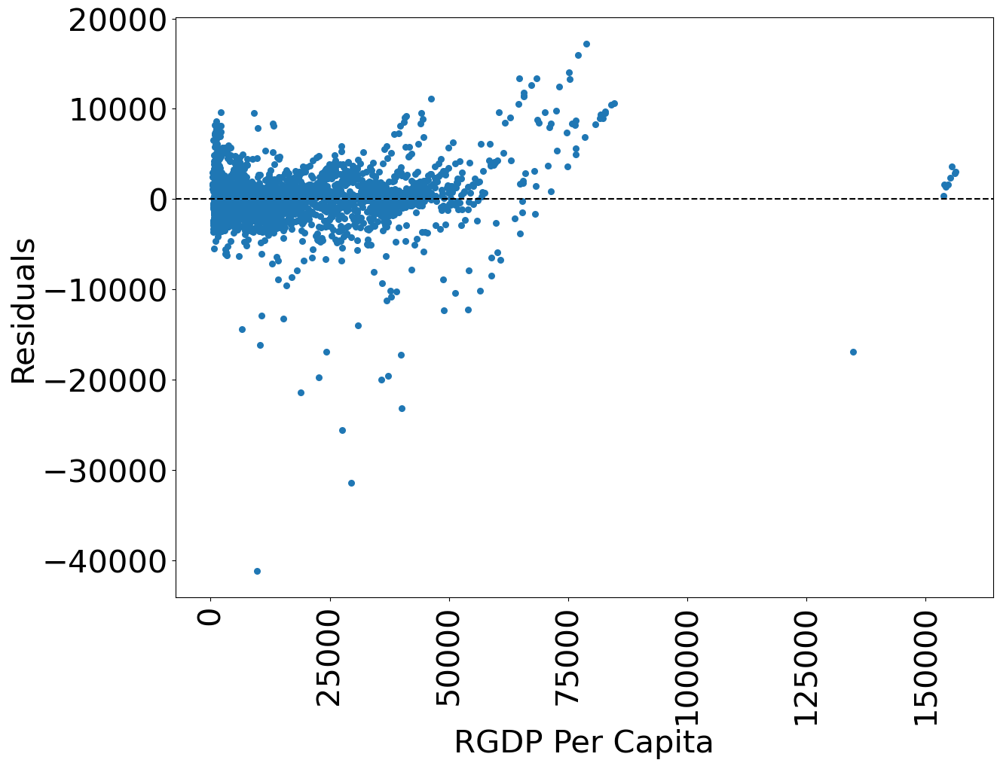

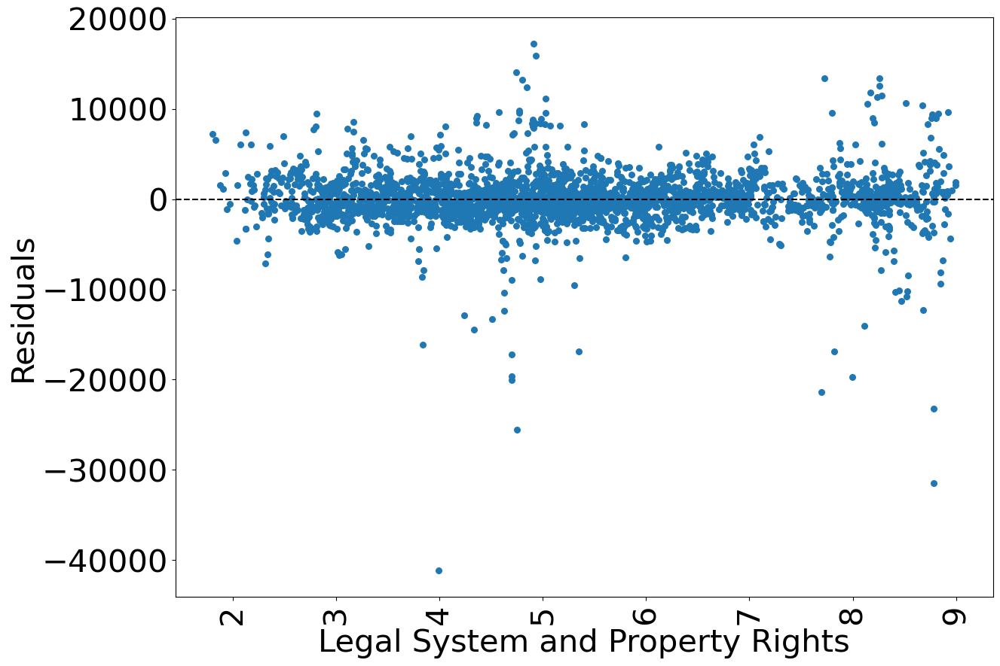

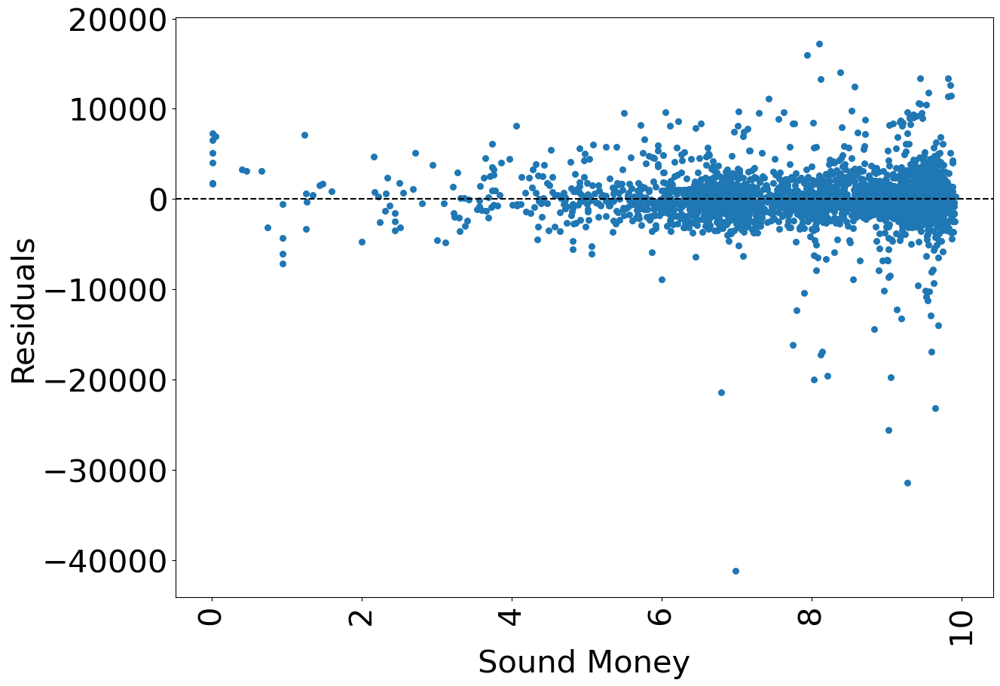

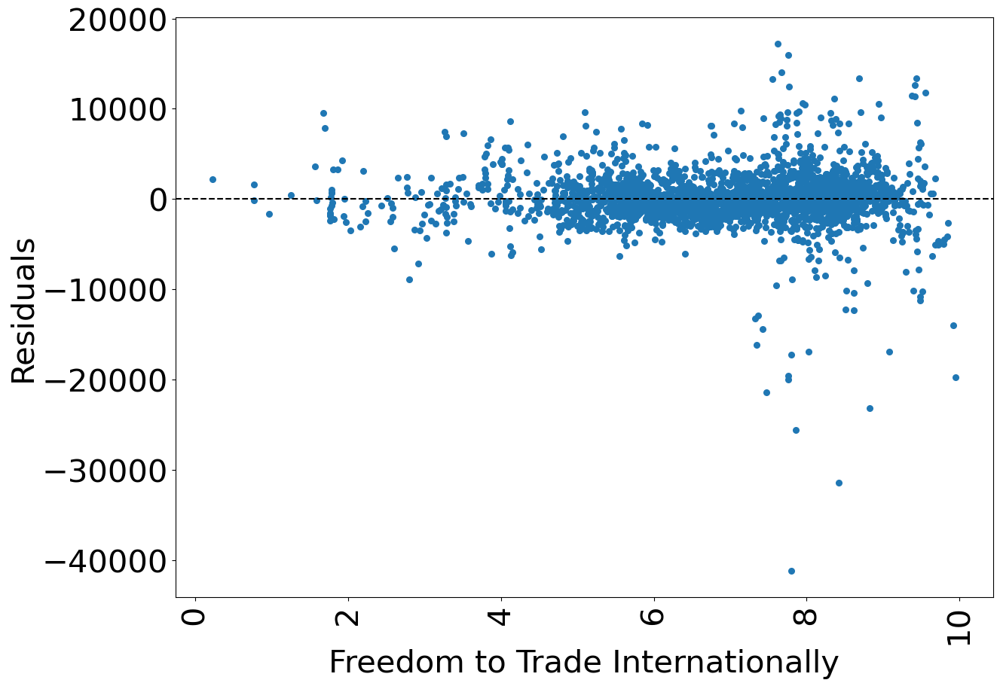

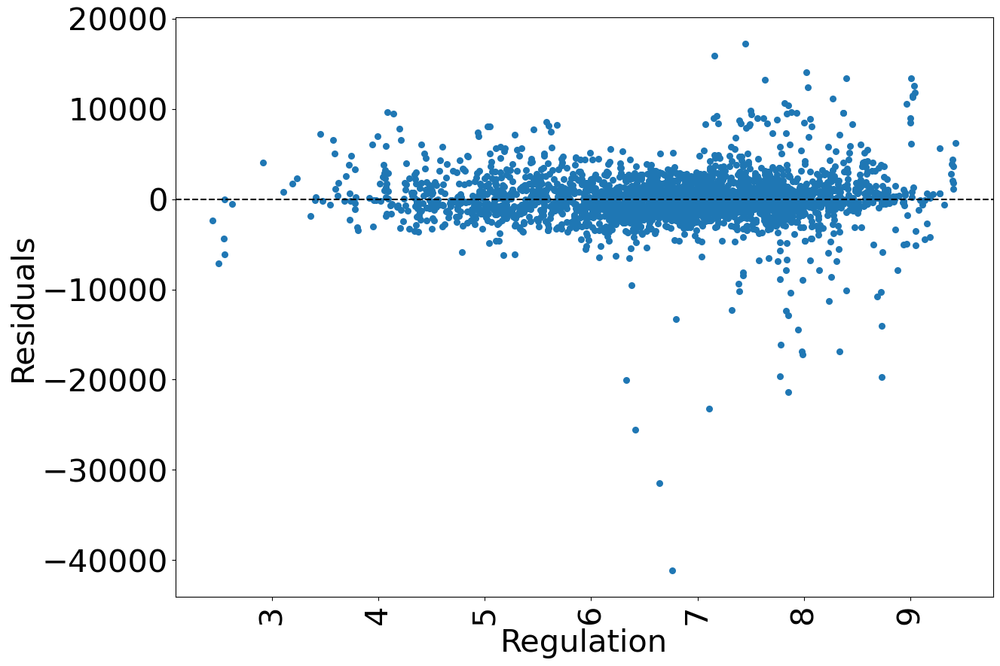

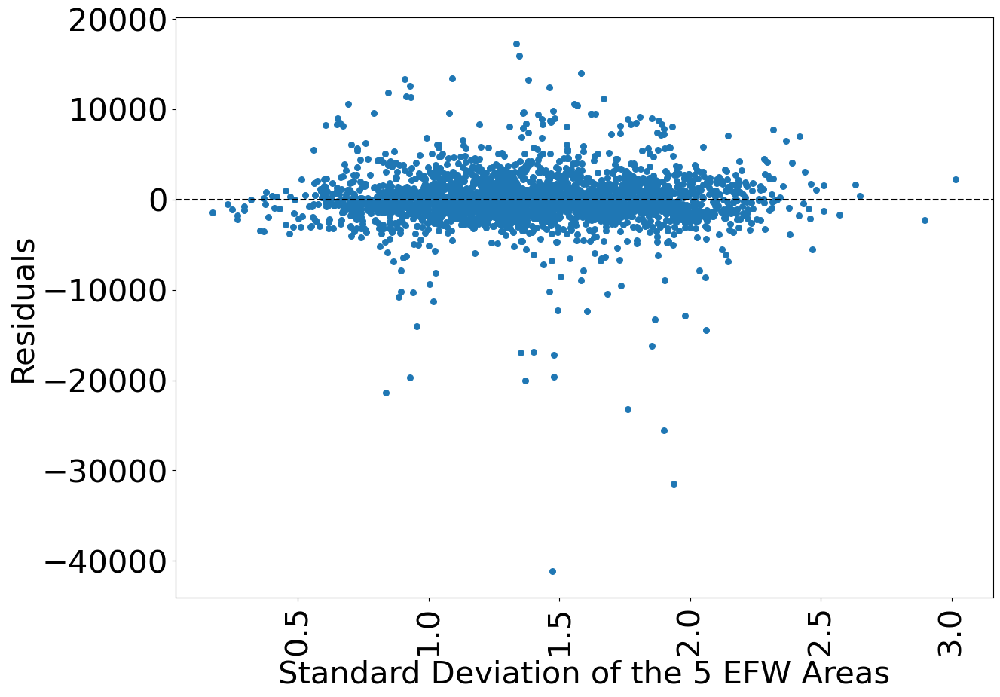

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:True
Time: False
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.1678
Estimator:                   PanelOLS   R-squared (Between):              0.2317
No. Observations:                2808   R-squared (Within):               0.1678
Date:                Tue, Apr 25 2023   R-squared (Overall):              0.2810
Time:                        10:42:25   Log-likelihood                -2.705e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      106.89
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(5,2651)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             18.943
    

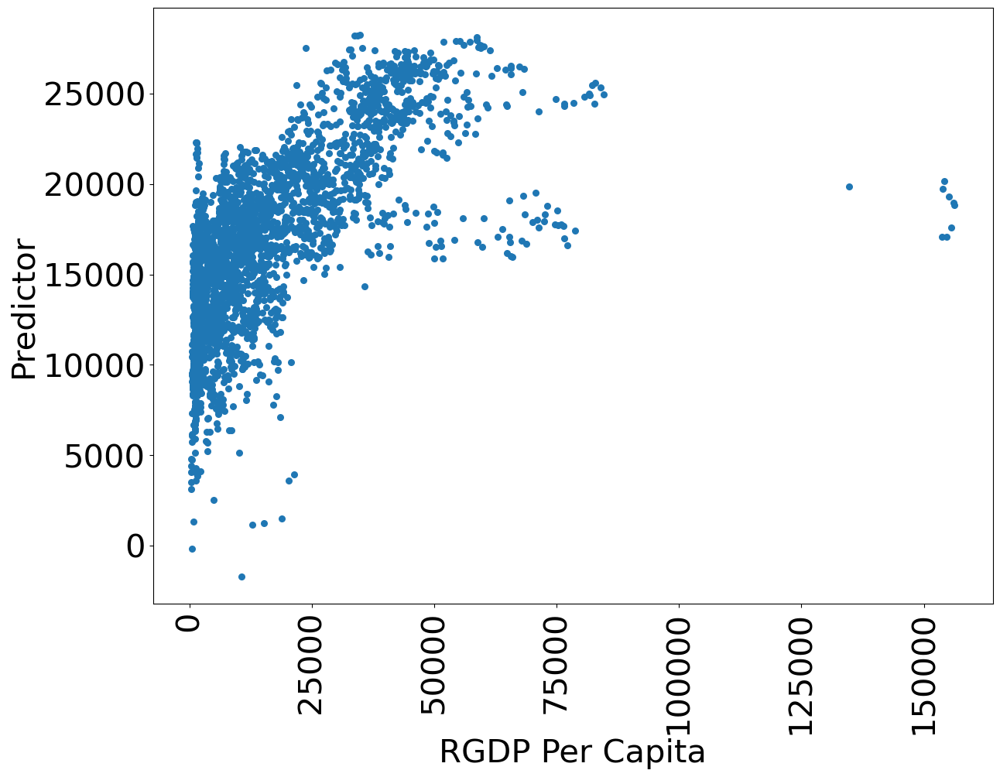

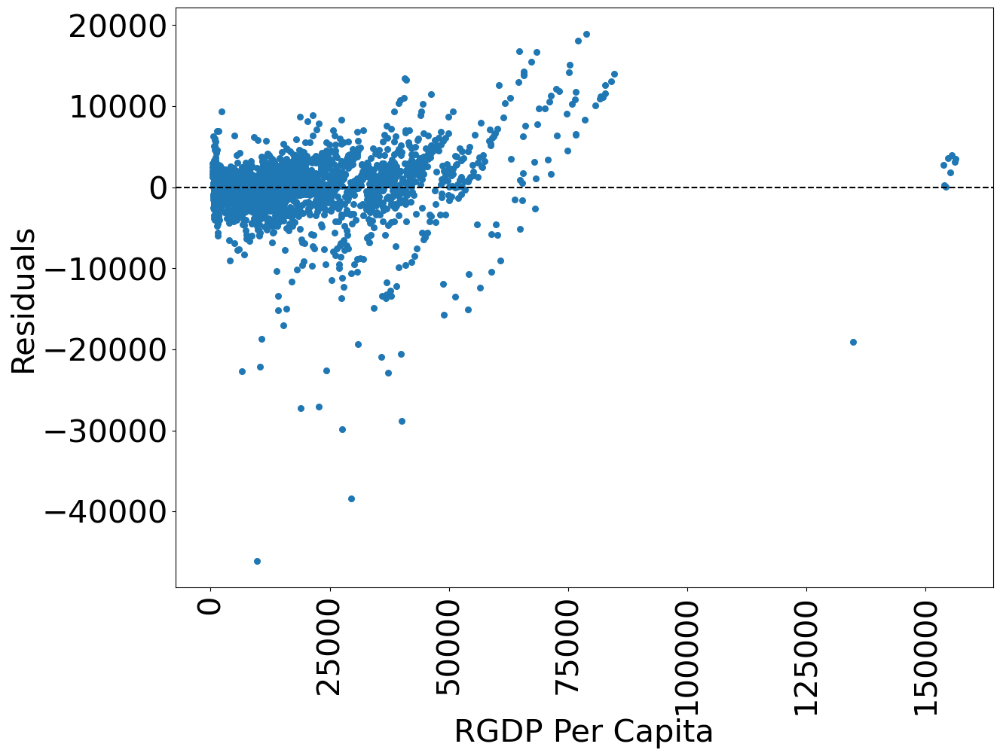

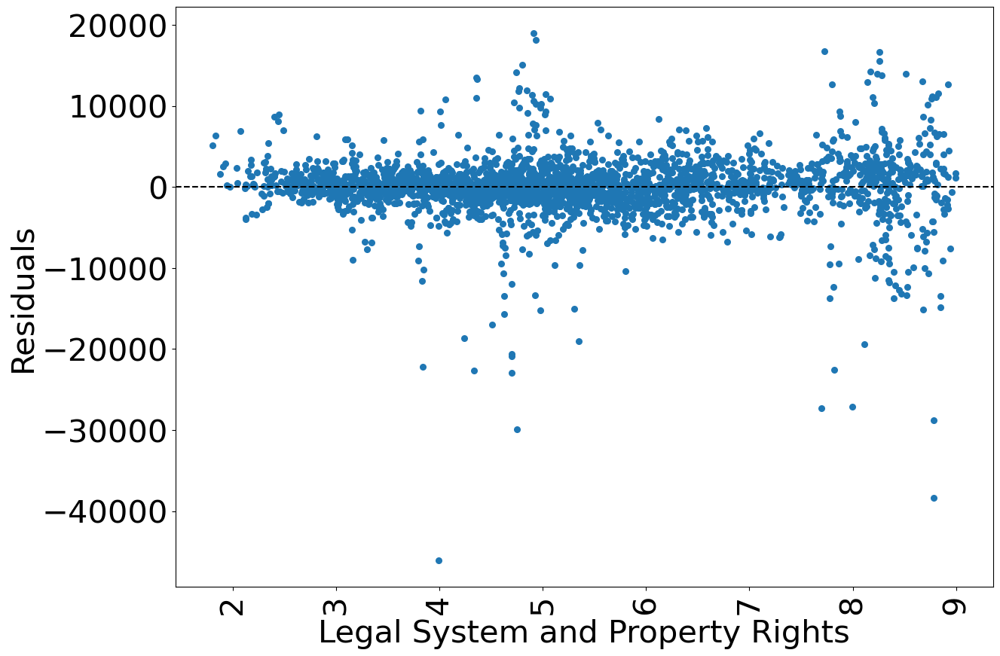

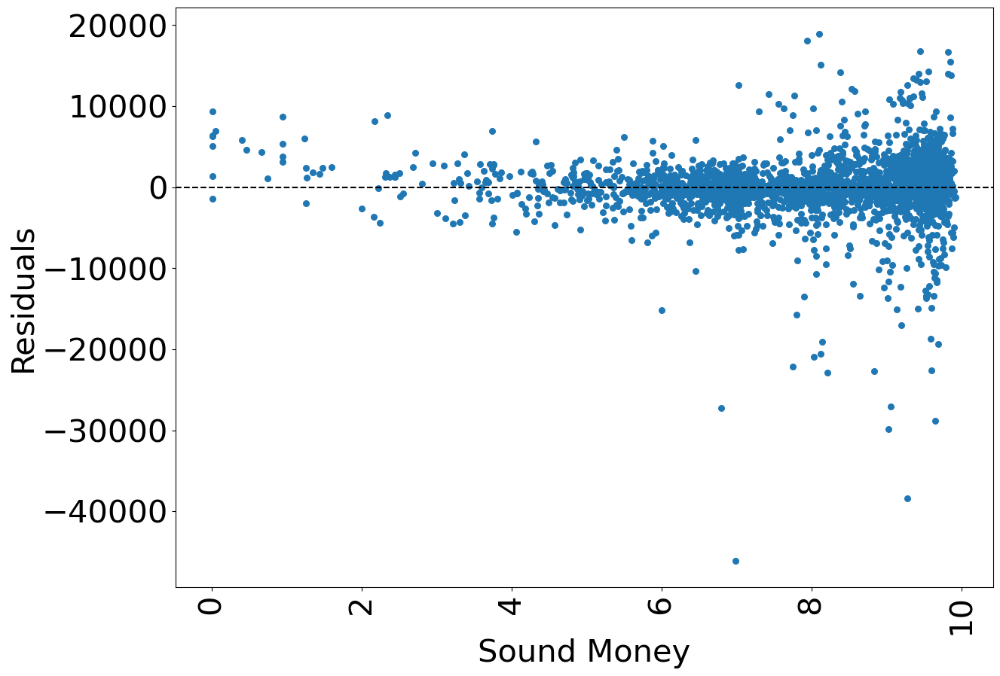

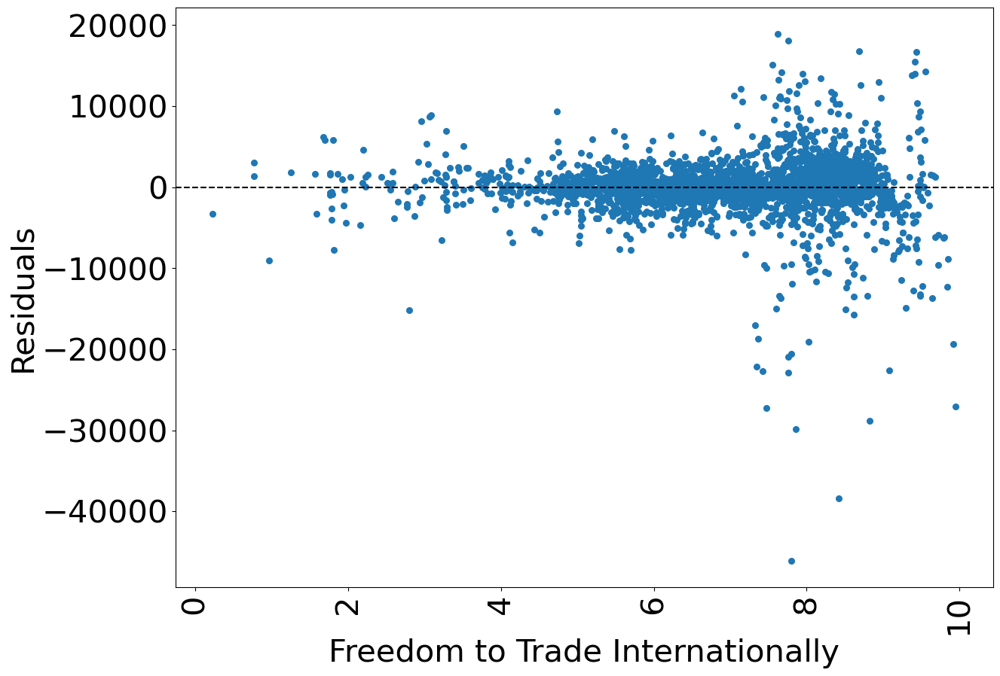

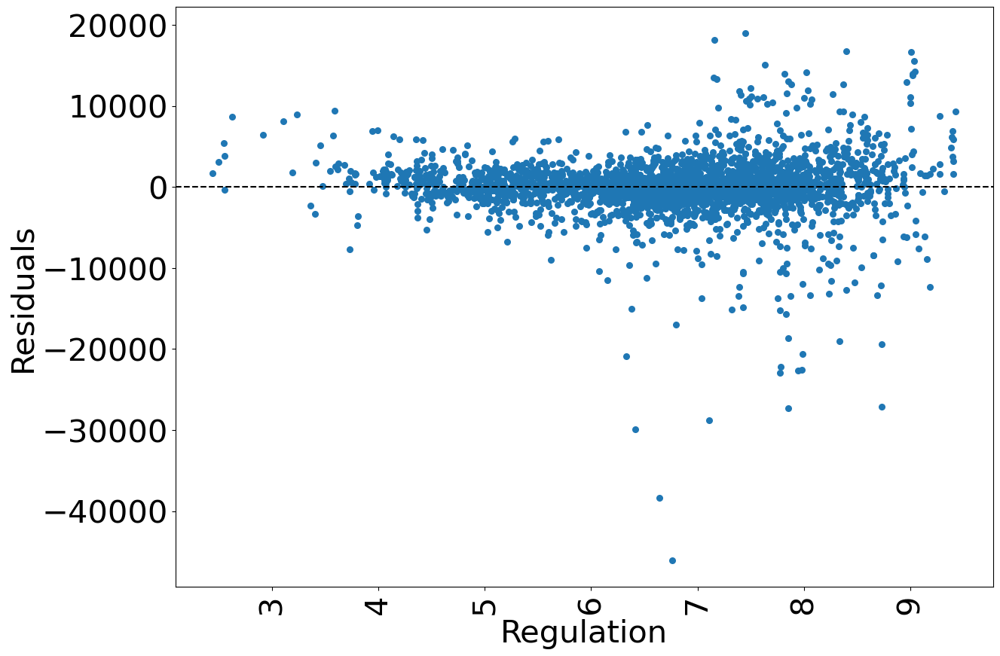

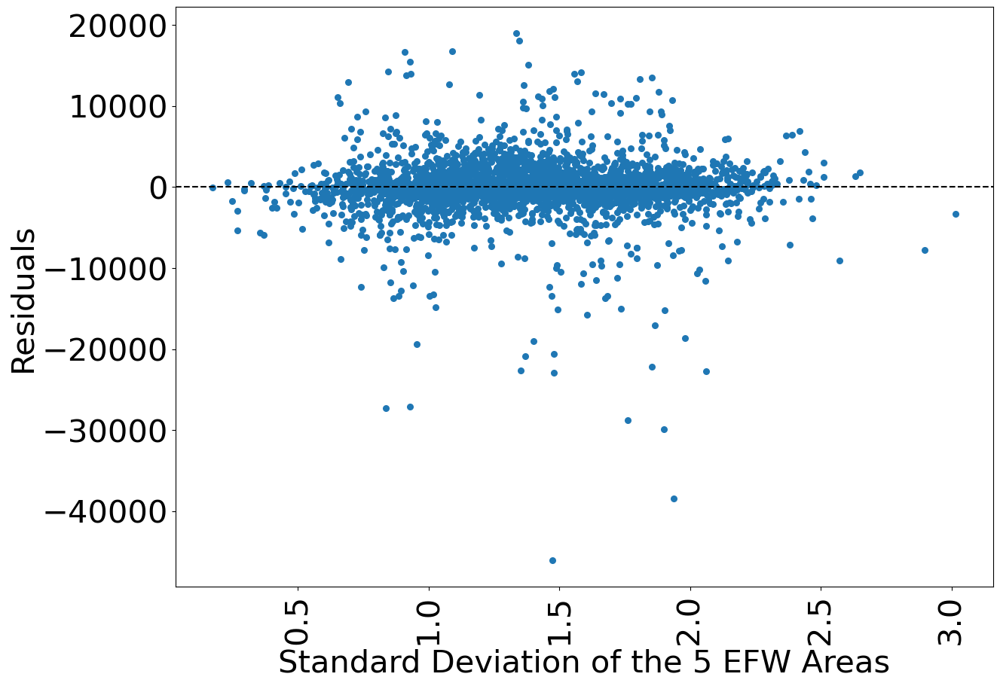

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:False
Time: True
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.4831
Estimator:                   PanelOLS   R-squared (Between):              0.4121
No. Observations:                2808   R-squared (Within):              -0.1181
Date:                Tue, Apr 25 2023   R-squared (Overall):              0.4799
Time:                        10:42:28   Log-likelihood                -3.052e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      519.97
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(5,2782)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             58.125
    

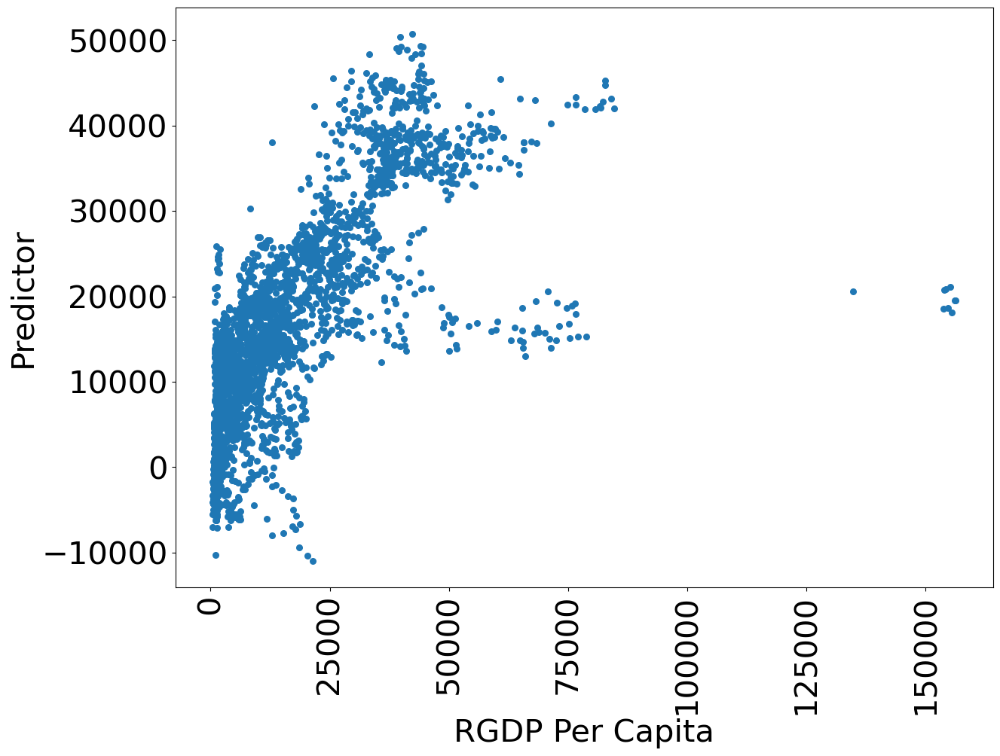

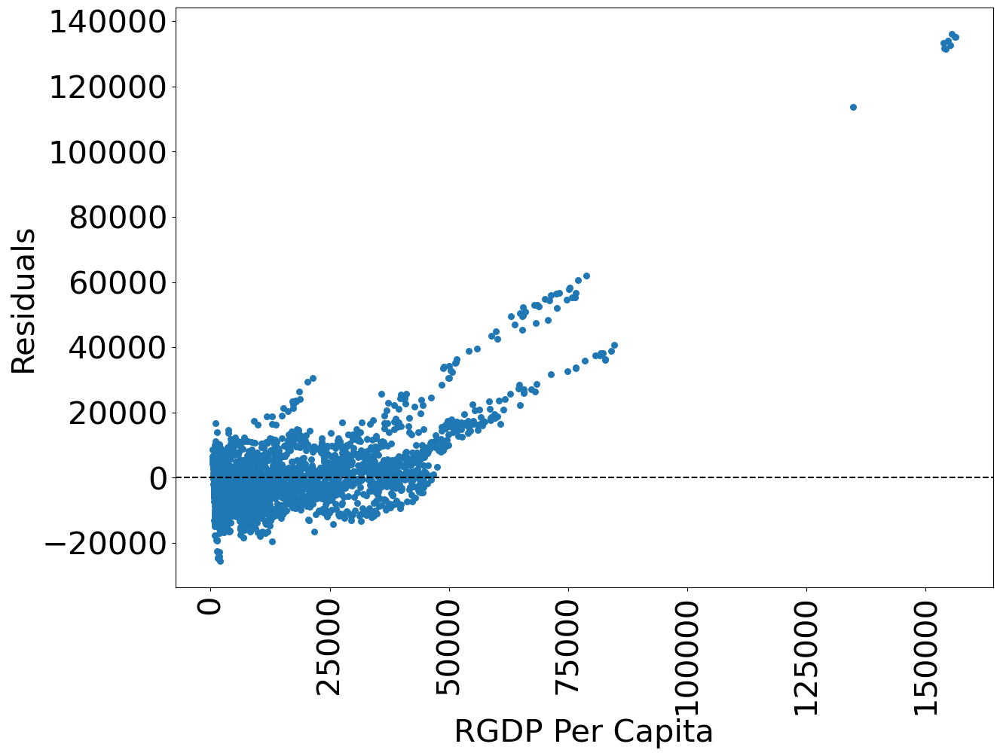

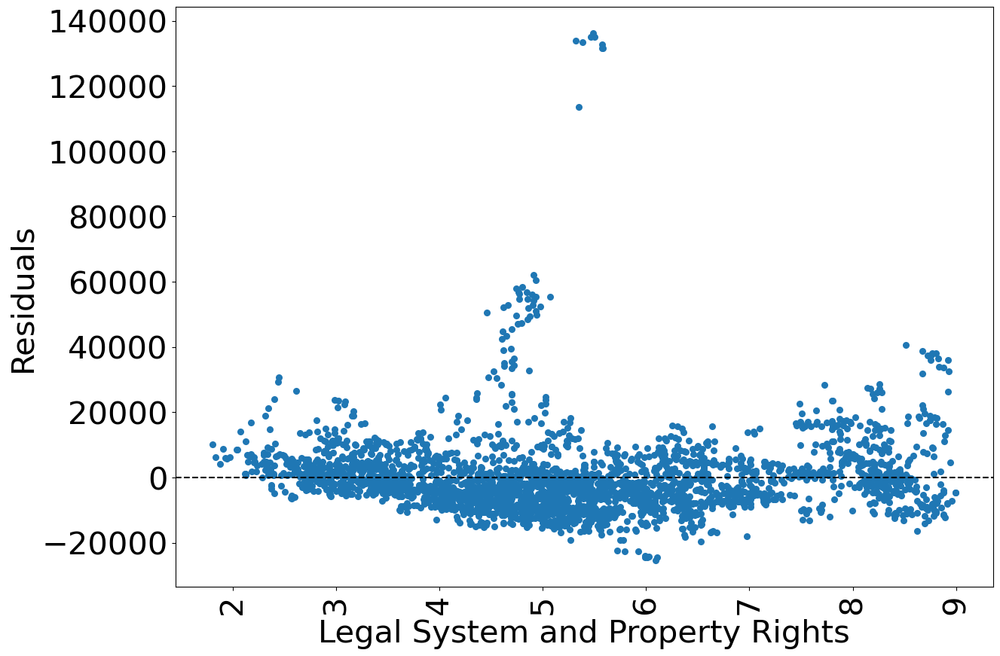

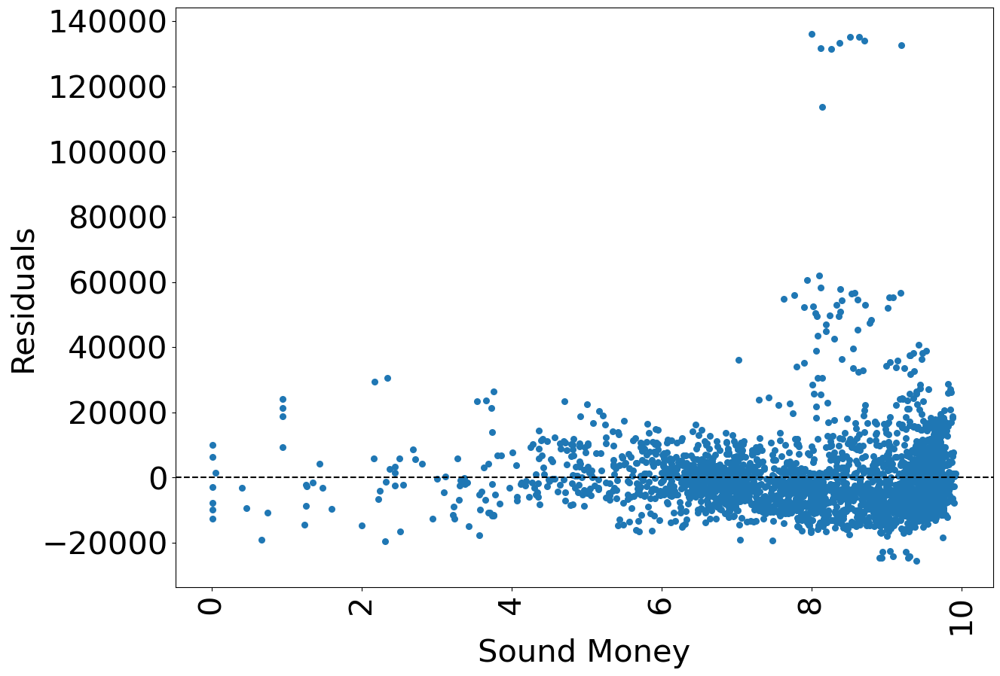

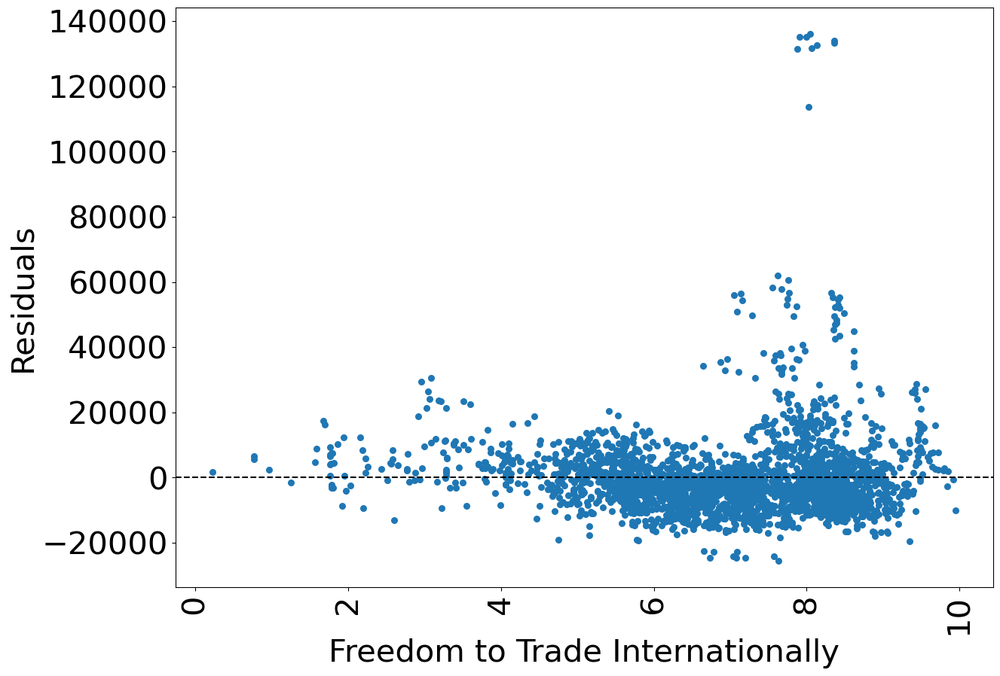

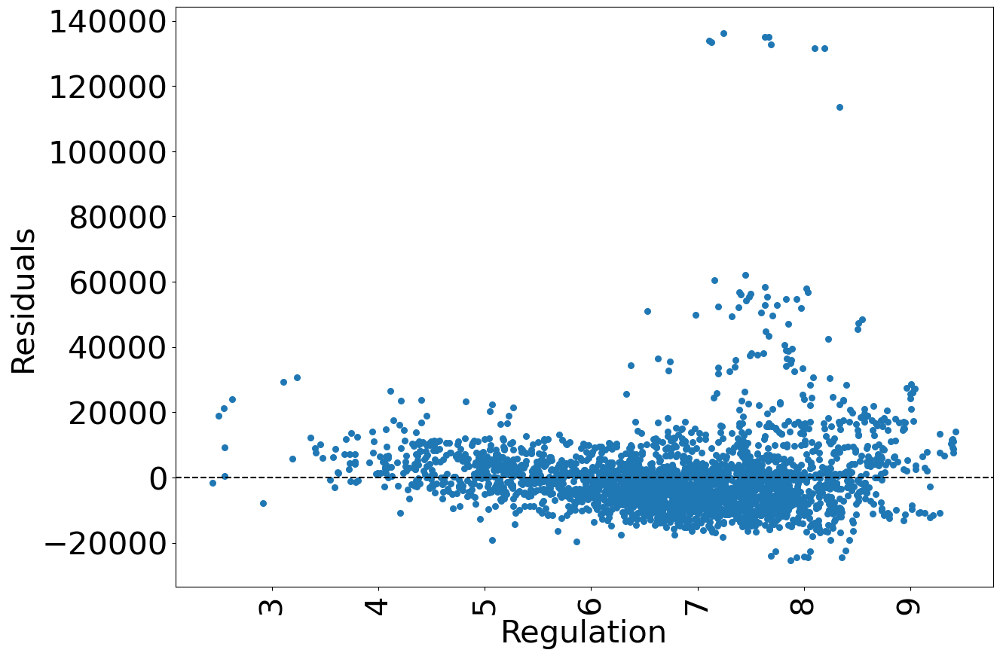

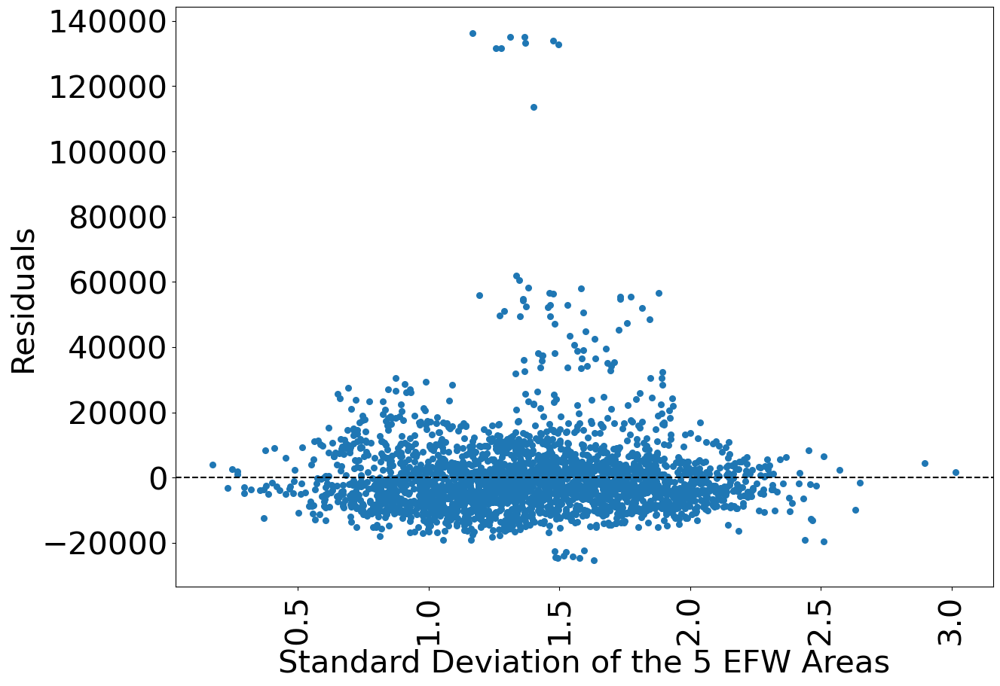

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\1153144598.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:False
Time: False
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.4815
Estimator:                   PanelOLS   R-squared (Between):              0.4113
No. Observations:                2808   R-squared (Within):              -0.0608
Date:                Tue, Apr 25 2023   R-squared (Overall):              0.4815
Time:                        10:42:31   Log-likelihood                -3.054e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      520.35
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(5,2802)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             58.051
   

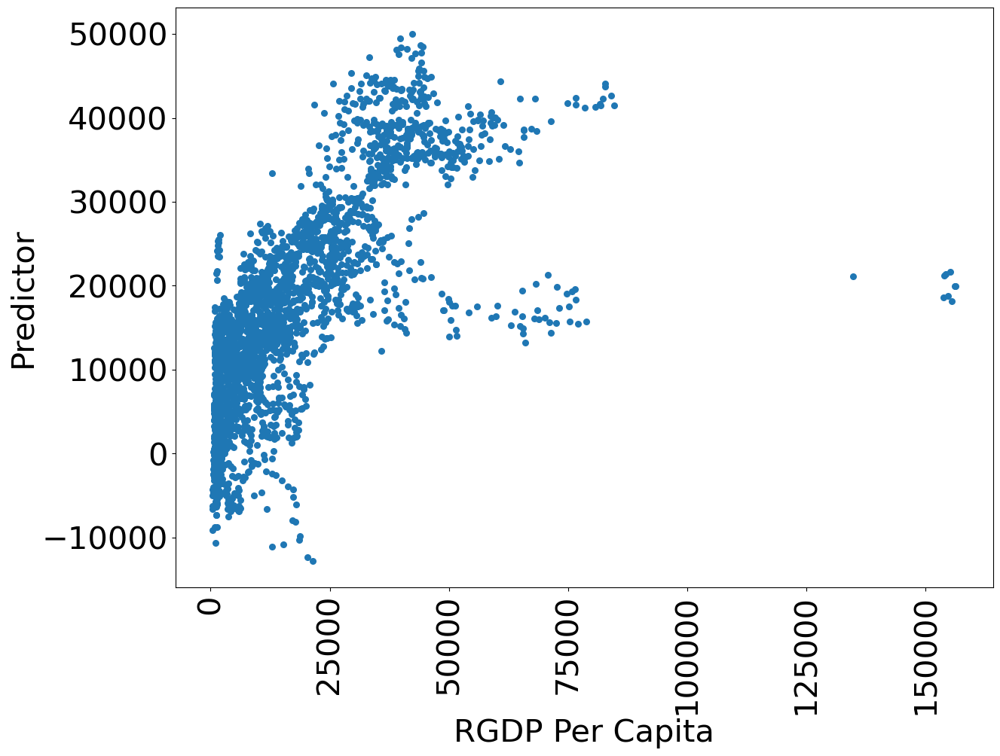

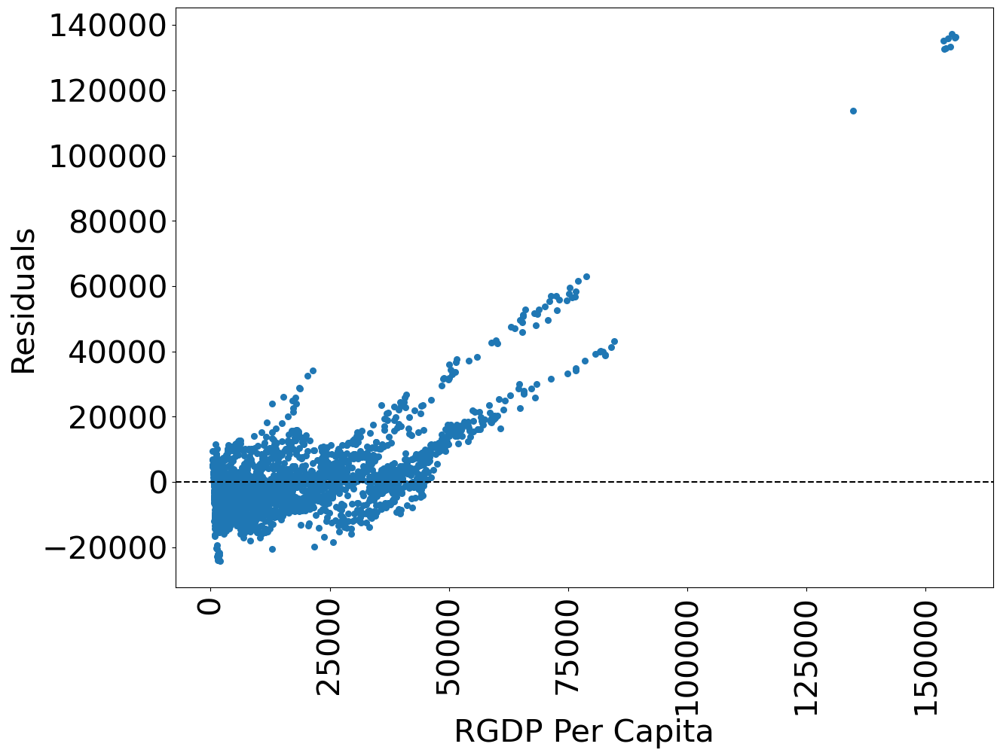

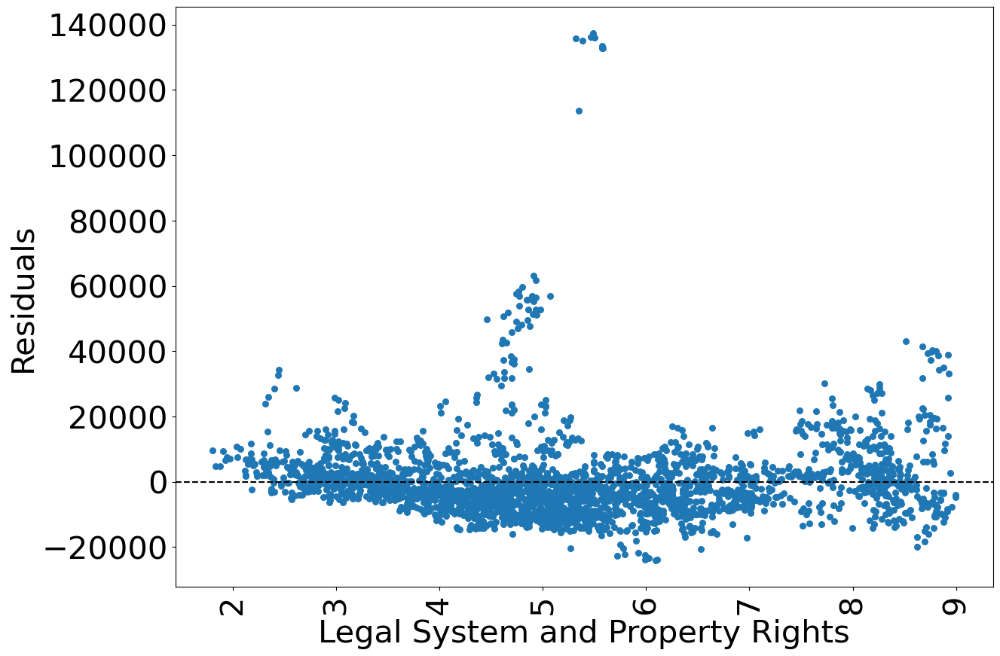

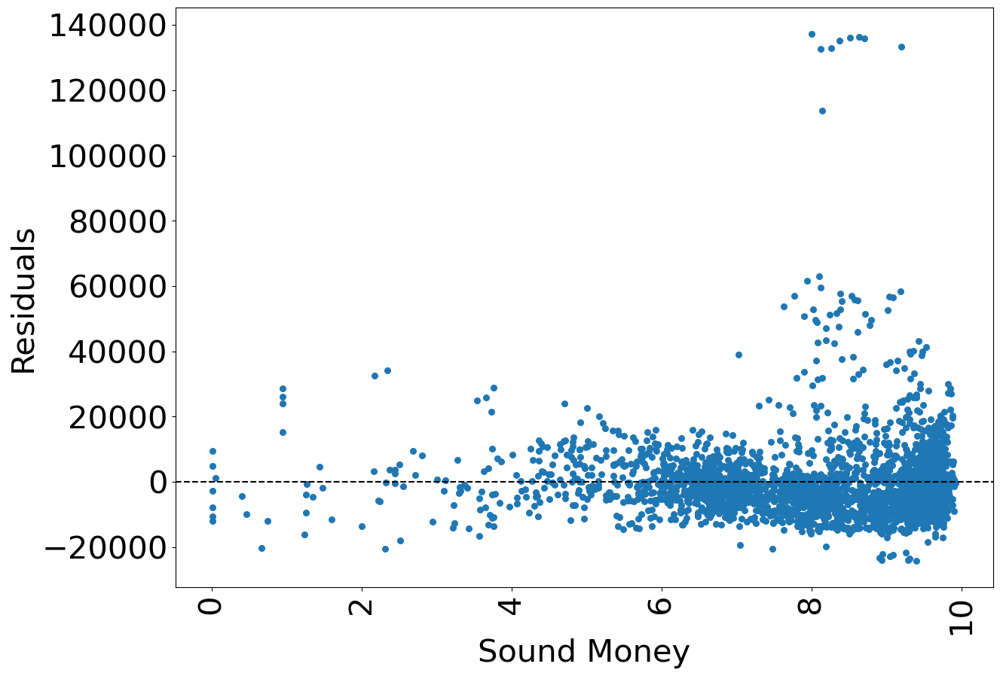

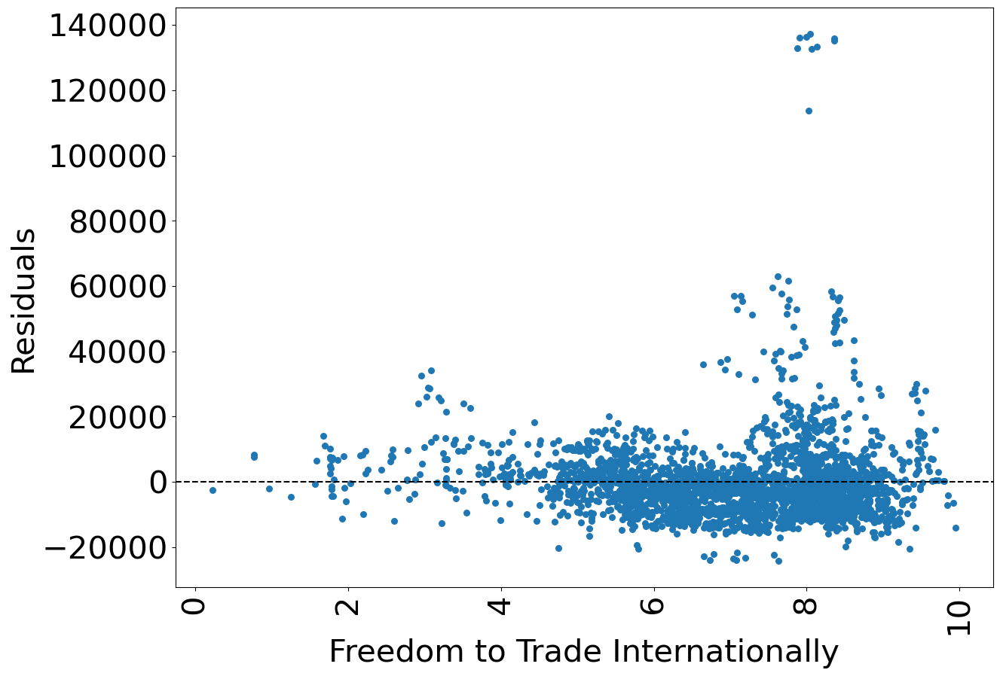

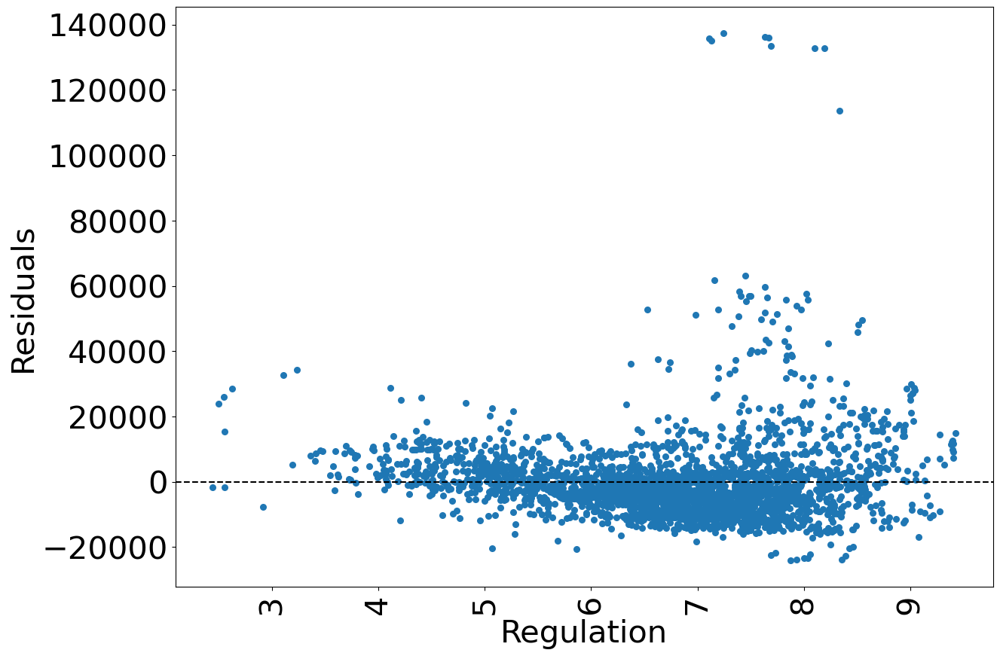

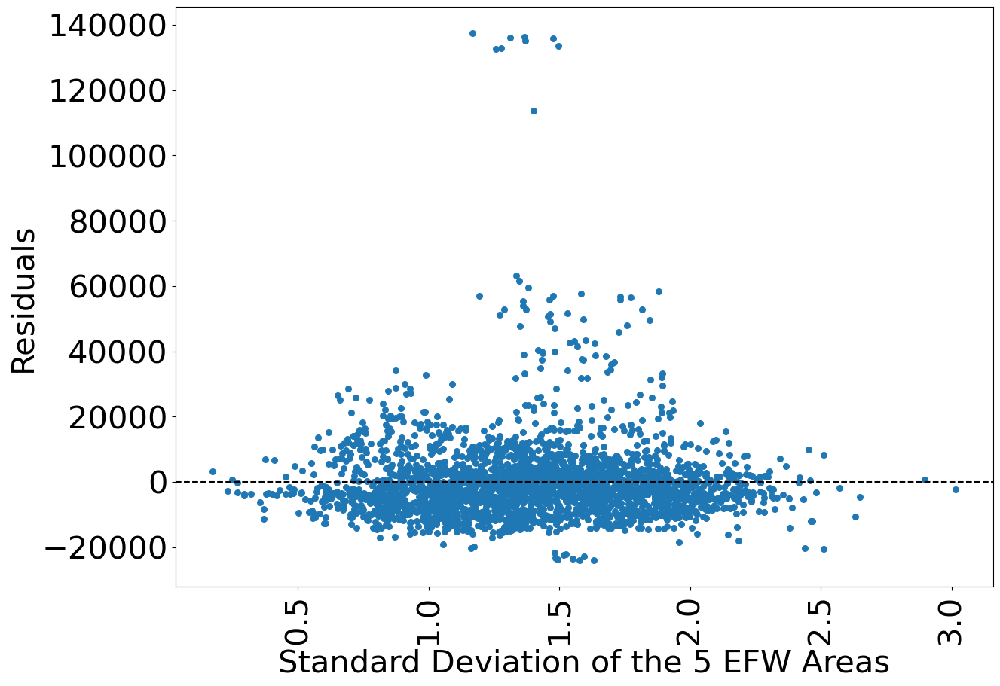

In [42]:
# run previous regression but with all different entity and time options inside of this model.

# though using these effects fixes a lot of issues in residuals, we would need to find a way to 
# explain why this is superior, although that is a little more compliated. 

for entity in [True, False]:
    for time in [True, False]:        
        reg_data = data.dropna()
        results = panel_regress(reg_data, X_names,
                     y_name,
                      constant = True,
                     entity = entity,
                     time = time)
        print("Entity:" + str(entity) + "\nTime: " + str(time))
        print(results)
        reg_data["Predictor"] = results.predict()
        reg_data["Residuals"] = results.resids
        plot_residuals(reg_data, y_name, X_names)
 

In [45]:
X_names

['Size of Government',
 'Legal System and Property Rights',
 'Sound Money',
 'Freedom to Trade Internationally',
 'Regulation',
 'Standard Deviation of the 5 EFW Areas']

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1


Entity:True
Time: True
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.0385
Estimator:                   PanelOLS   R-squared (Between):             -0.0872
No. Observations:                2808   R-squared (Within):              -0.0207
Date:                Tue, Apr 25 2023   R-squared (Overall):             -0.0980
Time:                        10:43:01   Log-likelihood                -2.645e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      17.551
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(6,2630)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             2.8726
     

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Residuals"] = results.resids


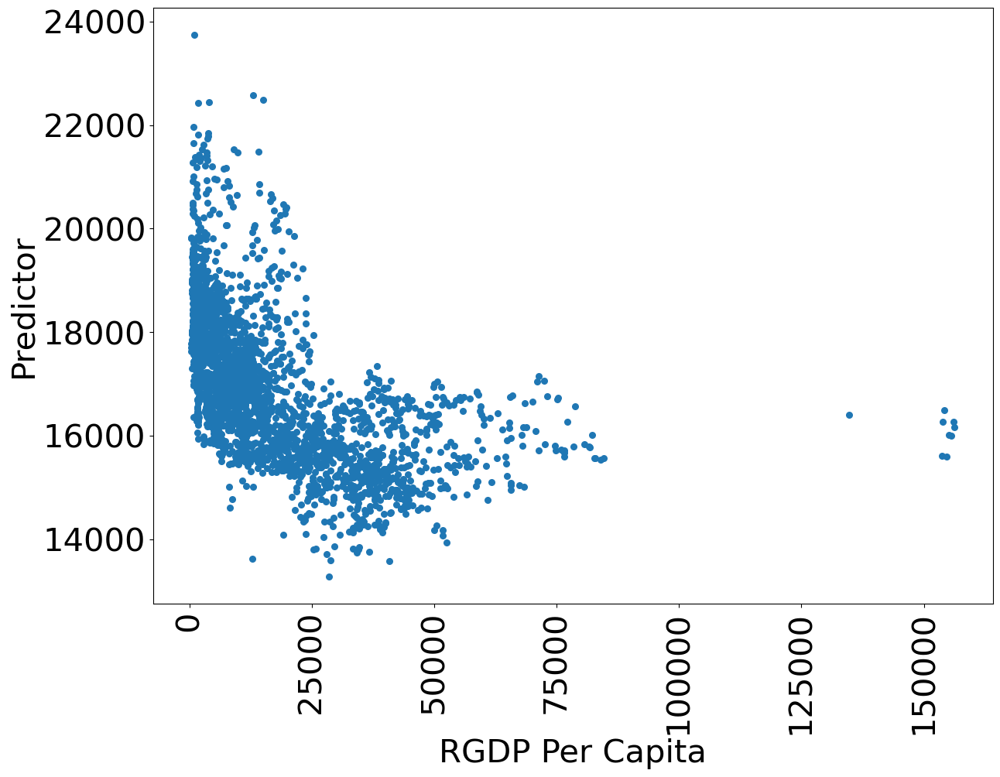

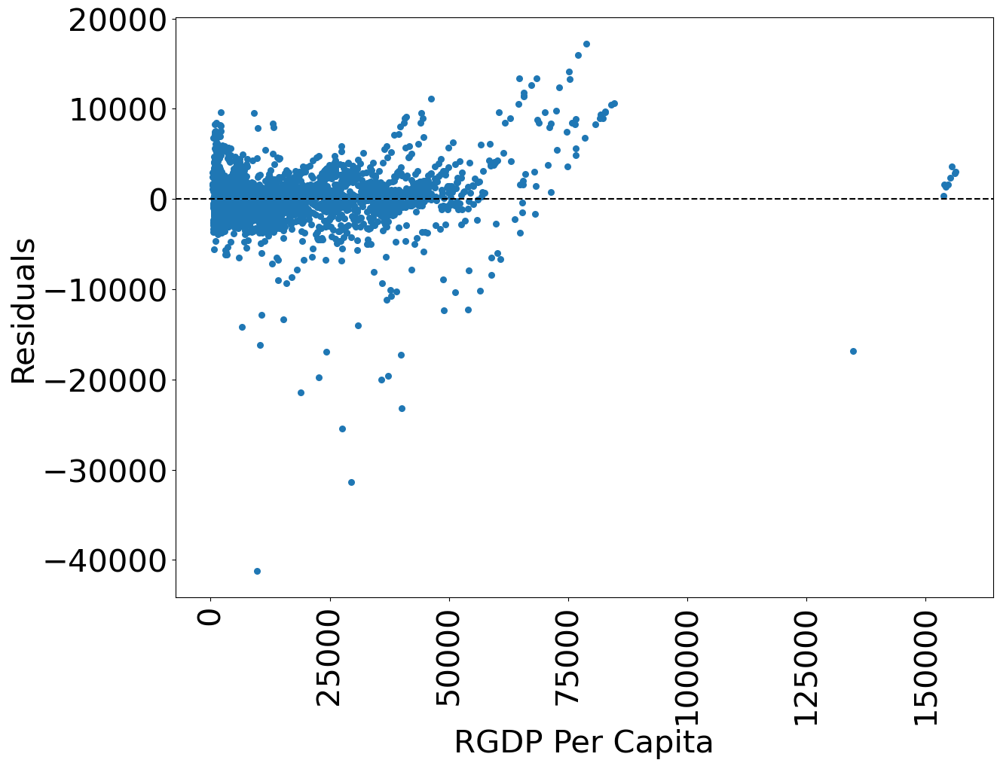

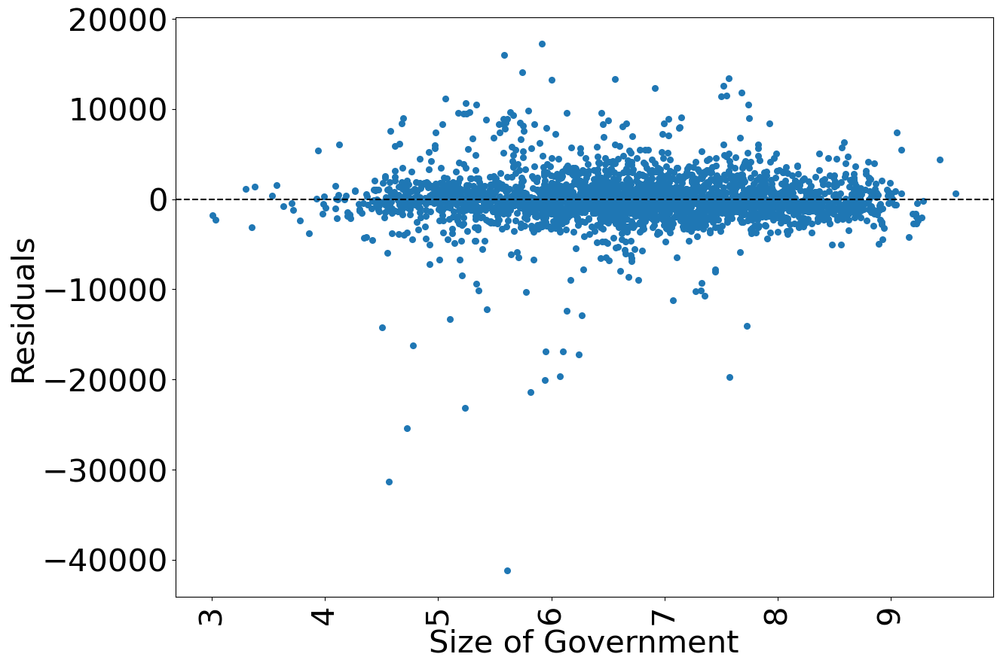

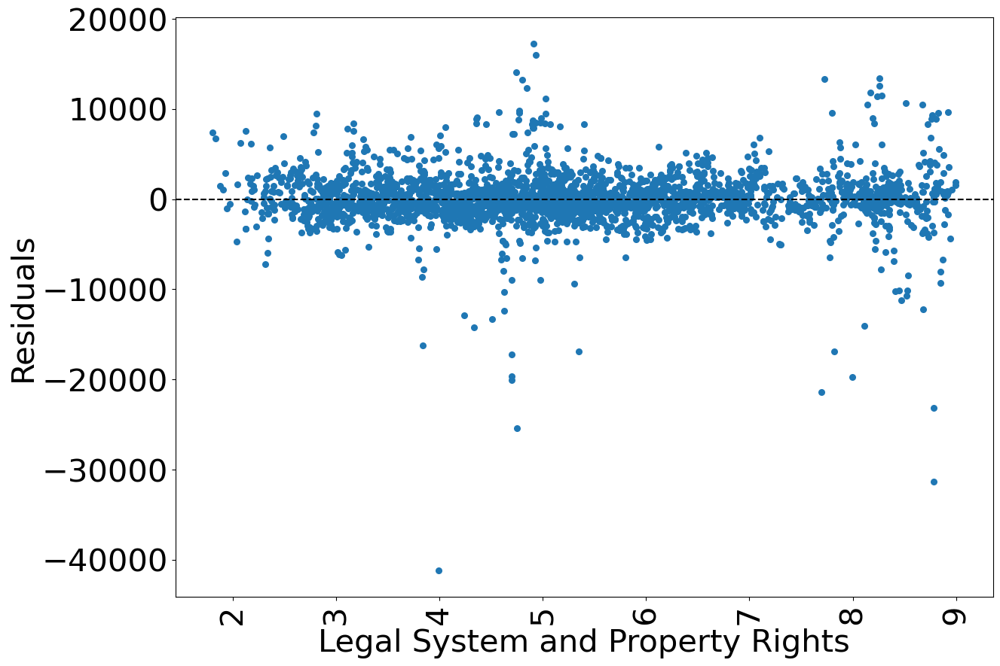

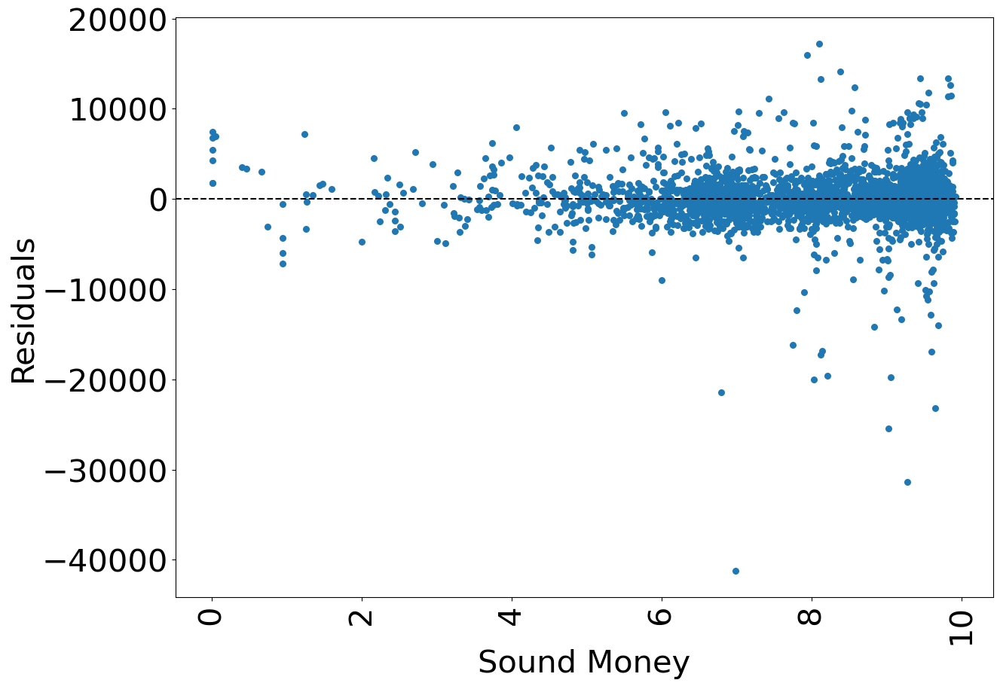

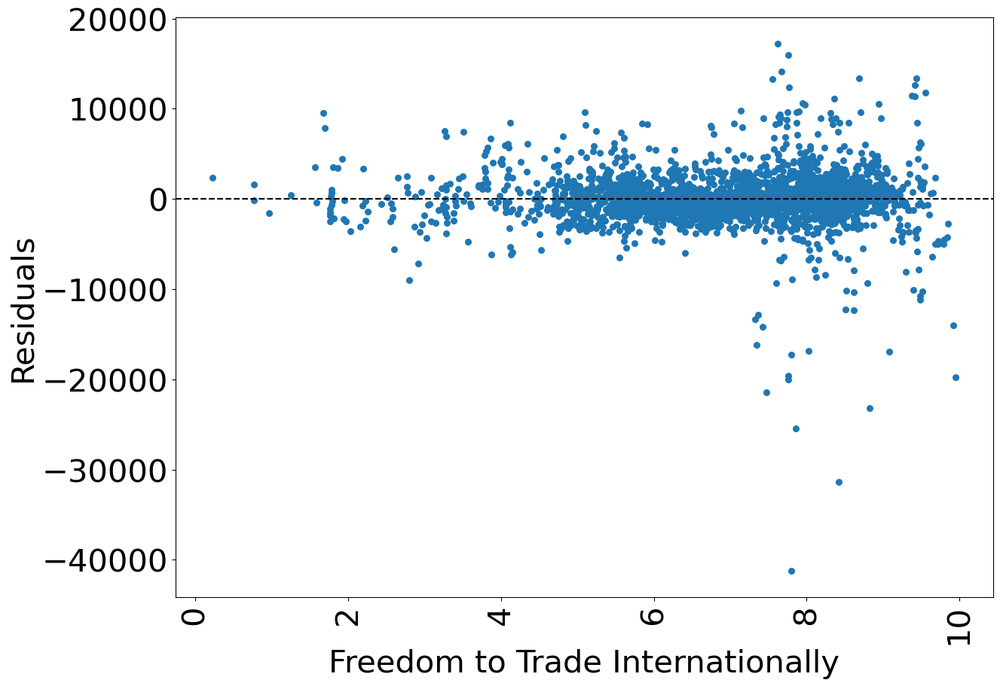

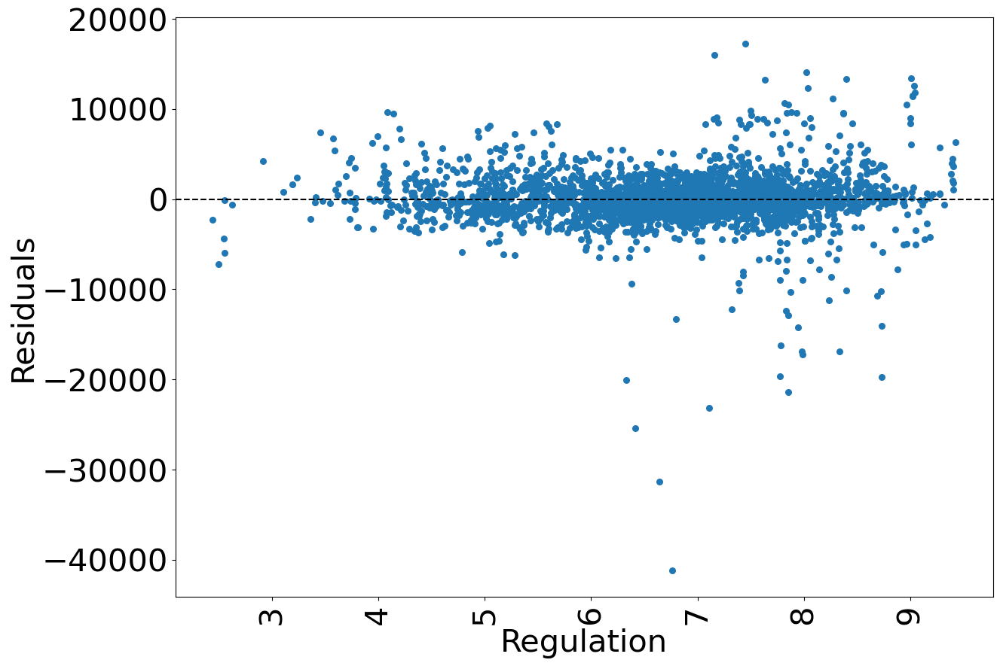

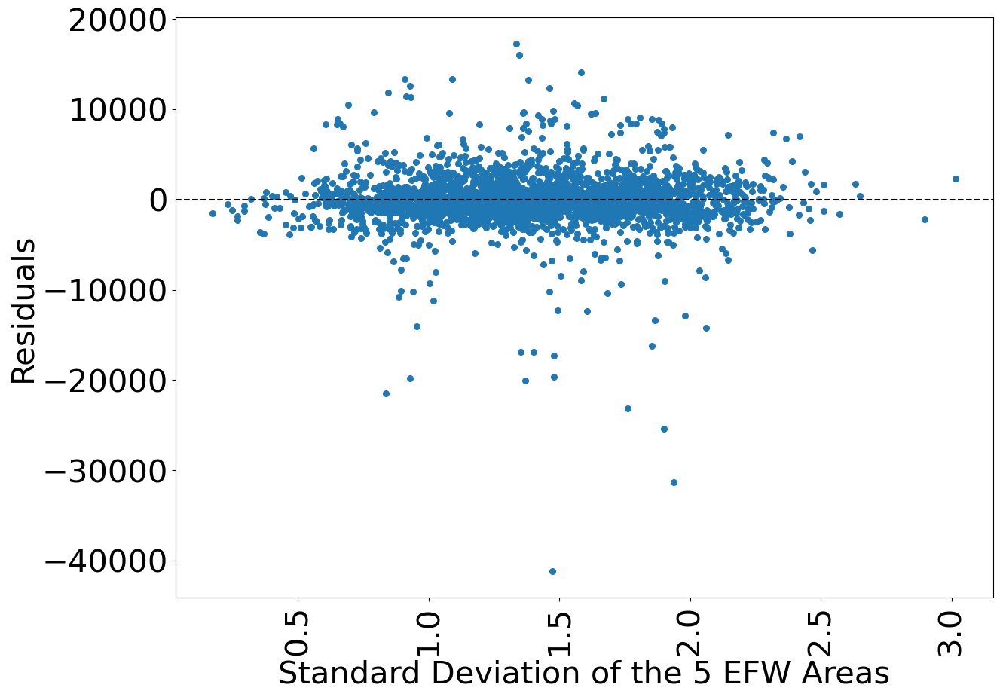

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:True
Time: False
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.1685
Estimator:                   PanelOLS   R-squared (Between):              0.2202
No. Observations:                2808   R-squared (Within):               0.1685
Date:                Tue, Apr 25 2023   R-squared (Overall):              0.2680
Time:                        10:43:03   Log-likelihood                -2.705e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      89.486
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(6,2650)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             16.039
    

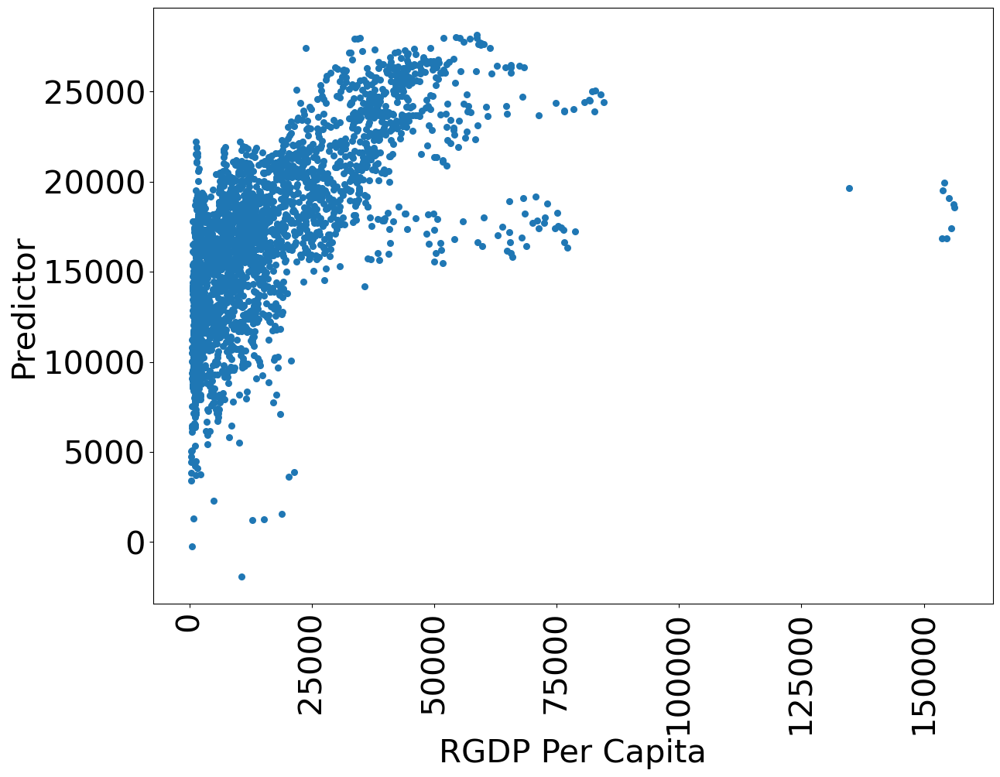

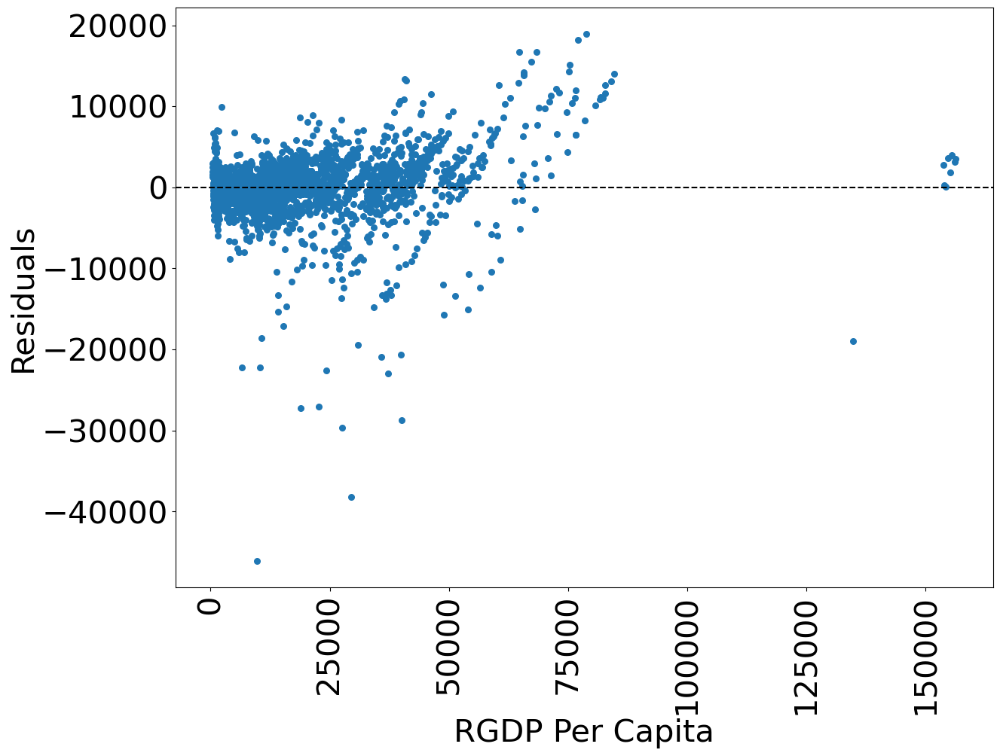

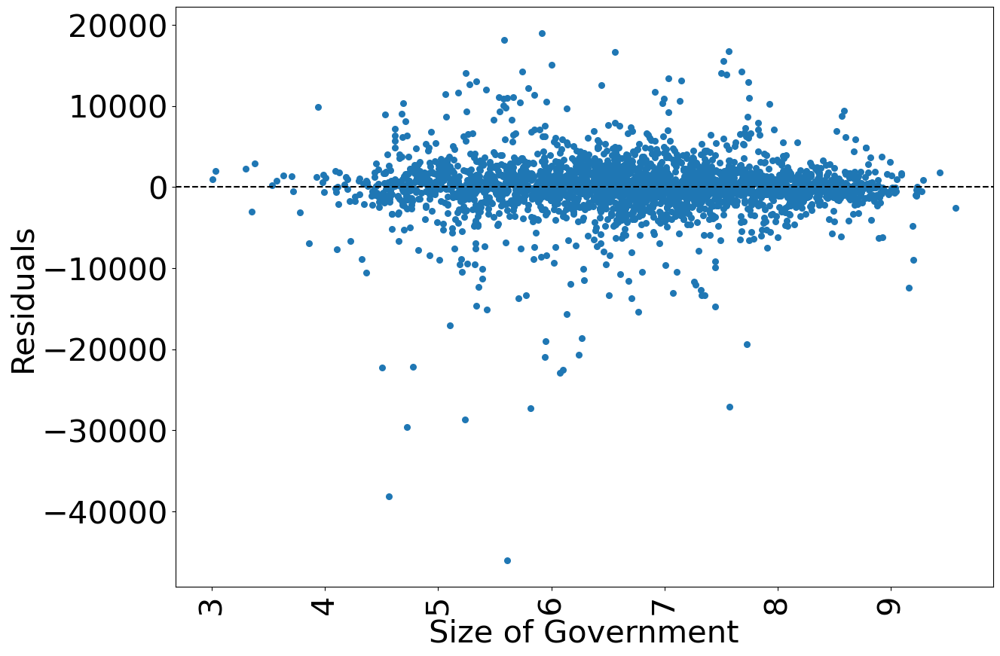

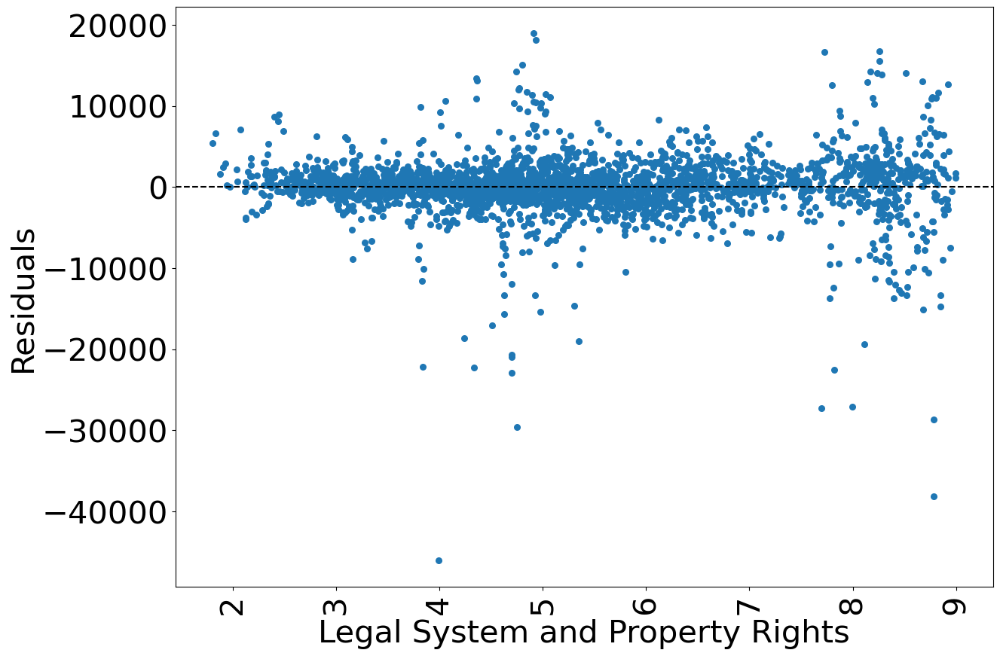

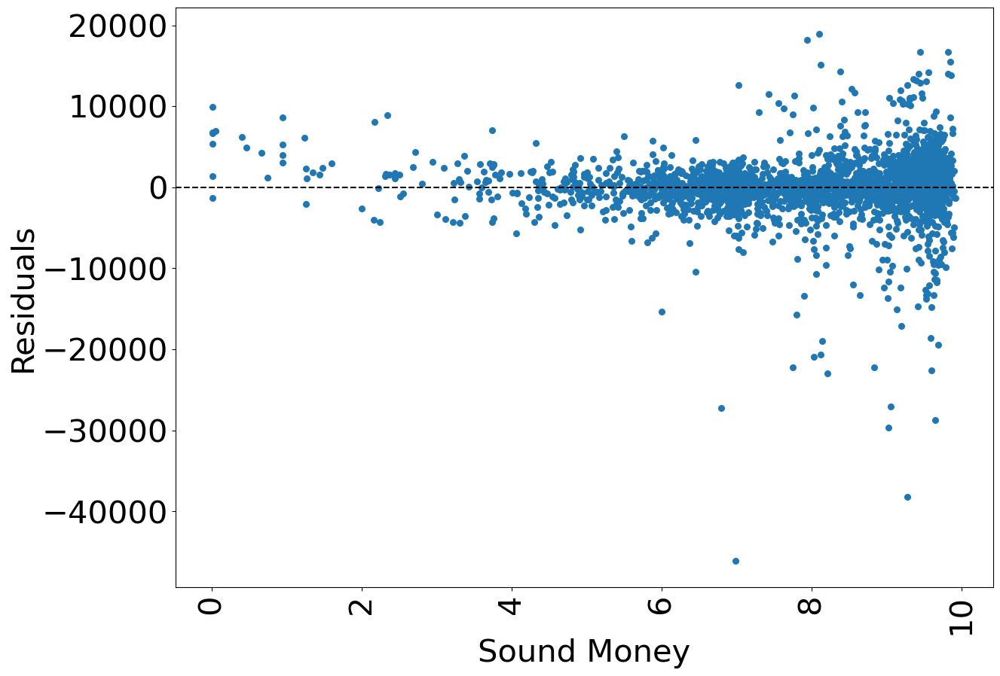

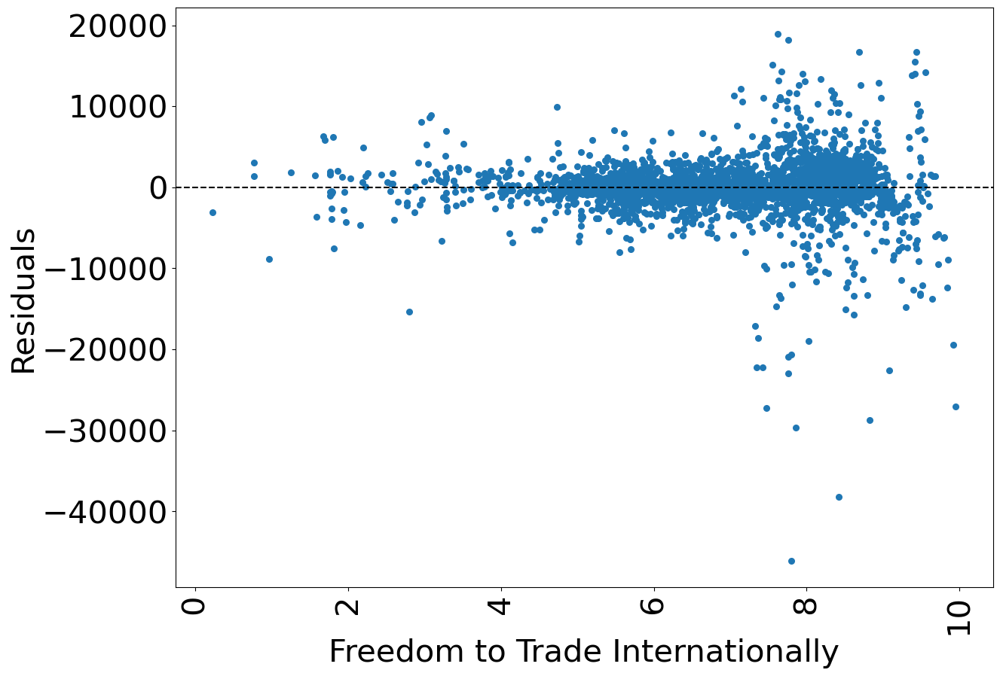

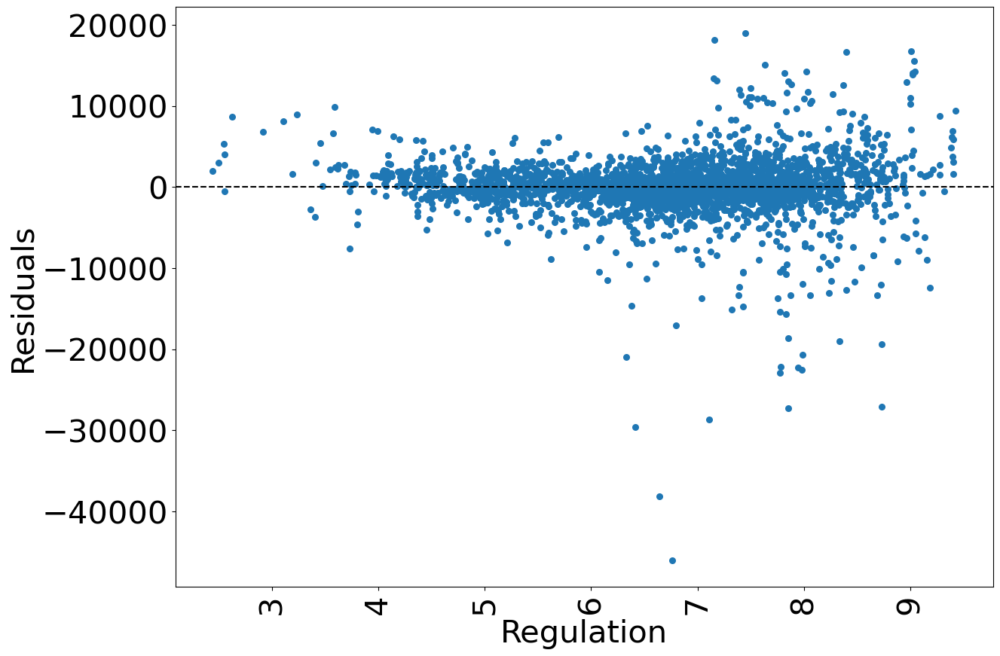

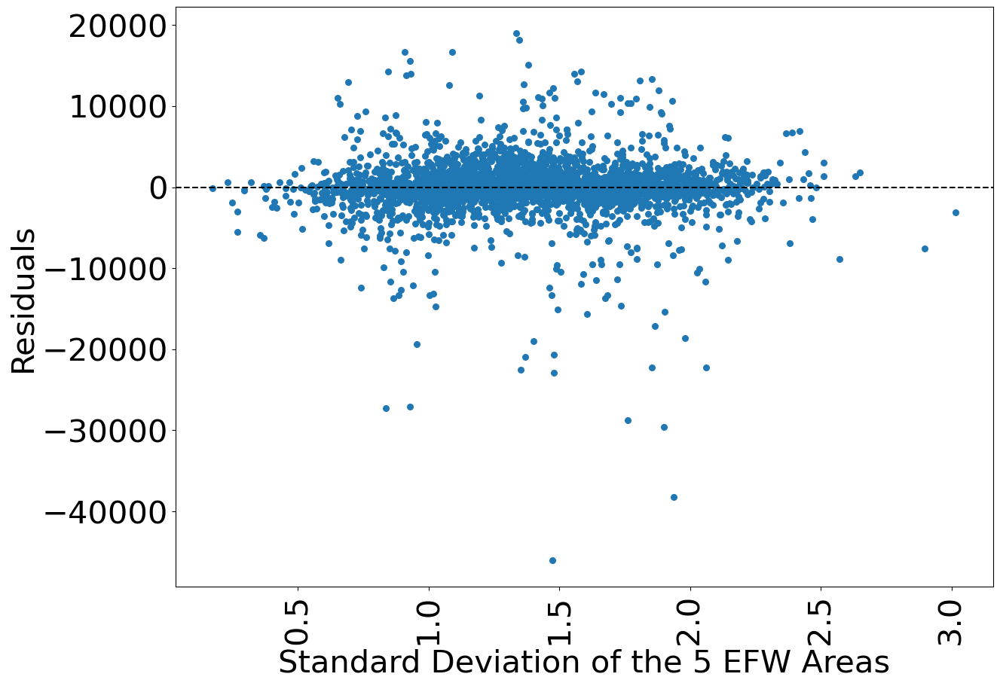

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:False
Time: True
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.5161
Estimator:                   PanelOLS   R-squared (Between):              0.4544
No. Observations:                2808   R-squared (Within):              -0.1797
Date:                Tue, Apr 25 2023   R-squared (Overall):              0.5131
Time:                        10:43:05   Log-likelihood                -3.043e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      494.30
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(6,2781)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             53.476
    

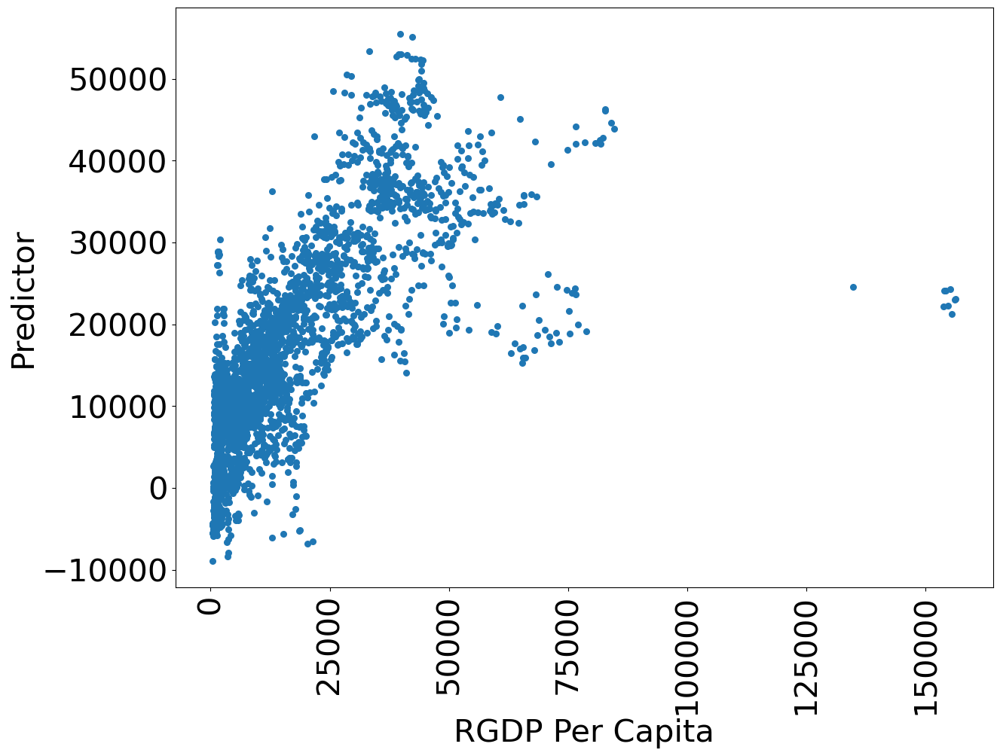

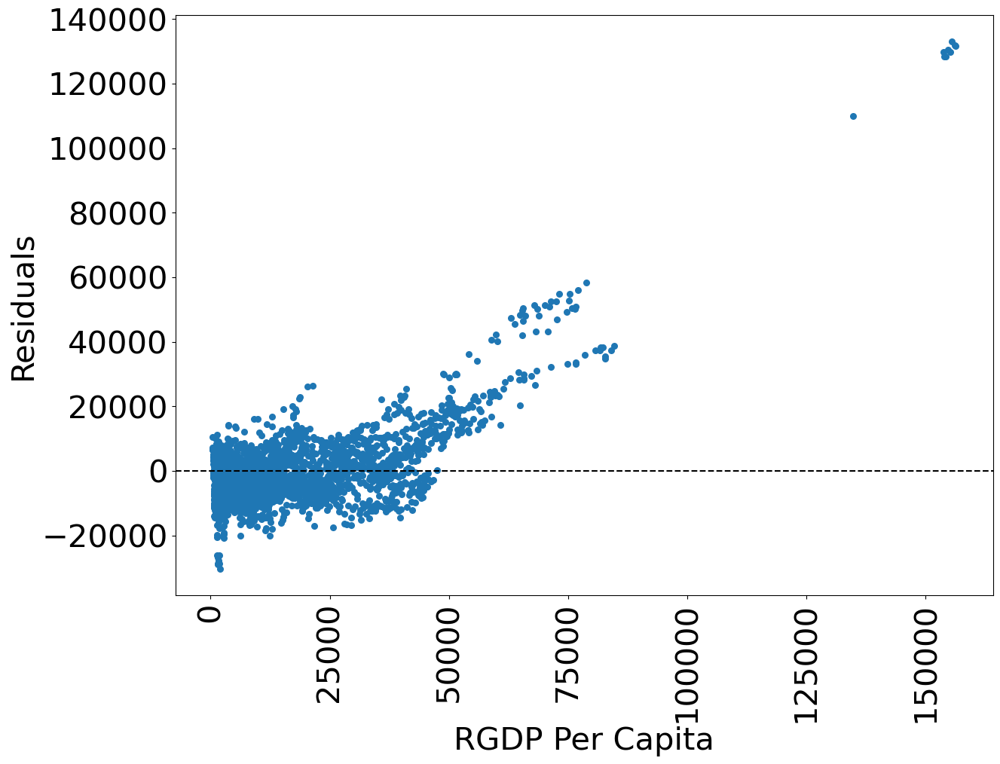

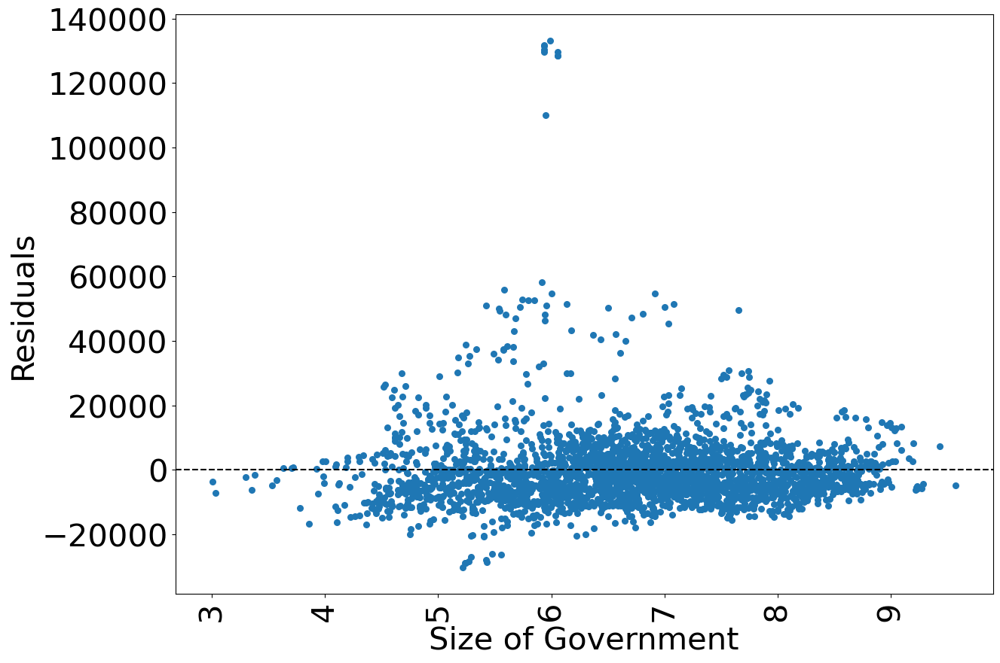

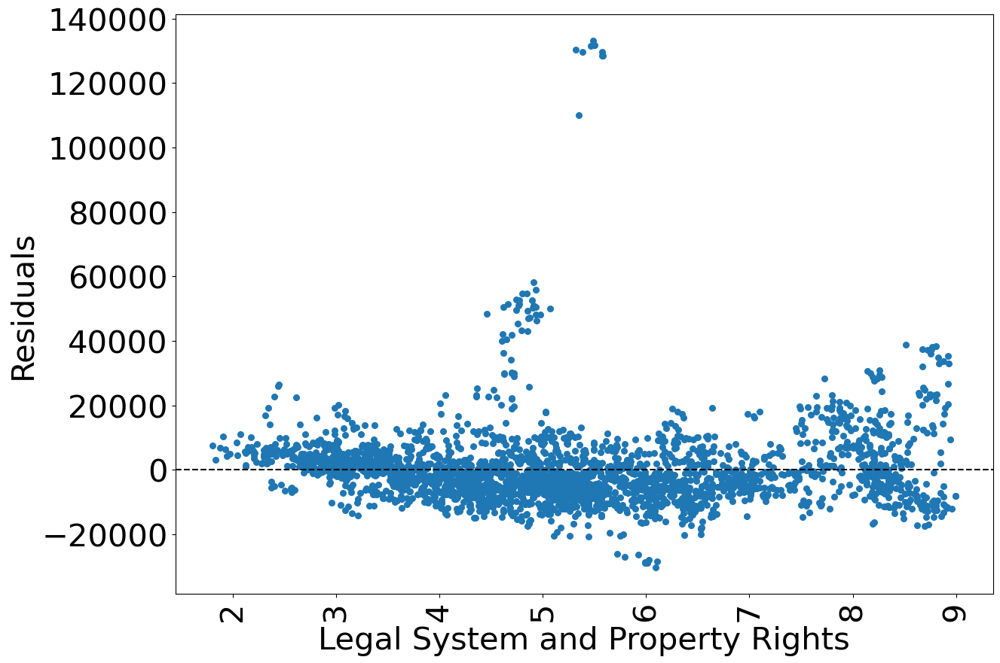

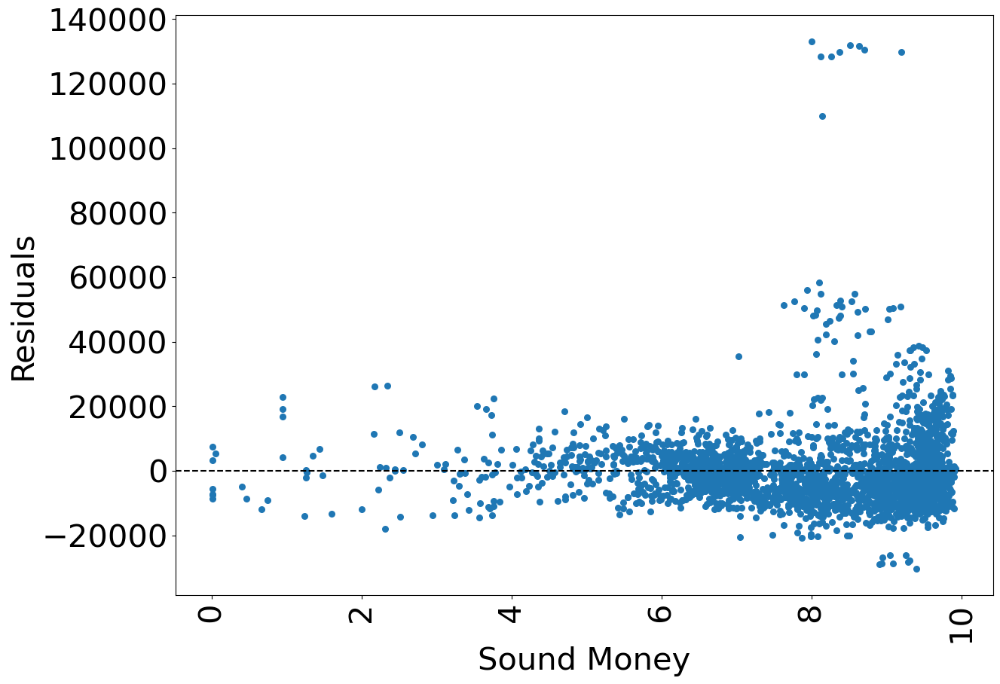

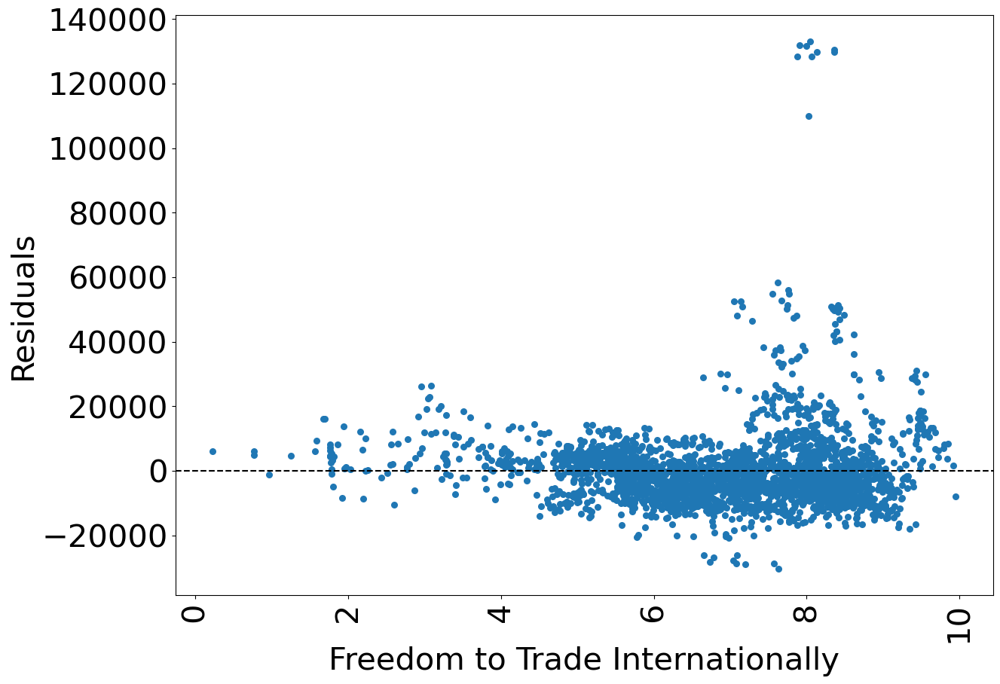

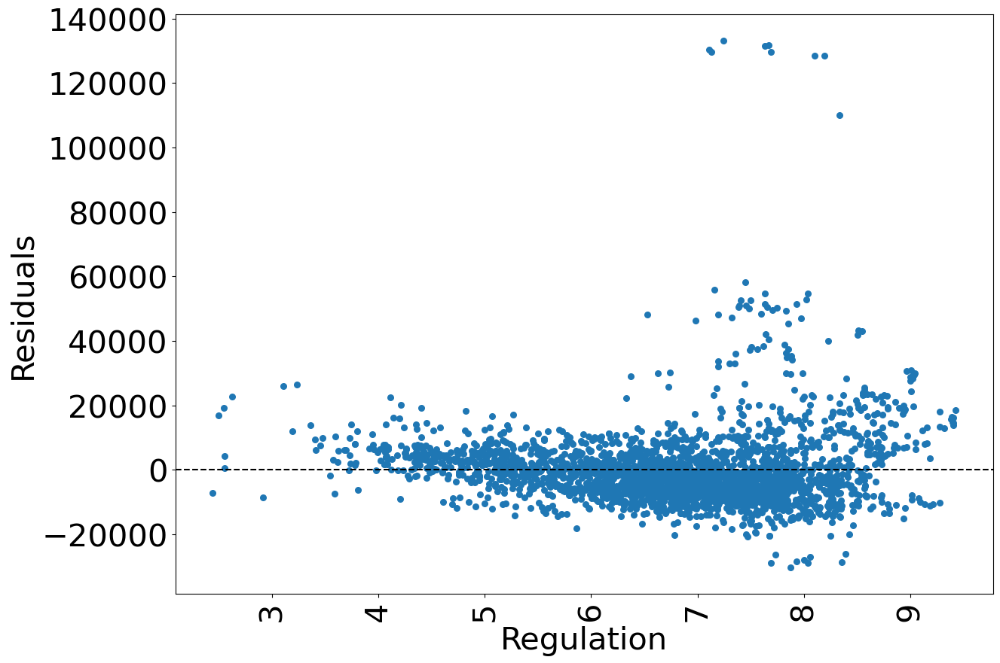

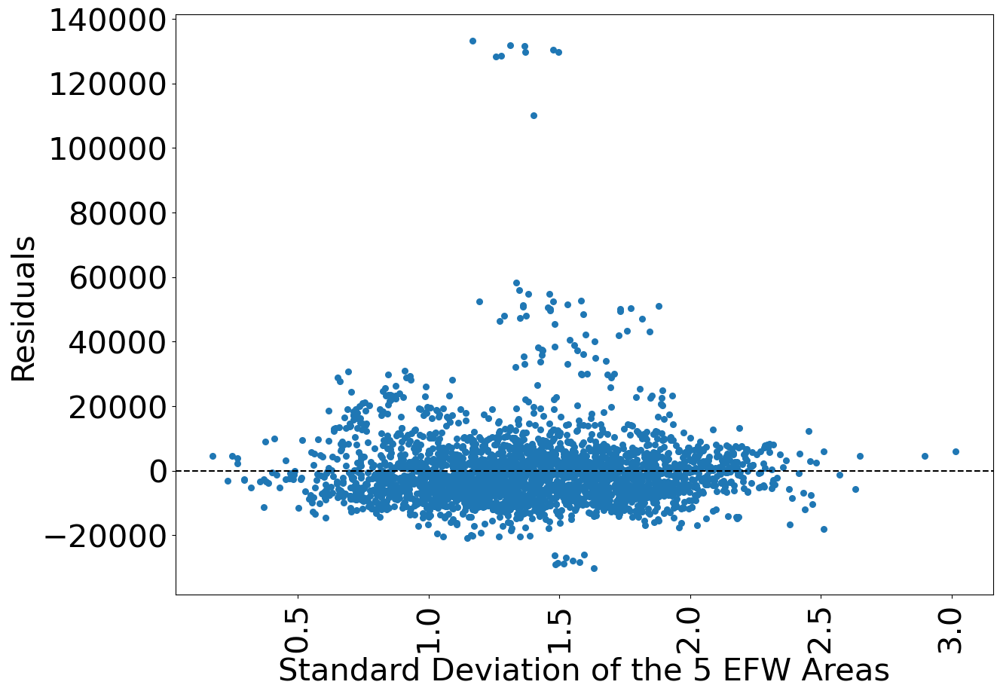

C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\2406720927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["constant"] = 1
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reg_data["Predictor"] = results.predict()
C:\Users\Bryce Grabanski\AppData\Local\Temp\ipykernel_7772\3938165077.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

Entity:False
Time: False
                          PanelOLS Estimation Summary                           
Dep. Variable:        RGDP Per Capita   R-squared:                        0.5146
Estimator:                   PanelOLS   R-squared (Between):              0.4537
No. Observations:                2808   R-squared (Within):              -0.1394
Date:                Tue, Apr 25 2023   R-squared (Overall):              0.5146
Time:                        10:43:07   Log-likelihood                -3.045e+04
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      494.97
Entities:                         165   P-value                           0.0000
Avg Obs:                       17.018   Distribution:                  F(6,2801)
Min Obs:                       0.0000                                           
Max Obs:                       21.000   F-statistic (robust):             53.200
   

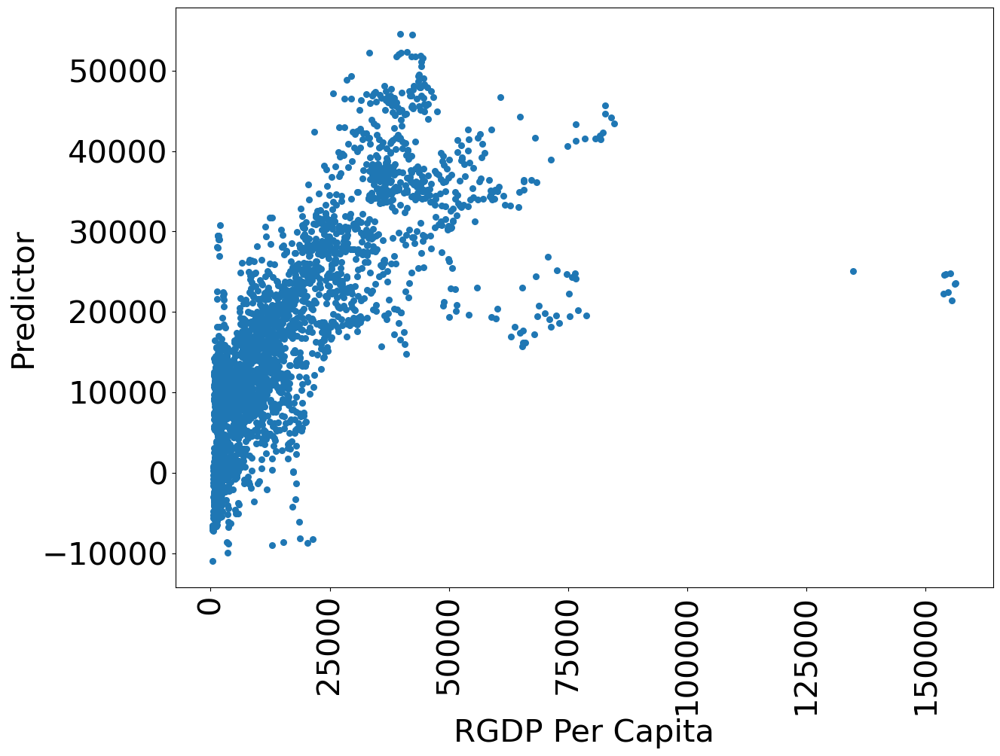

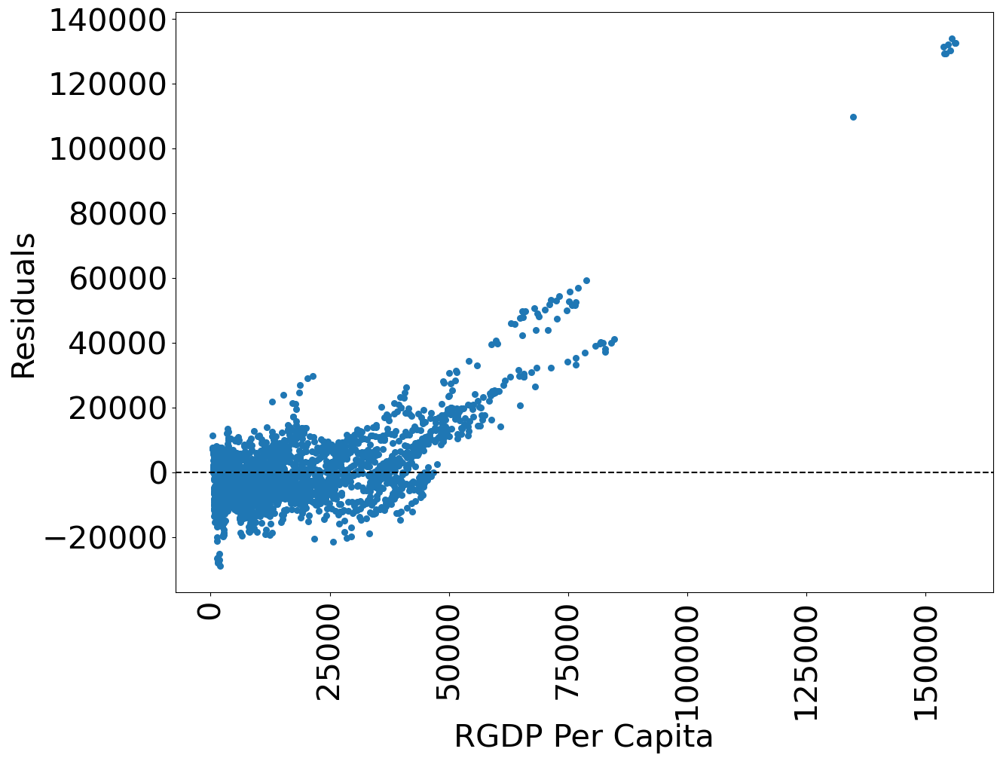

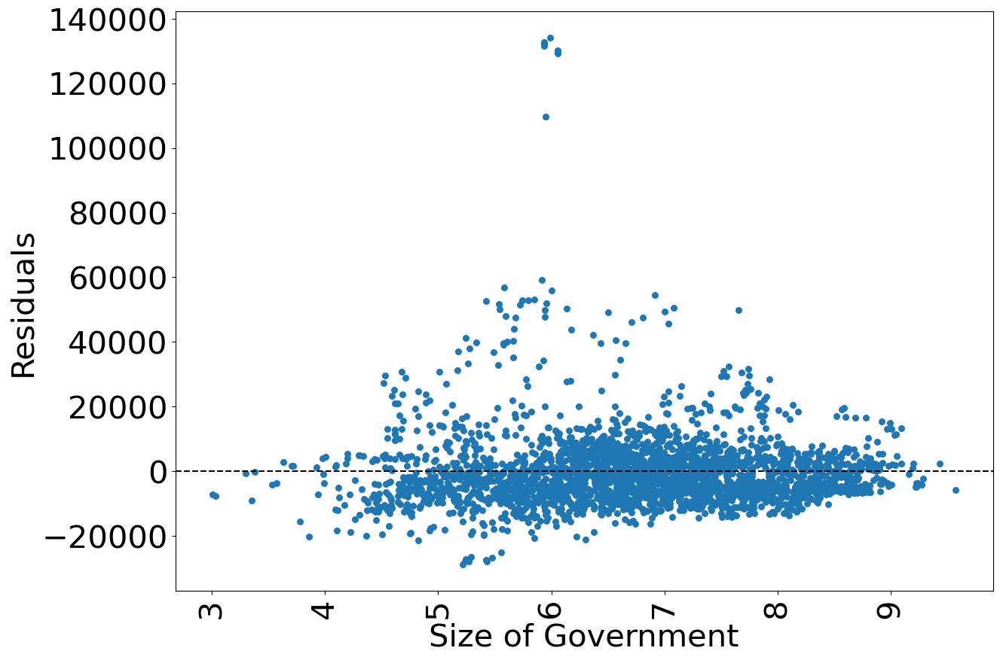

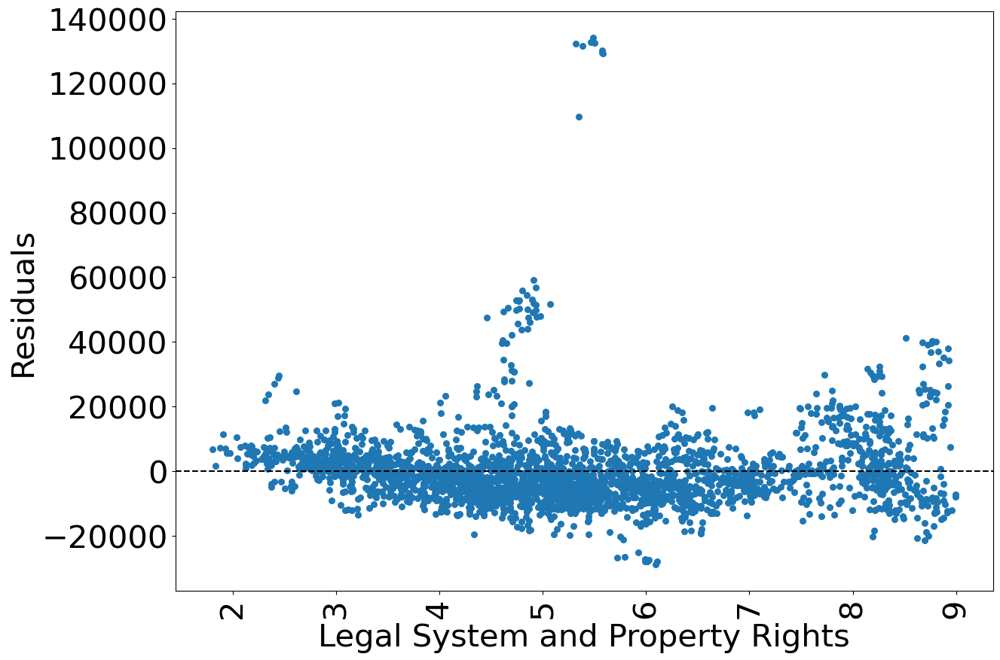

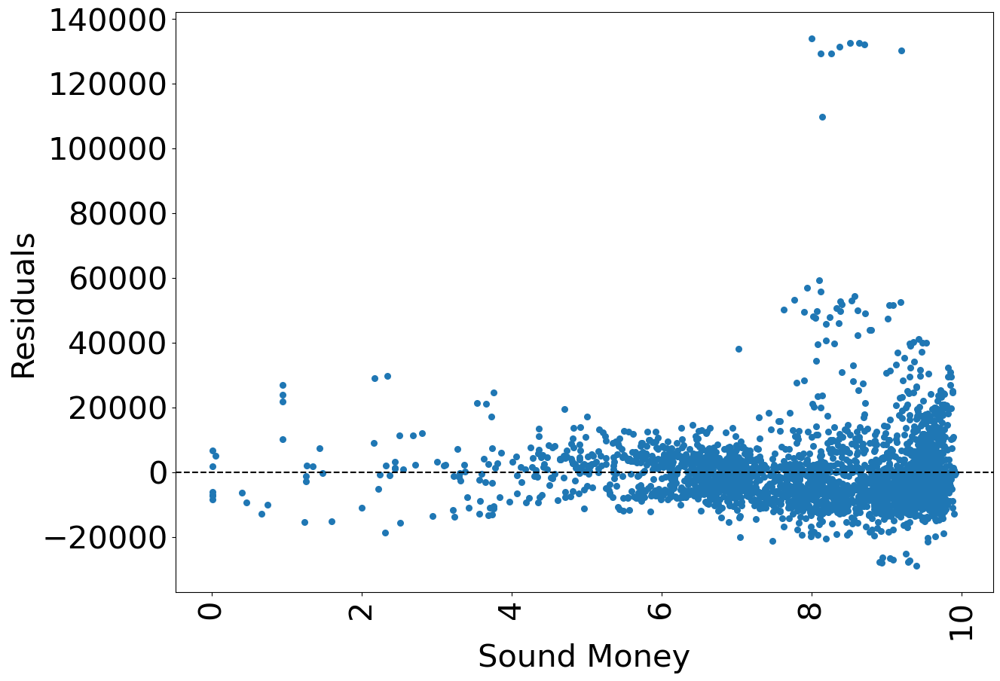

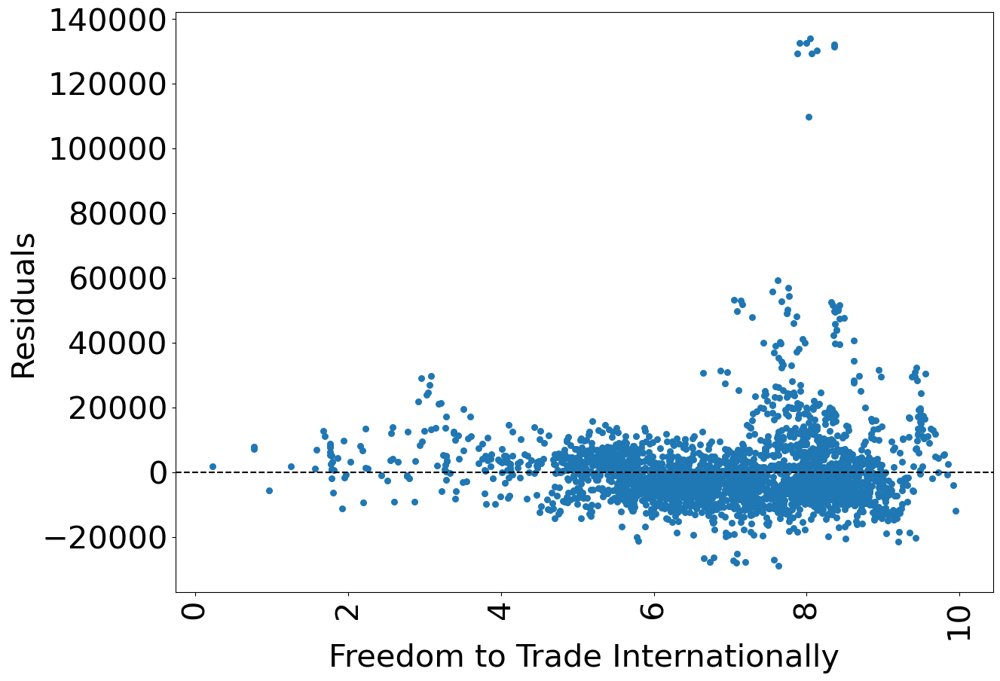

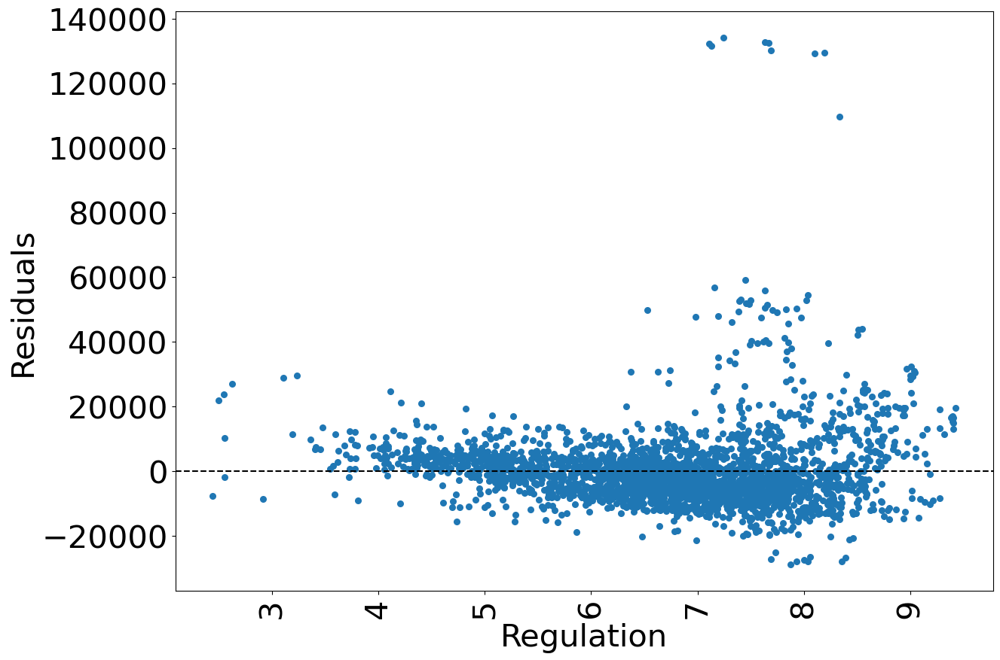

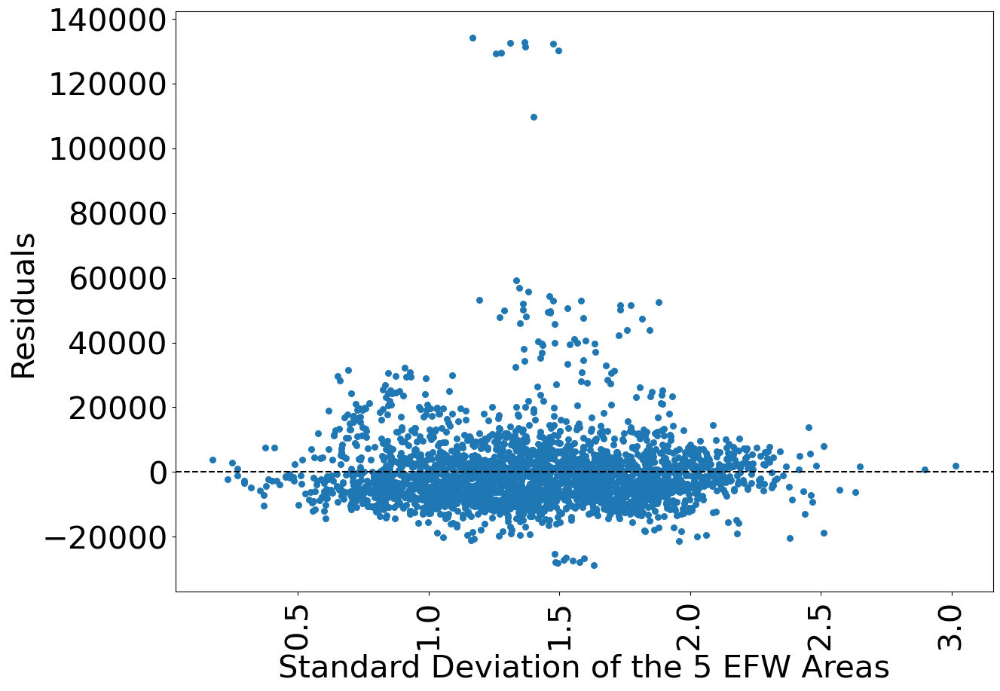

In [44]:
# build a for loop that allows us to run through other data keys with the same regression format.

X_names = list(data.keys())[5:11]
y_name = ["RGDP Per Capita"]
for entity in [True, False]:
    for time in [True, False]:        
        reg_data = data.dropna()
        results = panel_regress(reg_data, X_names,
                     y_name,
                      constant = True,
                     entity = entity,
                     time = time)
        print("Entity:" + str(entity) + "\nTime: " + str(time))
        print(results)
        reg_data["Predictor"] = results.predict()
        reg_data["Residuals"] = results.resids
        plot_residuals(reg_data, y_name, X_names)
 

In [40]:
data.keys()

Index(['ISO_Code_2', 'World Bank Region',
       'World Bank Current Income Classification, 1990-present (L=Low income, LM=Lower middle income, UM=Upper middle income, H=High income)',
       'Countries', 'EFW', 'Size of Government',
       'Legal System and Property Rights', 'Sound Money',
       'Freedom to Trade Internationally', 'Regulation',
       'Standard Deviation of the 5 EFW Areas', 'RGDP Per Capita',
       'North America', 'RGDP Per Capita 5-tile'],
      dtype='object')